In [1]:
!hostname

gnode014.cluster


In [2]:
!nvidia-smi

Sat Feb  3 10:57:43 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 545.23.08              Driver Version: 545.23.08    CUDA Version: 12.3     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA H100 PCIe               Off | 00000000:A8:00.0 Off |                    0 |
| N/A   28C    P0              48W / 350W |      4MiB / 81559MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [3]:
import itertools as it
import pickle
import torch
import torch.nn as nn
import torch.optim as optim
import torch.fft
import torch.nn.functional as F
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sdeint
from toolbox import (
    make_loss,
    StatLoss,
    SINN,
    FPU
)
import time

In [4]:
torch.cuda.is_available()

True

In [5]:
device = torch.device('cuda')

In [6]:
print(torch.__version__)
print(torch.version.cuda)

2.0.1+cu118
11.8


In [7]:
seed = 1234
torch.set_default_dtype(torch.float)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
np.random.seed(seed)

200.0
(1000, 400) (1000, 400)
(400, 400) (400, 400) (400, 400)
(400, 400, 2)
CPU times: user 1.88 s, sys: 5.73 ms, total: 1.88 s
Wall time: 1.9 s


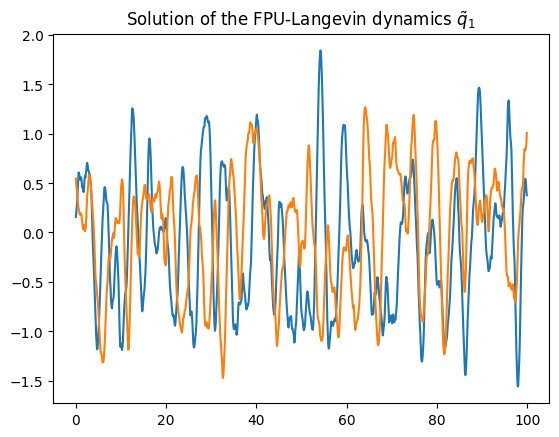

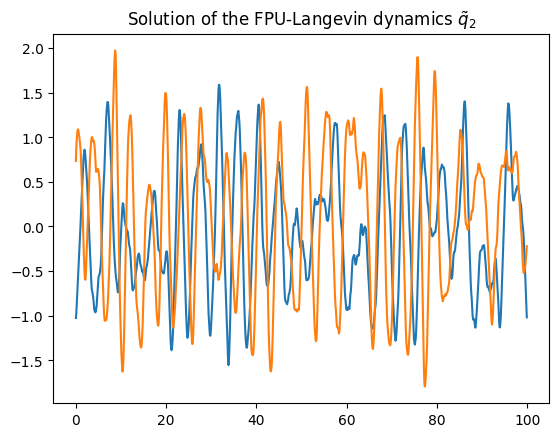

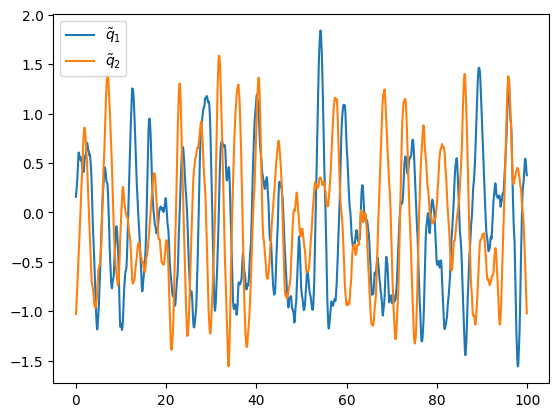

In [8]:
%%time

#### Generating SINN training data by solving SDE (Langevin dynamics)
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from scipy.integrate import quad


def V_FPU(x,U0,x0):
    v=U0/x0**4*x**3+U0/x0**2*x      # FPU potential 
    return v


#### Parameters 
gamma1 = 1                             # coupling constant 
gamma2 = .5                            # coupling constant
beta = 1                               # Inverse temperature, i.e. T=1/beta
dt = 0.01                              # Step-size of the SDE solver 
delta_t = 0.1                          # Step-size of the temporally coarse-grained path
batch = 400                           # Batch size 
sec_length = 400                       # Length of the input sequence 
U0 = 1                                 # FPU parameter, depth of the well 
x0 = 1                                 # FPU parameter, position of the basin 
rho = 0.00                             # Correlation of q1 and q2 

#### SDE solver (EM scheme) 
Time = 5*delta_t*sec_length
print(Time)
length=int(Time/dt)+1
t = np.linspace(0,Time,length) # define time axis
gap=int(delta_t/dt)
t_store=t[0:-1:gap]
q1_store = np.zeros([t_store.size+1,batch])
q2_store = np.zeros([t_store.size+1,batch])
# q_store = np.zeros([t_store.size+1,batch])
p1=np.zeros((2,batch))
p2=np.zeros((2,batch))
q1=np.zeros((2,batch))
q2=np.zeros((2,batch))

# solve SDE
j=1
for i in range(1,length):
     q1[1,:] = q1[0,:] + p1[0,:]*dt
     p1[1,:] = p1[0,:] + (-V_FPU(q1[0,:],U0,x0)-gamma1*p1[0,:])*dt + np.random.randn(1,batch)*np.sqrt(2*dt*gamma1/beta)
     q2[1,:] = q2[0,:] + p2[0,:]*dt
     p2[1,:] = p2[0,:] + (-V_FPU(q2[0,:],U0,x0)-gamma2*p2[0,:])*dt + np.random.randn(1,batch)*np.sqrt(2*dt*gamma2/beta)
     if i % gap ==0:            
            q1_store[j,:]=q1[1,:]
            q2_store[j,:]=rho*q1[1,:]+np.sqrt(1-rho**2)*q2[1,:]
            j=j+1
     p1[0,:]=p1[1,:]
     q1[0,:]=q1[1,:]
     p2[0,:]=p2[1,:]
     q2[0,:]=q2[1,:]

Toss=int(t_store.size/2)         
q1_store=q1_store[Toss:-1,:]         
q2_store=q2_store[Toss:-1,:]    
print(q1_store.shape,q2_store.shape)




plt.figure(0)
for i in range(2):
    plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,i])
plt.title(r"Solution of the FPU-Langevin dynamics $\tilde{q}_1$")
# plt.savefig("figs/FPU_dt016.pdf", dpi=150)

plt.figure(1)
for i in range(2):
    plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,i])
plt.title(r"Solution of the FPU-Langevin dynamics $\tilde{q}_2$")

plt.figure(2)
plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,0], label=r'$\tilde{q}_1$')
plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,0], label=r'$\tilde{q}_2$')
# plt.title("Solution of the FPU-Langevin dynamics")
plt.legend()
# Construct the sample traj for SINN learning 
ini=np.random.randn(sec_length,batch)
Traj_q1=q1_store[0:sec_length,:]
Traj_q2=q2_store[0:sec_length,:]
print(ini.shape, Traj_q1.shape, Traj_q2.shape)

Traj = np.empty((sec_length,batch,2))
Traj[:,:,0] = Traj_q1
Traj[:,:,1] = Traj_q2
T=np.arange(len(Traj_q1[:,1]))*delta_t
x=np.linspace(-5,5,sec_length)
print(Traj.shape)

# 2 input

In [9]:
# Reformulating data into Torch tensors 
# Input of SINN should be of the form (seq_len, batch, input_size)

ini = np.random.randn(2*sec_length,2*batch).astype(np.float32) 
input = torch.from_numpy(ini.reshape(2*sec_length, batch, 2)).to(device)
batch_validation = batch
val_set = torch.normal(0.0, 1.0, (2*sec_length, batch_validation, 2), device=device)


Traj = Traj.astype(np.float32) 
target = torch.from_numpy(Traj.reshape(sec_length, batch, 2)).to(device)
print('The torch input size is', input.size(), input.dtype)
print('The torch validation size is', val_set.size(), val_set.dtype)
print('The torch target size is', target.size(), target.dtype)

The torch input size is torch.Size([800, 400, 2]) torch.float32
The torch validation size is torch.Size([800, 400, 2]) torch.float32
The torch target size is torch.Size([400, 400, 2]) torch.float32


(array([-3., -2., -1.,  0.,  1.,  2.,  3.]),
 [Text(0, -3.0, '−3'),
  Text(0, -2.0, '−2'),
  Text(0, -1.0, '−1'),
  Text(0, 0.0, '0'),
  Text(0, 1.0, '1'),
  Text(0, 2.0, '2'),
  Text(0, 3.0, '3')])

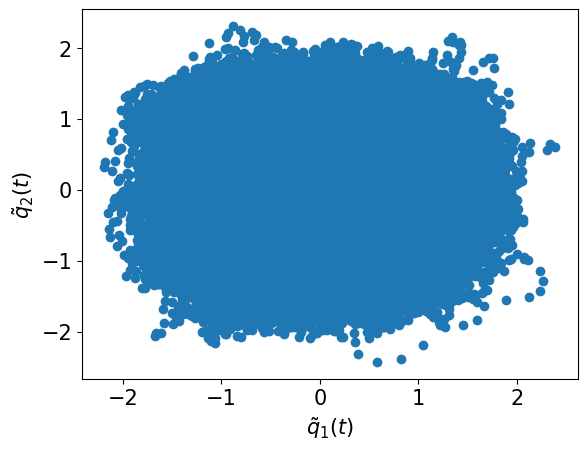

In [10]:
plt.scatter(Traj[:,:,0], Traj[:,:,1])
plt.xlabel(r'$\tilde{q}_1(t)$',fontsize=15)
plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

In [11]:
# Defining Loss functions
LAGS = 400
N = 400
loss_acf_fft = make_loss('acf[fft]', target, lags=LAGS, device=device)
loss_acf_sec_moment = make_loss('acf[fft]', target**2, lags=LAGS, device=device)
loss_acf_bruteforce = make_loss('acf[bruteforce]', target, lags=LAGS, device=device)
loss_acf_randbrute = make_loss('acf[randombrute]', target, lags=LAGS, sample_lags=20, device=device)

loss_ccf_fft = make_loss('ccf[fft]', target, lags=LAGS, device=device)
loss_ccf_sec_moment = make_loss('ccf[fft]', target**2, lags=LAGS, device=device)
loss_ccf_bruteforce = make_loss('ccf[bruteforce]', target, lags=LAGS, device=device)
loss_ccf_randbrute = make_loss('ccf[randombrute]', target, lags=LAGS, sample_lags=20, device=device)

loss_pdf_empirical1 = make_loss('pdf', target, lower=-5, upper=5, n=N, bw=None, device=device)
loss_pdf_empirical2 = make_loss('pdf6', target, lower=-5, upper=5, n=N, bw=None, device=device)
loss_pdf_empirical2D = make_loss('pdf2D', target, lower=-5, upper=5, n=N, bw=None, device=device)

torch.Size([400, 2])


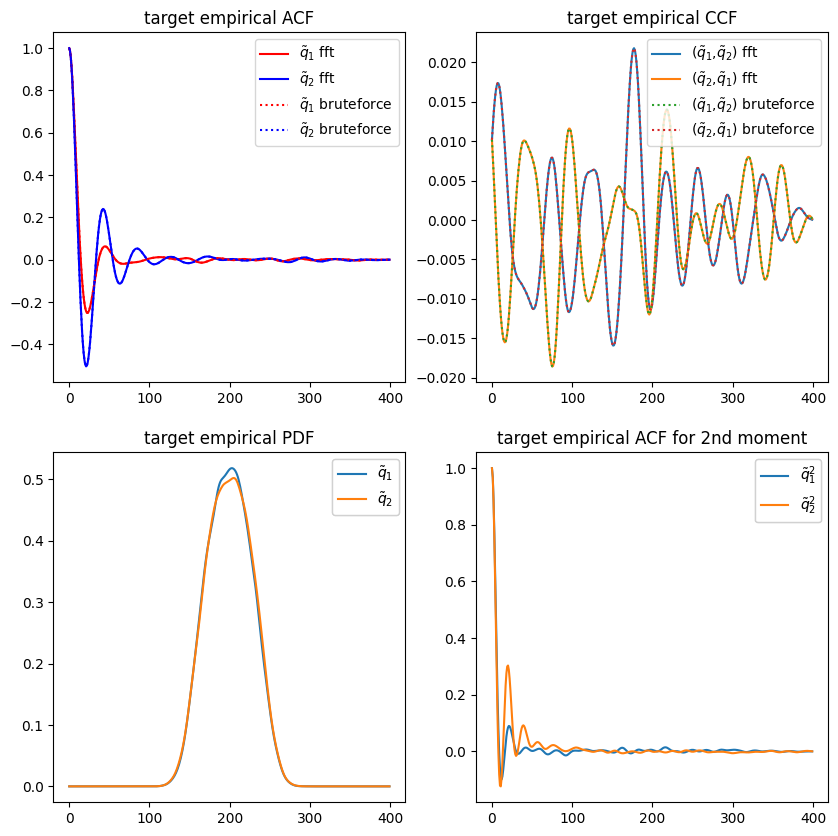

In [12]:
# Plotting target ACFs and PDF
fig, axs = plt.subplots(2, 2, figsize=(10, 10))
axs[0,0].plot(loss_acf_fft._target.cpu()[...,0],'r', label=r'$\tilde{q}_1$ fft')
axs[0,0].plot(loss_acf_fft._target.cpu()[...,-1],'b', label=r'$\tilde{q}_2$ fft')
axs[0,0].plot(loss_acf_bruteforce._target.cpu()[...,0],'r:', label= r'$\tilde{q}_1$ bruteforce')
axs[0,0].plot(loss_acf_bruteforce._target.cpu()[...,1], 'b:', label=r'$\tilde{q}_2$ bruteforce')
axs[0,0].legend()
axs[0,0].set_title('target empirical ACF')

axs[0,1].plot(loss_ccf_fft._target.cpu()[...,0], label=r'($\tilde{q}_1$,$\tilde{q}_2$) fft')
axs[0,1].plot(loss_ccf_fft._target.cpu()[...,1], label=r'($\tilde{q}_2$,$\tilde{q}_1$) fft')
axs[0,1].plot(loss_ccf_bruteforce._target.cpu()[...,0],':',label=r'($\tilde{q}_1$,$\tilde{q}_2$) bruteforce')
axs[0,1].plot(loss_ccf_bruteforce._target.cpu()[...,1],':',label=r'($\tilde{q}_2$,$\tilde{q}_1$) bruteforce')
# legend2 = axs[0,1].legend(iter(bf), ('q bf', 'p bf'), loc=1)
# axs[0,1].add_artist(legend2)
axs[0,1].legend()
axs[0,1].set_title('target empirical CCF')

x_grid=-np.linspace(-5,5,num=sec_length)
pdf = axs[1,0].plot(loss_pdf_empirical1._target.cpu())
legend3 = axs[1,0].legend(iter(pdf), (r'$\tilde{q}_1$', r'$\tilde{q}_2$'), loc=1)
axs[1,0].add_artist(legend3)
axs[1,0].set_title('target empirical PDF')


print(loss_acf_sec_moment._target.cpu().size())
sec_moment = axs[1,1].plot(loss_acf_sec_moment._target.cpu())
legend4 = axs[1,1].legend(iter(sec_moment), (r'$\tilde{q}_1^2$', r'$\tilde{q}_2^2$'),loc=1)
axs[1,1].set_title('target empirical ACF for 2nd moment')
axs[1,1].add_artist(legend4)

plt.show()

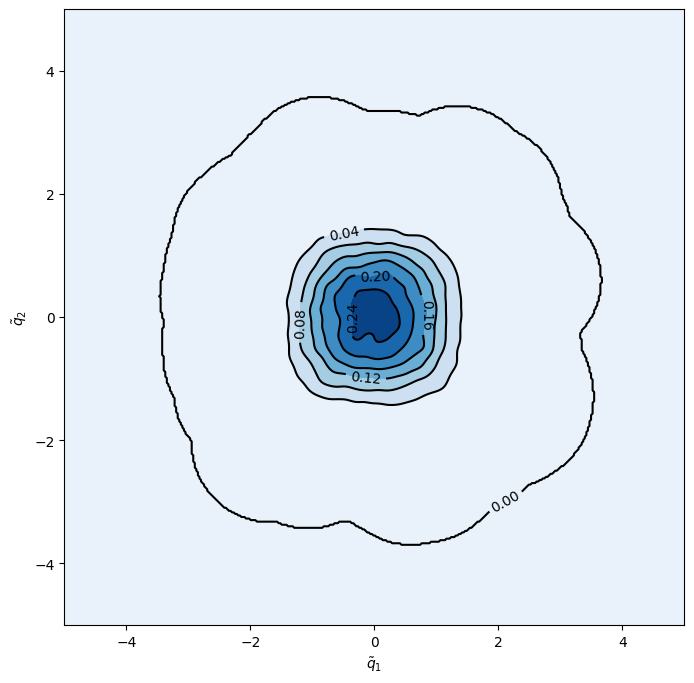

In [13]:
xmin, xmax = -5, 5
ymin, ymax = -5, 5

xx, yy = np.mgrid[xmin:xmax:400j, ymin:ymax:400j]
fig = plt.figure(figsize=(8, 8))
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

# Contourf plot
cfset = ax.contourf(xx, yy, loss_pdf_empirical2D._target.cpu(), cmap='Blues')
## Or kernel density estimate plot instead of the contourf plot

# Contour plot
cset = ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), colors='k')
# Label plot
ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel(r'$\tilde{q}_1$')
ax.set_ylabel(r'$\tilde{q}_2$')

plt.show()

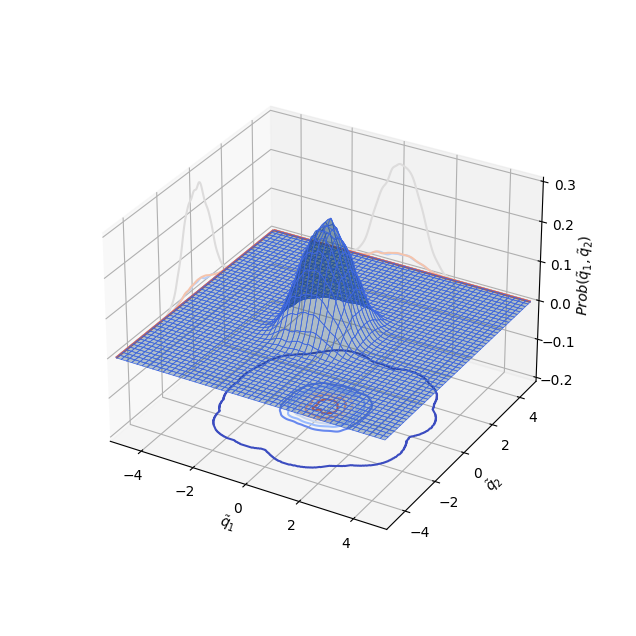

In [14]:
from mpl_toolkits.mplot3d import axes3d

ax = plt.figure(figsize=(8, 8)).add_subplot(projection='3d')
# fig = plt.figure()
# X, Y, Z = axes3d.get_test_data(0.05)

# Plot the 3D surface
ax.plot_surface(xx, yy, loss_pdf_empirical2D._target.cpu(), edgecolor='royalblue', lw=0.5, rstride=8, cstride=8,
                alpha=0.3)

# Plot projections of the contours for each dimension.  By choosing offsets
# that match the appropriate axes limits, the projected contours will sit on
# the 'walls' of the graph.
ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), zdir='z', offset=-0.2, cmap='coolwarm')
ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), zdir='x', offset=-5, cmap='coolwarm')
ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), zdir='y', offset=5, cmap='coolwarm')

ax.set(xlim=(-5, 5), ylim=(-5, 5), zlim=(-0.2, 0.3),xlabel=r'$\tilde{q}_1$', ylabel=r'$\tilde{q}_2$', zlabel=r'$Prob(\tilde{q}_1,\tilde{q}_2)$')
ax.set_box_aspect(aspect=None, zoom=0.8)
plt.show()

Text(0.5, 1.0, 'target empirical PDF')

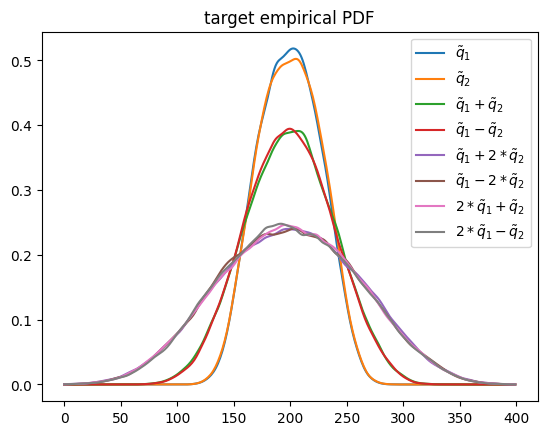

In [15]:
x_grid=-np.linspace(-5,5,num=sec_length)
plt.plot(loss_pdf_empirical1._target.cpu()[...,0],label=r'$\tilde{q}_1$')
plt.plot(loss_pdf_empirical1._target.cpu()[...,1],label=r'$\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,0],label=r'$\tilde{q}_1+\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,1],label=r'$\tilde{q}_1-\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,2],label=r'$\tilde{q}_1+2*\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,3],label=r'$\tilde{q}_1-2*\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,4],label=r'$2*\tilde{q}_1+\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,5],label=r'$2*\tilde{q}_1-\tilde{q}_2$')
plt.legend()
plt.title('target empirical PDF')

## 1.3. Loss function=CCF($\textbf{x}$)+PDF($\textbf{x}$)+ACF($\textbf{x}^2$)

In [16]:
class Model:
    def __init__(self, net):

        self.x_acf_s = None
        self.x_ccf_s = None
        self.x_pdf_s = None
        self.x_pdf2_s = None
        self.x_acf2_s = None
        self.s_collect = []

        self.net = net

        self.T_error=[]
        self.V_error=[]
        self.T_ccf=[]
        self.V_ccf=[]
        self.T_pdf=[]
        self.V_pdf=[]
        self.T_pdf2=[]
        self.V_pdf2=[]
        self.T_acf=[]
        self.V_acf=[]
        self.T_acf2=[]
        self.V_acf2=[]
        self.Step=[]
        self.iter = 0

    def train_U(self, x):
        return self.net(x)

    def predict_U(self, x):
        return self.train_U(x)

    def likelihood_loss(self, loss_acf, loss_ccf, loss_pdf, loss_pdf2, loss_acf2):
        loss = torch.reciprocal(2. * self.x_acf_s ** 2) * loss_acf.detach()      \
               + torch.reciprocal(2. * self.x_ccf_s ** 2) * loss_ccf.detach()    \
               + torch.reciprocal(2. * self.x_pdf_s ** 2) * loss_pdf.detach()    \
               + torch.reciprocal(2. * self.x_pdf2_s ** 2) * loss_pdf2.detach()  \
               + torch.reciprocal(2. * self.x_acf2_s ** 2) * loss_acf2.detach()  \
               + torch.log(self.x_acf_s * self.x_ccf_s * self.x_pdf_s * self.x_pdf2_s * self.x_acf2_s)
        return loss

    def true_loss(self, loss_acf, loss_ccf, loss_pdf, loss_pdf2, loss_acf2):
        return torch.reciprocal(2. * self.x_acf_s.detach() ** 2) * loss_acf + torch.reciprocal(2. * self.x_ccf_s.detach() ** 2) * loss_ccf + torch.reciprocal(2. * self.x_pdf_s.detach() ** 2) * loss_pdf + torch.reciprocal(2. * self.x_pdf2_s.detach() ** 2) * loss_pdf2 + torch.reciprocal(2. * self.x_acf2_s.detach() ** 2) * loss_acf2

    def run_baseline(self):
        optimizer_adam = optim.Adam(self.net.parameters(), lr=1e-3)
        for step in range(20000):
            optimizer_adam.zero_grad()
            ini = np.random.randn(2*sec_length, batch*self.net.lstm.input_size).astype(np.float32) 
            input = torch.from_numpy(ini.reshape(2*sec_length, batch, self.net.lstm.input_size)).to(device)
            prediction, _ = self.train_U(input)
            prediction = prediction[-LAGS:,:,:]
            loss = loss_acf_fft(prediction)+ loss_ccf_fft(prediction)+loss_pdf_empirical1(prediction)+loss_pdf_empirical2(prediction)+loss_acf_sec_moment(prediction**2)
            loss.backward()
            optimizer_adam.step()
            self.iter += 1
            if step % 50 == 0: 
                with torch.no_grad():
                    loss = loss_acf_fft(prediction)+loss_ccf_fft(prediction)+loss_pdf_empirical1(prediction)+loss_pdf_empirical2(prediction)+loss_acf_sec_moment(prediction**2)
                    pred_val, _ = self.predict_U(val_set)
                    pred_val = pred_val[-LAGS:,:,:]
                    loss_val = loss_acf_bruteforce(pred_val)+loss_ccf_bruteforce(pred_val)+ loss_pdf_empirical1(pred_val)+ loss_pdf_empirical2(pred_val) + loss_acf_sec_moment(pred_val**2)
                    acf = loss_acf_bruteforce(pred_val)
                    ccf = loss_ccf_bruteforce(pred_val)
                    pdf = loss_pdf_empirical1(pred_val)
                    pdf2 = loss_pdf_empirical2(pred_val)
                    acf_sec_moment = loss_acf_sec_moment(pred_val**2)
                    print('[%d]-th step loss: %.4f, %.4f, acf: %.5f, ccf: %.5f, pdf: %.5f, pdf2: %.5f, acf2: %.5f' % (step, loss, loss_val, acf, ccf, pdf, pdf2, acf_sec_moment))
                    self.T_acf.append(loss_acf_fft(prediction).detach().cpu().numpy())
                    self.V_acf.append(loss_acf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_ccf.append(loss_ccf_fft(prediction).detach().cpu().numpy())
                    self.V_ccf.append(loss_ccf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_pdf.append(loss_pdf_empirical1(prediction).detach().cpu().numpy())
                    self.V_pdf.append(loss_pdf_empirical1(pred_val).detach().cpu().numpy())
                    self.T_pdf2.append(loss_pdf_empirical2(prediction).detach().cpu().numpy())
                    self.V_pdf2.append(loss_pdf_empirical2(pred_val).detach().cpu().numpy())
                    self.T_acf2.append(loss_acf_sec_moment(prediction**2).detach().cpu().numpy())
                    self.V_acf2.append(loss_acf_sec_moment(pred_val**2).detach().cpu().numpy())
                    self.T_error.append(loss.detach().cpu().numpy())
                    self.V_error.append(loss_val.detach().cpu().numpy())
                    self.Step.append(step)
            if loss <=0.0003 and loss_val <=0.0003:
                break

        if loss > 0.0003 and loss_val > 0.0003:
            print ('Training failed')
        print('Training finished')



    def run_AW(self):
        self.x_acf_s = nn.Parameter(self.x_acf_s, requires_grad=True)
        self.x_ccf_s = nn.Parameter(self.x_ccf_s, requires_grad=True)
        self.x_pdf_s = nn.Parameter(self.x_pdf_s, requires_grad=True)
        self.x_pdf2_s = nn.Parameter(self.x_pdf2_s, requires_grad=True)
        self.x_acf2_s = nn.Parameter(self.x_acf2_s, requires_grad=True)


        optimizer_adam = optim.Adam(self.net.parameters(), lr=1e-3)
        optimizer_adam_weight = optim.Adam([self.x_acf_s] + [self.x_ccf_s] + [self.x_pdf_s] + [self.x_pdf2_s] + [self.x_acf2_s],
                                                     lr=1e-3)

        for step in range(20000):
            self.s_collect.append([self.iter, self.x_acf_s.item(), self.x_ccf_s.item(), self.x_pdf_s.item(), self.x_pdf2_s.item(), self.x_acf2_s.item()])

            optimizer_adam.zero_grad()
            ini = np.random.randn(2*sec_length, batch*self.net.lstm.input_size).astype(np.float32) 
            input = torch.from_numpy(ini.reshape(2*sec_length, batch, self.net.lstm.input_size)).to(device)
            prediction, _ = self.train_U(input)
            prediction = prediction[-LAGS:,:,:]
            loss = self.true_loss(loss_acf_fft(prediction), loss_ccf_fft(prediction),loss_pdf_empirical1(prediction),loss_pdf_empirical2(prediction),loss_acf_sec_moment(prediction**2))
            loss.backward()
            optimizer_adam.step()
            self.iter += 1
            if step % 50 == 0: 
                with torch.no_grad():
                    loss = loss_acf_fft(prediction)+loss_ccf_fft(prediction)+loss_pdf_empirical1(prediction)+loss_pdf_empirical2(prediction)+loss_acf_sec_moment(prediction**2)
                    pred_val, _ = self.predict_U(val_set)
                    pred_val = pred_val[-LAGS:,:,:]
                    loss_val = loss_acf_bruteforce(pred_val)+loss_ccf_bruteforce(pred_val)+ loss_pdf_empirical1(pred_val) + loss_pdf_empirical2(pred_val) + loss_acf_sec_moment(pred_val**2)
                    acf = loss_acf_bruteforce(pred_val)
                    ccf = loss_ccf_bruteforce(pred_val)
                    pdf = loss_pdf_empirical1(pred_val)
                    pdf2 = loss_pdf_empirical2(pred_val)
                    acf_sec_moment = loss_acf_sec_moment(pred_val**2)
                    print('[%d]-th step loss: %.4f, %.4f, acf: %.5f, ccf: %.5f, pdf: %.5f, pdf2: %.5f, acf2: %.5f' % (step, loss, loss_val, acf, ccf, pdf, pdf2, acf_sec_moment))
                    self.T_acf.append(loss_acf_fft(prediction).detach().cpu().numpy())
                    self.V_acf.append(loss_acf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_ccf.append(loss_ccf_fft(prediction).detach().cpu().numpy())
                    self.V_ccf.append(loss_ccf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_pdf.append(loss_pdf_empirical1(prediction).detach().cpu().numpy())
                    self.V_pdf.append(loss_pdf_empirical1(pred_val).detach().cpu().numpy())
                    self.T_pdf2.append(loss_pdf_empirical2(prediction).detach().cpu().numpy())
                    self.V_pdf2.append(loss_pdf_empirical2(pred_val).detach().cpu().numpy())
                    self.T_acf2.append(loss_acf_sec_moment(prediction**2).detach().cpu().numpy())
                    self.V_acf2.append(loss_acf_sec_moment(pred_val**2).detach().cpu().numpy())
                    self.T_error.append(loss.detach().cpu().numpy())
                    self.V_error.append(loss_val.detach().cpu().numpy())
                    self.Step.append(step)
            if loss <=0.0003 and loss_val <=0.0003:
                break
            optimizer_adam_weight.zero_grad()
            loss = self.likelihood_loss(loss_acf_fft(prediction), loss_ccf_fft(prediction),loss_pdf_empirical1(prediction),loss_pdf_empirical2(prediction),loss_acf_sec_moment(prediction**2))
            loss.backward()
            optimizer_adam_weight.step()
            
        if loss > 0.0003 and loss_val > 0.0003:
            print ('Training failed')
        print('Training finished')


    def train(self):
        self.x_acf_s = torch.tensor(2.).float()
        self.x_ccf_s = torch.tensor(2.).float()
        self.x_pdf_s = torch.tensor(2.).float()
        self.x_pdf2_s = torch.tensor(2.).float()
        self.x_acf2_s = torch.tensor(2.).float()
        start_time = time.time()
        if model_type == 0:
            self.run_baseline()
        elif model_type == 1:
            self.run_AW()
        elapsed = time.time() - start_time
        print('Training time: %.2f' % elapsed)
        avg_time = elapsed/self.iter
        print('Training time per iteration: %.2f' % avg_time)
        print('Number of Iterations:%d' %self.iter)

In [17]:
def draw_loss(model):
    ### Plotting the training and the generalization error
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Error plot",fontsize=15) 
    plt.yscale('log')
    plt.plot(model.Step, model.T_error,'r',label='Training error')
    plt.plot(model.Step, model.V_error,'b--',label='Validation error')
#     plt.loglog(model.Step, model.T_error,'r',label='Training error')
#     plt.loglog(model.Step, model.V_error,'b--',label='Validation error')
    plt.xlabel(r'Training times $n$',fontsize=15)
    plt.ylabel(r'$l_1+l_2$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)

In [18]:
def draw_errors(model):
    ### Plotting the training and the generalization error
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Error plot for loss functions w/o coeff",fontsize=15)
    plt.yscale('log')
    plt.plot(model.Step, model.T_error,'k',label='Training error')
    plt.plot(model.Step, model.V_error,'k--')
    plt.plot(model.Step, model.T_acf,'r',label='acf error')
    plt.plot(model.Step, model.V_acf,'r--')
    plt.plot(model.Step, model.T_ccf,'b',label='ccf error')
    plt.plot(model.Step, model.V_ccf,'b--')
    plt.plot(model.Step, model.T_pdf,'y',label='pdf error')
    plt.plot(model.Step, model.V_pdf,'y--')
    plt.plot(model.Step, model.T_pdf2,'m',label=r'$pdf_{combo}$ error')
    plt.plot(model.Step, model.V_pdf2,'m--')
    plt.plot(model.Step, model.T_acf2,'g',label=r'$acf(\tilde{q}^2)$ error')
    plt.plot(model.Step, model.V_acf2,'g--')
    
#     plt.loglog(model.Step, model.T_error,'k',label='Training error')
#     plt.loglog(model.Step, model.V_error,'k--')
#     plt.loglog(model.Step, model.T_acf,'r',label='acf error')
#     plt.loglog(model.Step, model.V_acf,'r--')
#     plt.loglog(model.Step, model.T_ccf,'b',label='ccf error')
#     plt.loglog(model.Step, model.V_ccf,'b--')
#     plt.loglog(model.Step, model.T_pdf,'y',label='pdf error')
#     plt.loglog(model.Step, model.V_pdf,'y--')
#     plt.loglog(model.Step, model.T_pdf2,'m',label='pdf2 error')
#     plt.loglog(model.Step, model.V_pdf2,'m--')
#     plt.loglog(model.Step, model.T_acf2,'g',label='acf2 error')
#     plt.loglog(model.Step, model.V_acf2,'g--')
    plt.xlabel(r'Training times $n$',fontsize=15)
    plt.ylabel(r'$l_1+l_2$',fontsize=15)
    plt.legend(frameon=False,fontsize=15, bbox_to_anchor=(1.1, 1.05))

In [19]:
def draw_adaptive_w(model):
    s_collect = np.array(model.s_collect)
    np.savetxt('s_RAM-AW.npy', s_collect)
    plt.plot(s_collect[:, 0], s_collect[:, 1], 'r-', label=r'$\epsilon_{acf}$')
    plt.plot(s_collect[:, 0], s_collect[:, 2], 'b-', label='$\epsilon_{ccf}$')
    plt.plot(s_collect[:, 0], s_collect[:, 3], 'y-', label='$\epsilon_{pdf}$')
    plt.plot(s_collect[:, 0], s_collect[:, 4], 'g-', label='$\epsilon_{acf2}$')
    plt.plot(s_collect[:, 0], s_collect[:, 5], 'c-', label='$\epsilon_{ccf2}$')
    plt.xlabel('$Iters$')
    plt.ylabel('$s$')
    plt.legend()
    plt.show()

In [20]:
def draw_epoch_w(model):
    s_collect = np.array(model.s_collect)
    np.savetxt('s_RAM-AW.npy', s_collect)
    plt.yscale('log')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 1]**2), 'r-', label=r'$\frac{1}{2\epsilon_{acf}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 2]**2), 'b-', label=r'$\frac{1}{2\epsilon_{ccf}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 3]**2), 'y-', label=r'$\frac{1}{2\epsilon_{pdf}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 4]**2), 'g-', label=r'$\frac{1}{2\epsilon_{acf2}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 5]**2), 'c-', label=r'$\frac{1}{2\epsilon_{ccf2}^2}$')
    plt.xlabel('$Iters$')
    plt.ylabel('$\omega$')
    plt.legend()
#     plt.savefig('2dpossion_S_RAM-AW.pdf')
    plt.show()

In [21]:
def test1(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    # Test 1: plot the sample path generated by SINN and the exact sample path 
    skip = 0

    fig = plt.figure(0)
    plt.title("MD trajectories",fontsize=15) 
    plt.plot(T[skip:]-T[skip], Traj[skip:, 0])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_1(t)$ and $\tilde{q}_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15) 


    fig = plt.figure(1)
    plt.title("SINN trajectories",fontsize=15)    
    plt.plot(T[skip:]-T[skip], prediction[skip:, 0])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$q_1(t)$ and $q_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

In [22]:
def test2(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    
    # Test 2: plot the CCF of the sample path generated by the SINN and the exact CCF  
    acf_p=StatLoss.acf(Pred[-sec_length:,:,:])
    acf_t=StatLoss.acf(target)
    corr_p1=acf_p.detach().cpu().numpy()
    corr_t1=acf_t.detach().cpu().numpy()
    ccf_p=StatLoss.ccf(Pred[-sec_length:,:,:])
    ccf_t=StatLoss.ccf(target)
    corr_p2=ccf_p.detach().cpu().numpy()
    corr_t2=ccf_t.detach().cpu().numpy()
    
    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_1$',fontsize=15)    
    plt.plot(T, corr_t1[...,0],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, corr_p1[...,0], 'b--',label='SINN')        # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
#     plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()
    
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_2$',fontsize=15)          
    plt.plot(T, corr_t1[...,-1],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, corr_p1[...,-1], 'b--',label='SINN')     # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
#     plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()
    
    fig = plt.figure(2)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized CCF',fontsize=15)    
    plt.plot(T, corr_t2[:,:],'r')        # correlation function of the target 
    plt.plot(T, corr_p2[:,:], 'b--')        # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
#     plt.ylim(-0.05,0.05)

In [23]:
def test3(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    
    # Test 3: plot the PDF of the sample path generated by SINN and the exact PDF  
    rho_data =  StatLoss.gauss_kde(target, -5, 5, 400, None).cpu()
    rho_input = StatLoss.gauss_kde(ran_input, -5, 5, 400, None).cpu()
    rho_prediction = StatLoss.gauss_kde(Pred[-sec_length:,:,:].detach(), -5, 5, 400,None).cpu()
    
    rho_data2 =  StatLoss.gauss_kde6(target, -5, 5, 400, None).cpu()
    rho_prediction2 = StatLoss.gauss_kde6(Pred[-sec_length:,:,:].detach(), -5, 5, 400,None).cpu()


    x=np.linspace(-5, 5, 400)
    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function",fontsize=15)    
    plt.plot(x, rho_data.numpy()[...,0],label=r'Exact PDF of $\tilde{q}_1$')    # target PDF
    plt.plot(x, rho_data.numpy()[...,1],label=r'Exact PDF of $\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction.numpy()[...,0], ':',label=r'PDF of the output $\tilde{q}_1$')  # PDF after the training 
    plt.plot(x, rho_prediction.numpy()[...,1], ':',label=r'PDF of the output $\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function of sum and diff",fontsize=15)    
    plt.plot(x, rho_data2.numpy()[...,0],label=r'Exact PDF of $\tilde{q}_1+\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_data2.numpy()[...,1],label=r'Exact PDF of $\tilde{q}_2-\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction2.numpy()[...,0], ':',label=r'PDF of the output $\tilde{q}_1+\tilde{q}_2$')  # PDF after the training 
    plt.plot(x, rho_prediction2.numpy()[...,1], ':',label=r'PDF of the output $\tilde{q}_1-\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    fig = plt.figure(2)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function of sum and diff",fontsize=15)    
    plt.plot(x, rho_data2.numpy()[...,2],label=r'Exact PDF of $\tilde{q}_1+2\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_data2.numpy()[...,3],label=r'Exact PDF of $\tilde{q}_2-2\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction2.numpy()[...,2], ':',label=r'PDF of the output $\tilde{q}_1+2\tilde{q}_2$')  # PDF after the training 
    plt.plot(x, rho_prediction2.numpy()[...,3], ':',label=r'PDF of the output $\tilde{q}_1-2\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    fig = plt.figure(3)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function of sum and diff",fontsize=15)    
    plt.plot(x, rho_data2.numpy()[...,4],label=r'Exact PDF of $2\tilde{q}_1+\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_data2.numpy()[...,5],label=r'Exact PDF of $2\tilde{q}_2-\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction2.numpy()[...,4], ':',label=r'PDF of the output $2\tilde{q}_1+\tilde{q}_2$')  # PDF after the training 
    plt.plot(x, rho_prediction2.numpy()[...,5], ':',label=r'PDF of the output $2\tilde{q}_1-\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

In [24]:
def test4(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    
    # Test 4: Comparing the higher-order ACF
    acf2=StatLoss.acf(target**2)
    pred_norm=torch.from_numpy((prediction).reshape(sec_length, batch,2))
    acf2_app=StatLoss.acf(pred_norm**2)

    
    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_1^2$',fontsize=15)    
    plt.plot(T, acf2.detach().cpu().numpy()[...,0],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, acf2_app.detach().cpu().numpy()[...,0], 'b--',label='SINN')        # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()
    
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_2^2$',fontsize=15)          
    plt.plot(T, acf2.detach().cpu().numpy()[...,1],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, acf2_app.detach().cpu().numpy()[...,1], 'b--',label='SINN')     # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()    

In [25]:
def test5(model):
    # Test 5: plot the expolation result, i.e. Prediction of the FPU-Langevin dynamics for longer time 
    [a,b,c]=input.size()
    skip=20
    scale=10
    burnin=3
    fold=800
    batch_new=50
    ran_input=torch.randn(((scale-burnin)*a,batch_new,c),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred_L, _= model.predict_U(ran_input)
    prediction_ext=Pred_L.detach().cpu().numpy().reshape((scale-burnin)*a, batch_new,2)
    ccf_p=StatLoss.ccf(Pred_L,method='bruteforce')

    LT=np.linspace(0,(scale-burnin)*a*delta_t,num=(scale-burnin)*a+1)
    LT=LT[0:-1]


    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Short-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 0],'--',label='SINN simulation')
    plt.xlim([0,80])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)



    fig = plt.figure(figsize=(16, 4))
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Long-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 0],'--',label='SINN simulation')
    plt.xlim([0,500])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)

    fig = plt.figure(2)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Short-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 1],'--',label='SINN simulation')
    plt.xlim([0,80])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)



    fig = plt.figure(figsize=(16, 4))
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Long-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 1],'--',label='SINN simulation')
    plt.xlim([0,500])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)

In [26]:
def test6(model):
    # Test 6: scatter plot of SINN
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    
    fig = plt.figure(0)
    plt.title("MD trajectories",fontsize=15) 
    plt.scatter(Traj[:,:,0], Traj[:,:,1])
    plt.xlabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15) 


    fig = plt.figure(1)
    plt.title("SINN trajectories",fontsize=15)    
    plt.scatter(prediction[:,:,0],prediction[:,:,1])
    plt.xlabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

In [27]:
def test7(model):
    # Test 5: scatter plot of SINN
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    
    rho_data =  StatLoss.gauss_kde2D(target, -5, 5, 400, None).cpu()
    rho_prediction = StatLoss.gauss_kde2D(Pred[-sec_length:,:,:].detach(), -5, 5, 400, None).cpu()
    
    fig = plt.figure(0, figsize=(5, 5))
    plt.title("PDF Contours",fontsize=15) 
    xmin, xmax = -5, 5
    ymin, ymax = -5, 5

    xx, yy = np.mgrid[xmin:xmax:400j, ymin:ymax:400j]
    axs[0]  = fig.gca()
    plt.xlim(xmin, xmax)
    plt.ylim(ymin, ymax)
    
    plt.contour(xx,yy,rho_data.numpy(),colors='r')
    plt.contour(xx,yy,rho_prediction.numpy(),colors='b',linestyles='dashed')

    plt.xlabel(r'$\tilde{q}_1$')
    plt.ylabel(r'$\tilde{q}_2$')

    
    
    fig = plt.figure(1,figsize=(5, 5))
    plt.title("MD trajectories",fontsize=15) 
    xmin, xmax = -5, 5
    ymin, ymax = -5, 5

    ax  = fig.gca()
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    cfset = ax.contourf(xx, yy, rho_data.numpy(), cmap='Blues')
    cset = ax.contour(xx, yy, rho_data.numpy(), colors='k')

    ax.clabel(cset, inline=1, fontsize=10)
    ax.set_xlabel(r'$\tilde{q}_1$')
    ax.set_ylabel(r'$\tilde{q}_2$')
    
    fig = plt.figure(2,figsize=(5, 5))
    plt.title("SINN output",fontsize=15) 
    xmin, xmax = -5, 5
    ymin, ymax = -5, 5

#     xx, yy = np.mgrid[xmin:xmax:20j, ymin:ymax:20j]
    ax  = fig.gca()
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    cfset = ax.contourf(xx, yy, rho_prediction.numpy(), cmap='Blues')
    cset = ax.contour(xx, yy, rho_prediction.numpy(), colors='k')

    ax.clabel(cset, inline=1, fontsize=10)
    ax.set_xlabel(r'$\tilde{q}_1$')
    ax.set_ylabel(r'$\tilde{q}_2$')

    
    
    fig = plt.figure(3,figsize=(5, 5))
    ax = plt.figure().add_subplot(projection='3d')
# X, Y, Z = axes3d.get_test_data(0.05)

# Plot the 3D surface
    ax.plot_surface(xx, yy, rho_data.numpy(), edgecolor='royalblue', lw=0.5, rstride=8, cstride=8,
                alpha=0.3)

# Plot projections of the contours for each dimension.  By choosing offsets
# that match the appropriate axes limits, the projected contours will sit on
# the 'walls' of the graph.
    ax.contour(xx, yy, rho_data.numpy(), zdir='z', offset=-0.2, cmap='coolwarm')
    ax.contour(xx, yy, rho_data.numpy(), zdir='x', offset=-5, cmap='coolwarm')
    ax.contour(xx, yy, rho_data.numpy(), zdir='y', offset=5, cmap='coolwarm')

    ax.set(xlim=(-5, 5), ylim=(-5, 5), zlim=(-0.2, 0.3),xlabel=r'$\tilde{q}_1$', ylabel=r'$\tilde{q}_2$', zlabel=r'Prob($\tilde{q}_1$,$\tilde{q}_2$)')
    ax.set_box_aspect(aspect=None, zoom=0.8)

    
    
    
    

    
    
    
    fig = plt.figure(4,figsize=(5, 5))
    ax = plt.figure().add_subplot(projection='3d')
# X, Y, Z = axes3d.get_test_data(0.05)

# Plot the 3D surface
    ax.plot_surface(xx, yy, rho_prediction.numpy(), edgecolor='royalblue', lw=0.5, rstride=8, cstride=8,
                alpha=0.3)

# Plot projections of the contours for each dimension.  By choosing offsets
# that match the appropriate axes limits, the projected contours will sit on
# the 'walls' of the graph.
    ax.contour(xx, yy, rho_prediction.numpy(), zdir='z', offset=-0.2, cmap='coolwarm')
    ax.contour(xx, yy, rho_prediction.numpy(), zdir='x', offset=-5, cmap='coolwarm')
    ax.contour(xx, yy, rho_prediction.numpy(), zdir='y', offset=5, cmap='coolwarm')

    ax.set(xlim=(-5, 5), ylim=(-5, 5), zlim=(-0.2, 0.3),xlabel=r'$\tilde{q}_1$', ylabel=r'$\tilde{q}_2$', zlabel=r'Prob($\tilde{q}_1$,$\tilde{q}_2$)')
    ax.set_box_aspect(aspect=None, zoom=0.8)

# loss balanced SINN

In [28]:
model_type = 1

In [29]:
### Defining SINN model
net = SINN(2, 10, 2, 2).to(device)

In [30]:
model = Model(net=net)

In [31]:
model.train()

[0]-th step loss: 0.5358, 0.5337, acf: 0.01268, ccf: 0.00143, pdf: 0.24706, pdf2: 0.26935, acf2: 0.00313
[50]-th step loss: 0.2285, 0.2212, acf: 0.00775, ccf: 0.00018, pdf: 0.14983, pdf2: 0.06173, acf2: 0.00170
[100]-th step loss: 0.0795, 0.0778, acf: 0.01153, ccf: 0.00023, pdf: 0.04346, pdf2: 0.01901, acf2: 0.00358
[150]-th step loss: 0.0304, 0.0314, acf: 0.00832, ccf: 0.00161, pdf: 0.00834, pdf2: 0.01116, acf2: 0.00192
[200]-th step loss: 0.0145, 0.0146, acf: 0.00377, ccf: 0.00272, pdf: 0.00254, pdf2: 0.00449, acf2: 0.00107
[250]-th step loss: 0.0090, 0.0089, acf: 0.00280, ccf: 0.00115, pdf: 0.00127, pdf2: 0.00253, acf2: 0.00118
[300]-th step loss: 0.0060, 0.0059, acf: 0.00170, ccf: 0.00035, pdf: 0.00071, pdf2: 0.00177, acf2: 0.00134
[350]-th step loss: 0.0044, 0.0045, acf: 0.00120, ccf: 0.00045, pdf: 0.00047, pdf2: 0.00123, acf2: 0.00112
[400]-th step loss: 0.0036, 0.0036, acf: 0.00108, ccf: 0.00039, pdf: 0.00036, pdf2: 0.00086, acf2: 0.00093
[450]-th step loss: 0.0026, 0.0026, acf:

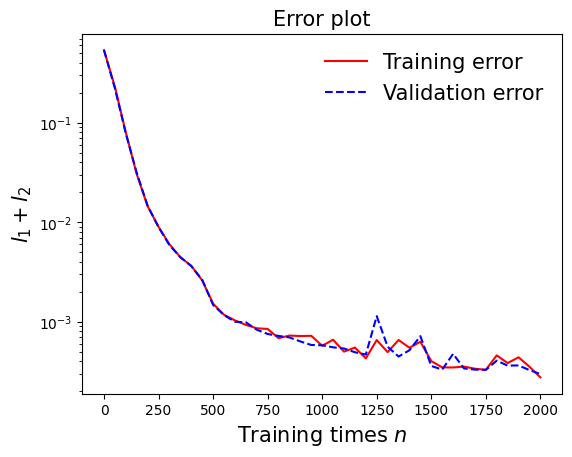

In [32]:
draw_loss(model)

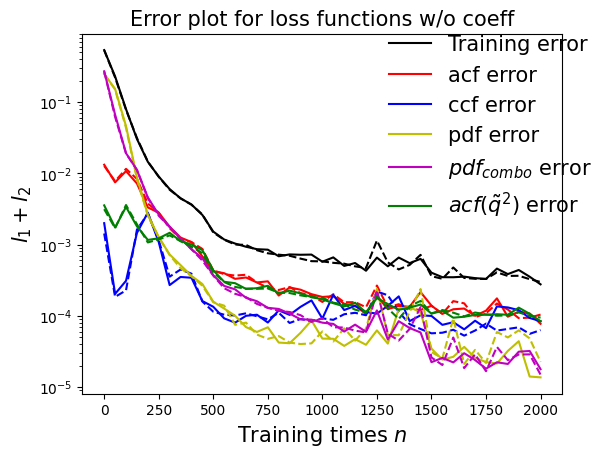

In [33]:
draw_errors(model)

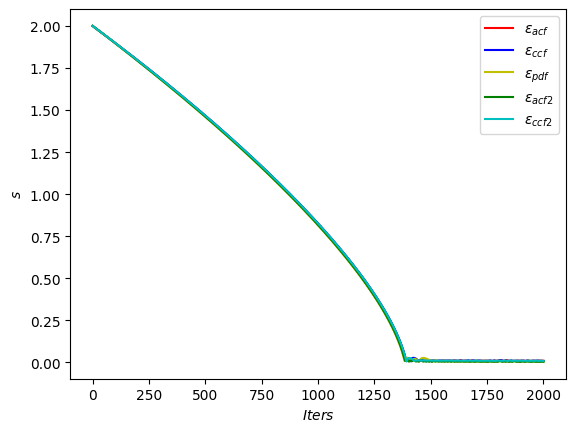

In [34]:
draw_adaptive_w(model)

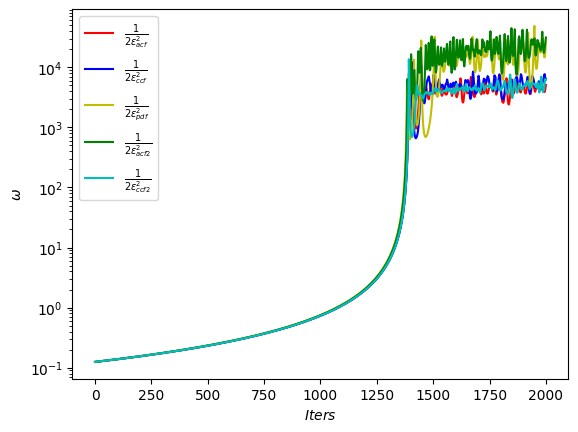

In [35]:
draw_epoch_w(model)

## Test 1: plot the sample path generated by SINN and the exact sample path 

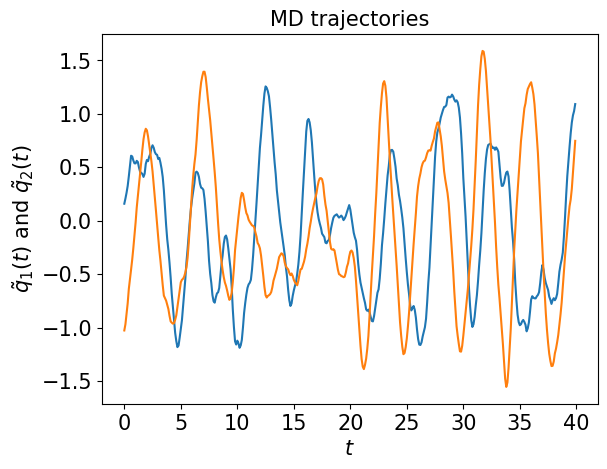

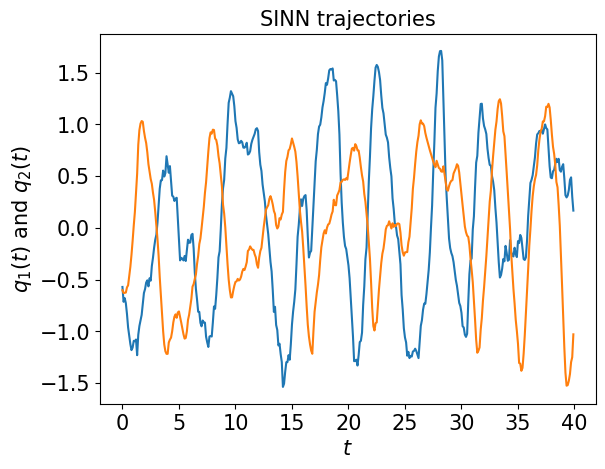

In [36]:
test1(model)

## Test 2: plot the CCF of the sample path generated by the SINN and the exact CCF

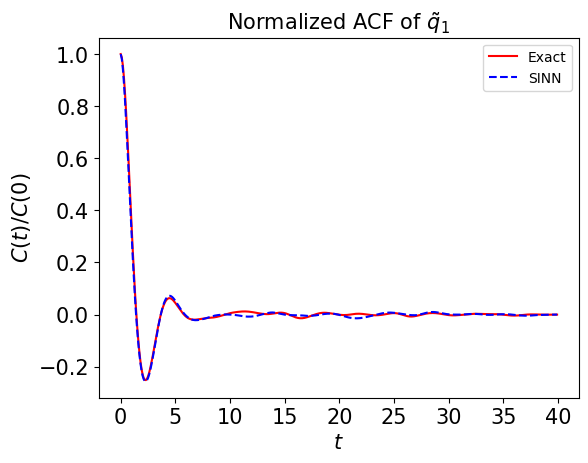

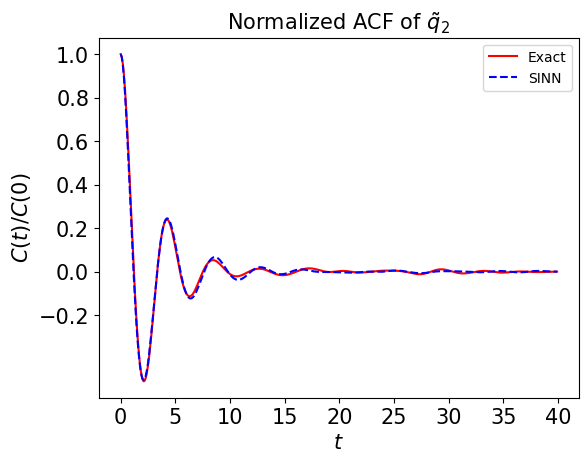

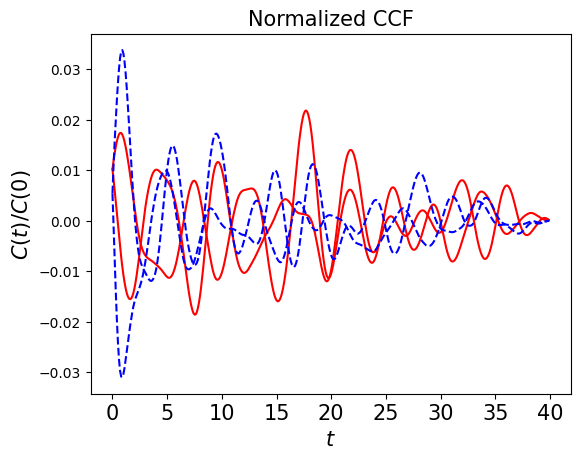

In [37]:
test2(model)

## Test 3: plot the PDF of the sample path generated by SINN and the exact PDF  

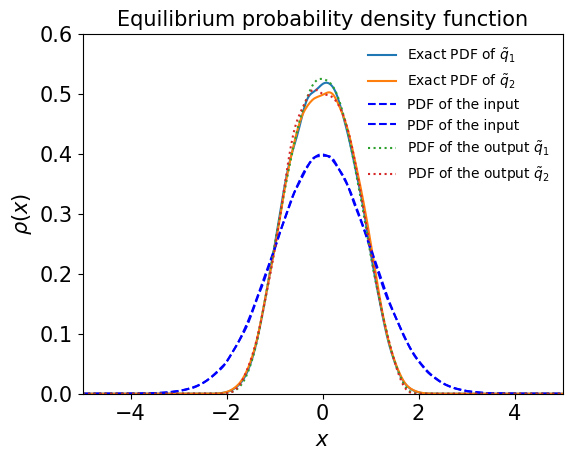

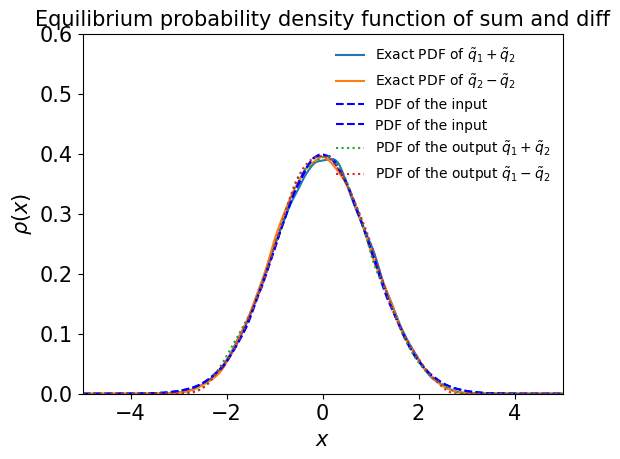

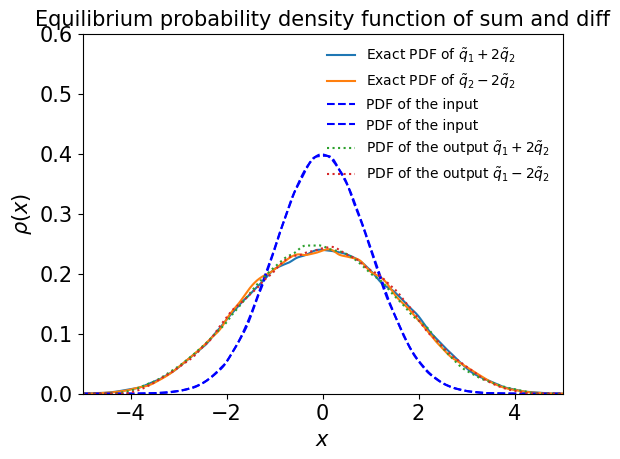

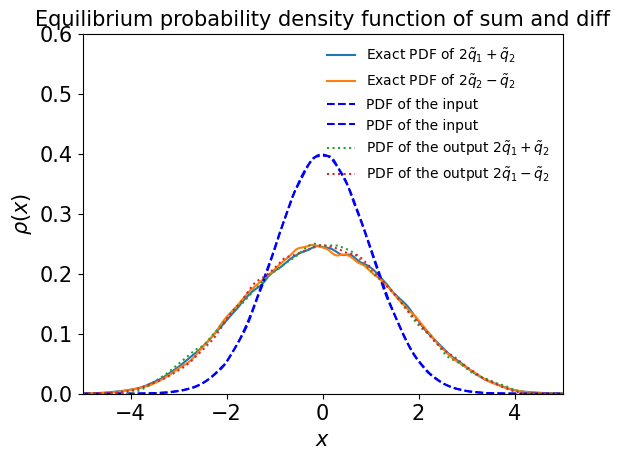

In [38]:
test3(model)

## Test 4: Comparing the higher-order ACF

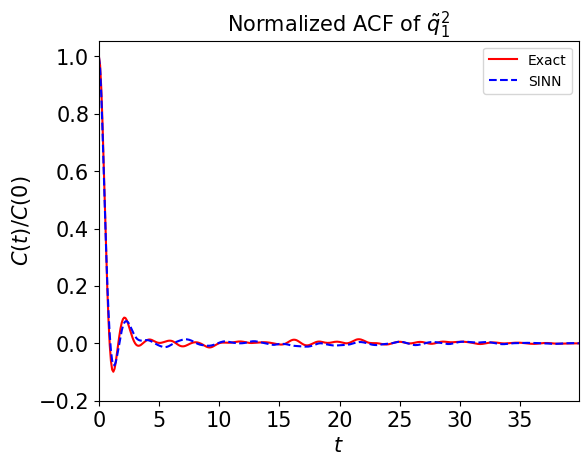

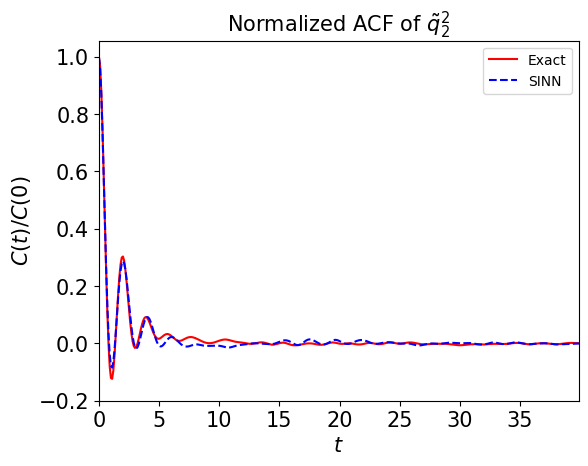

In [39]:
test4(model)

## Test 5: plot the expolation result, i.e. Prediction of the FPU-Langevin dynamics for longer time 

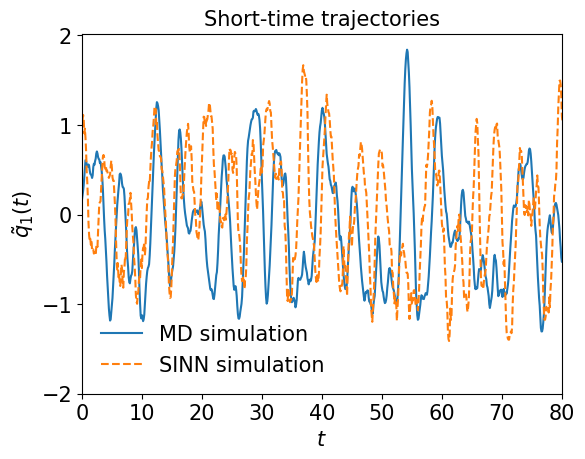

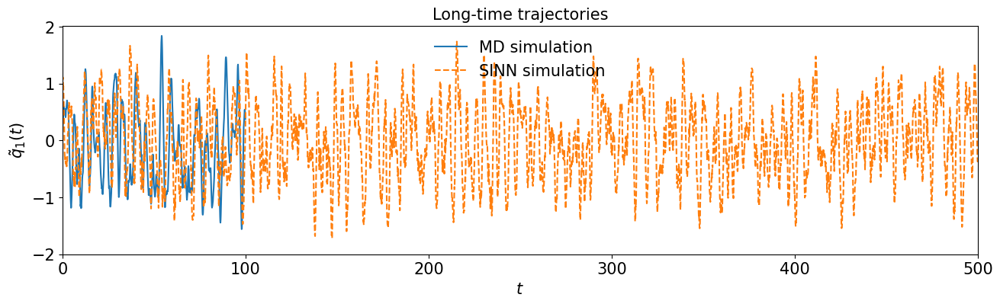

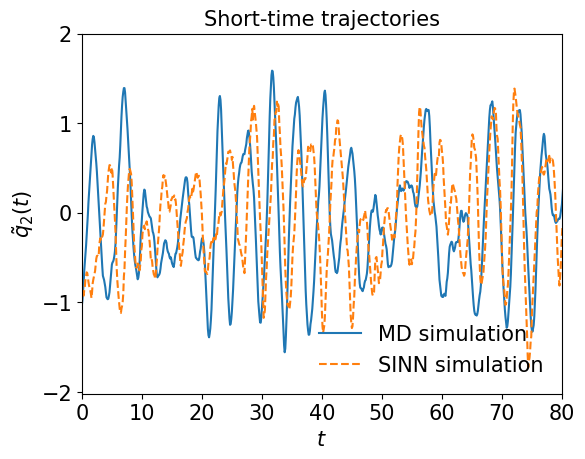

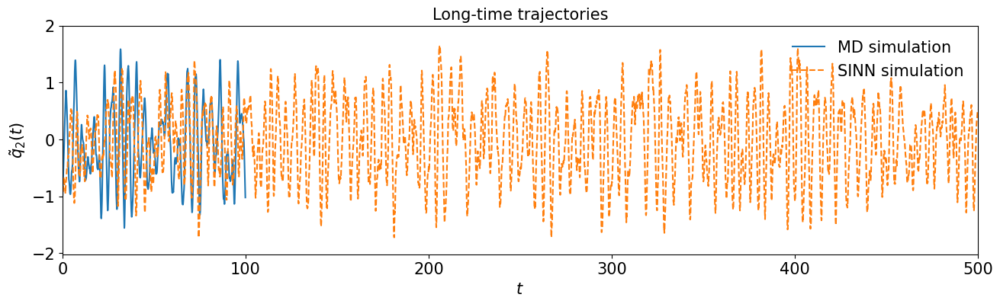

In [40]:
test5(model)

# Test 6: comparing scatter plots

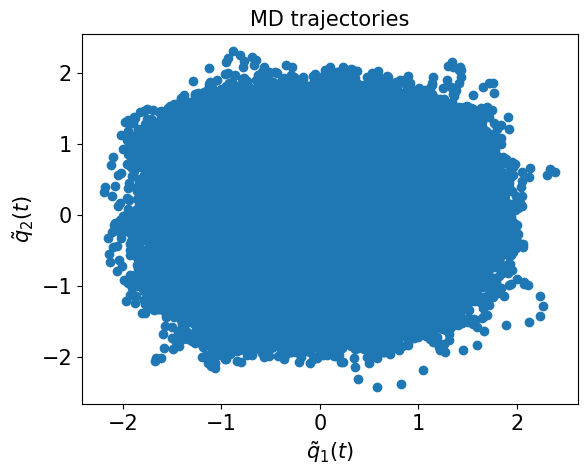

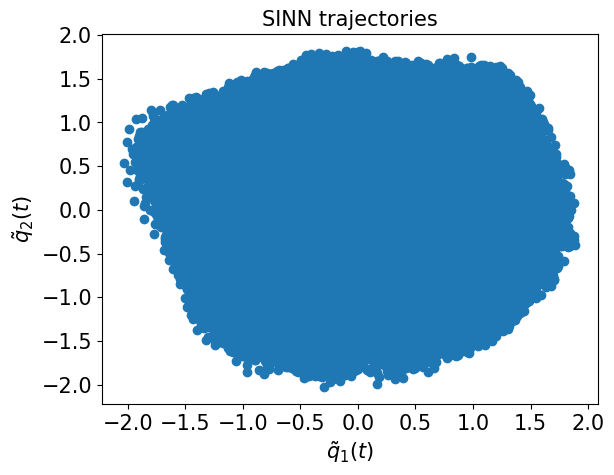

In [41]:
test6(model)

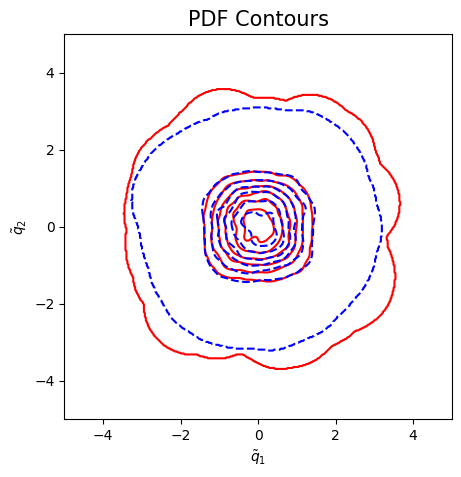

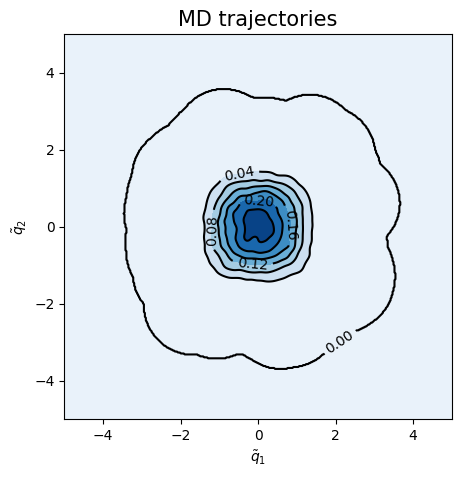

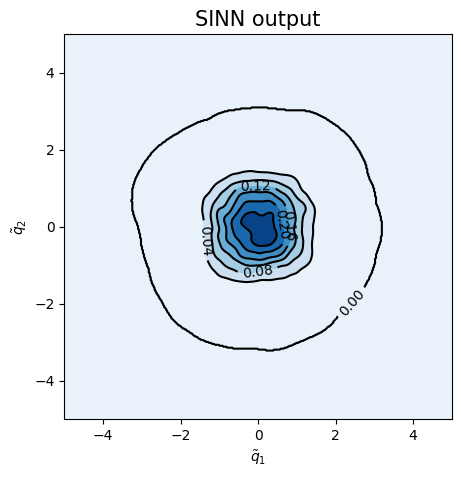

<Figure size 500x500 with 0 Axes>

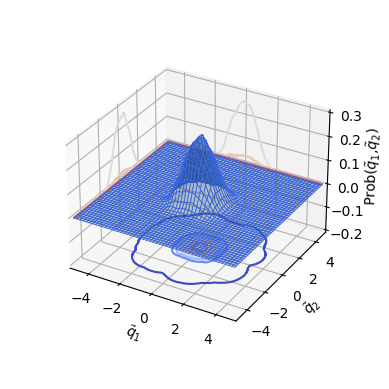

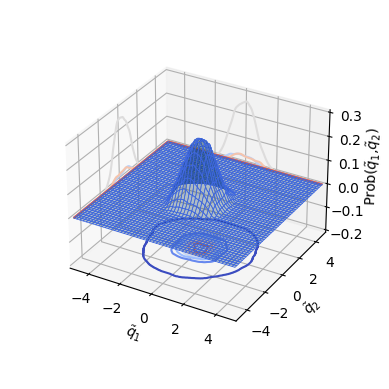

In [42]:
test7(model)

In [43]:
### Defining SINN model
net1 = SINN(2, 10, 2, 2).to(device)

In [44]:
model1 = Model(net=net1)

In [45]:
model1.train()

[0]-th step loss: 0.5305, 0.5291, acf: 0.00928, ccf: 0.00566, pdf: 0.24639, pdf2: 0.26622, acf2: 0.00157
[50]-th step loss: 0.2043, 0.1946, acf: 0.00662, ccf: 0.01189, pdf: 0.08292, pdf2: 0.09172, acf2: 0.00145
[100]-th step loss: 0.0658, 0.0658, acf: 0.00825, ccf: 0.01652, pdf: 0.00905, pdf2: 0.03061, acf2: 0.00142
[150]-th step loss: 0.0488, 0.0487, acf: 0.00611, ccf: 0.01319, pdf: 0.00437, pdf2: 0.02378, acf2: 0.00127
[200]-th step loss: 0.0357, 0.0357, acf: 0.00544, ccf: 0.01091, pdf: 0.00290, pdf2: 0.01504, acf2: 0.00137
[250]-th step loss: 0.0188, 0.0187, acf: 0.00347, ccf: 0.00860, pdf: 0.00181, pdf2: 0.00362, acf2: 0.00119
[300]-th step loss: 0.0138, 0.0139, acf: 0.00325, ccf: 0.00741, pdf: 0.00083, pdf2: 0.00131, acf2: 0.00114
[350]-th step loss: 0.0113, 0.0115, acf: 0.00323, ccf: 0.00576, pdf: 0.00061, pdf2: 0.00066, acf2: 0.00129
[400]-th step loss: 0.0090, 0.0092, acf: 0.00343, ccf: 0.00313, pdf: 0.00064, pdf2: 0.00064, acf2: 0.00137
[450]-th step loss: 0.0053, 0.0056, acf:

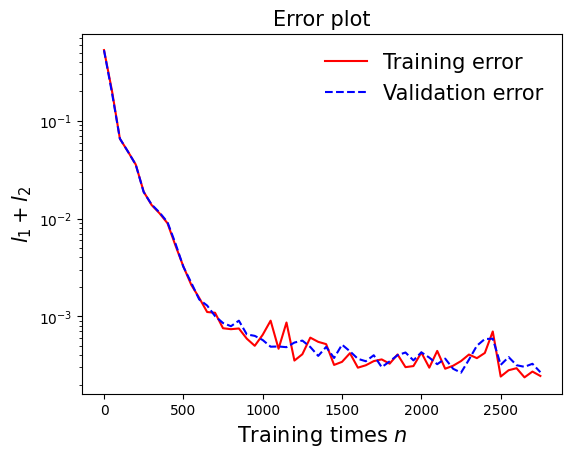

In [46]:
draw_loss(model1)

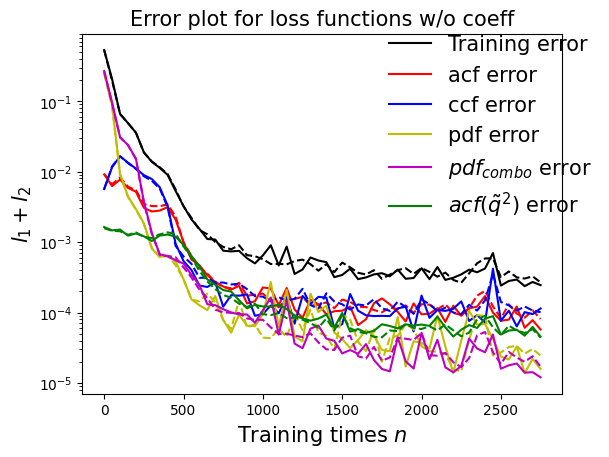

In [47]:
draw_errors(model1)

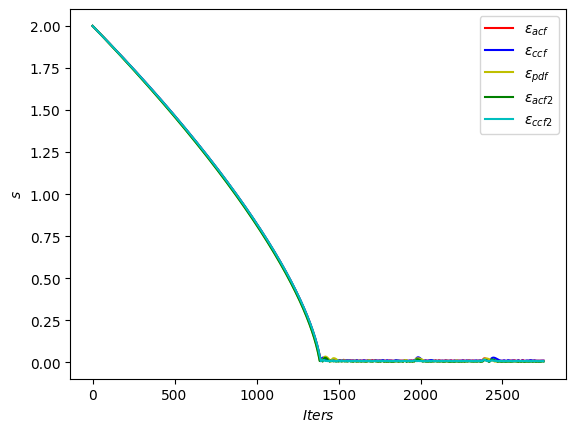

In [48]:
draw_adaptive_w(model1)

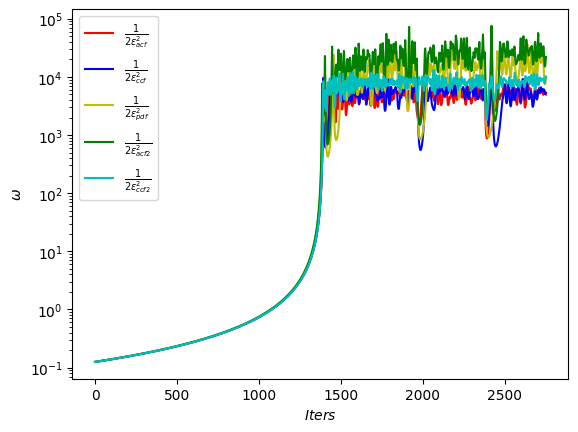

In [49]:
draw_epoch_w(model1)

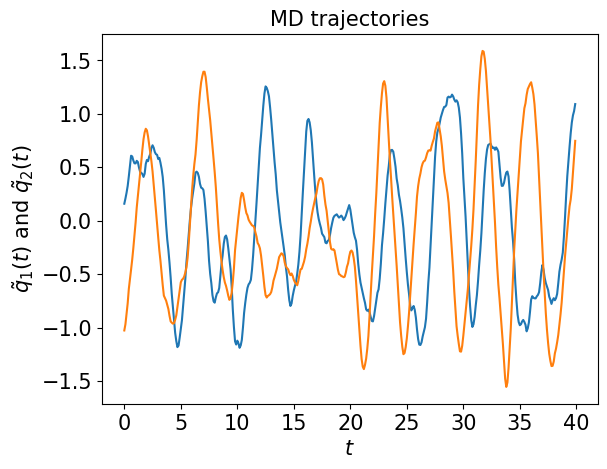

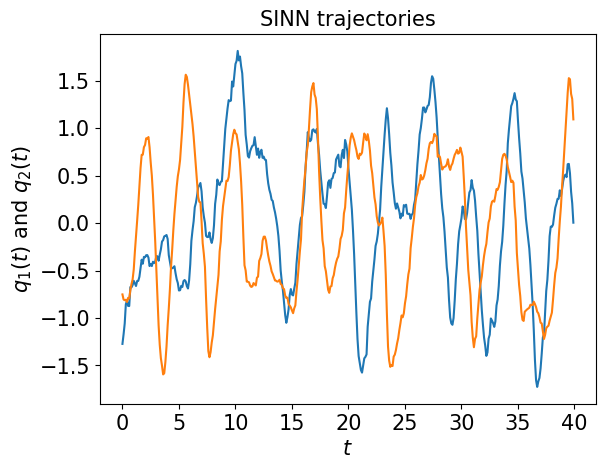

In [50]:
test1(model1)

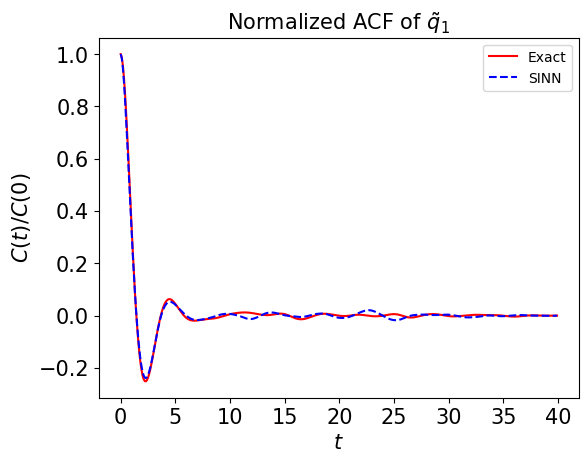

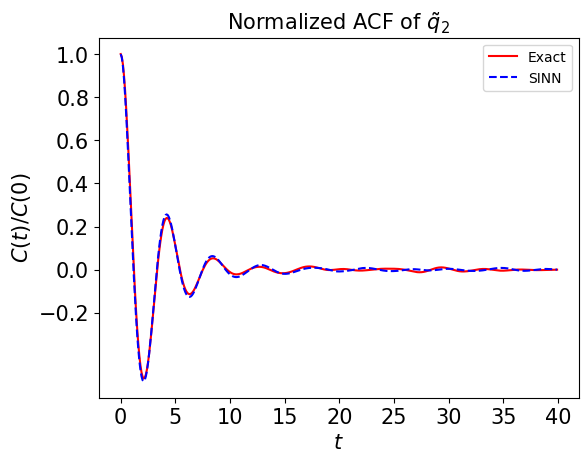

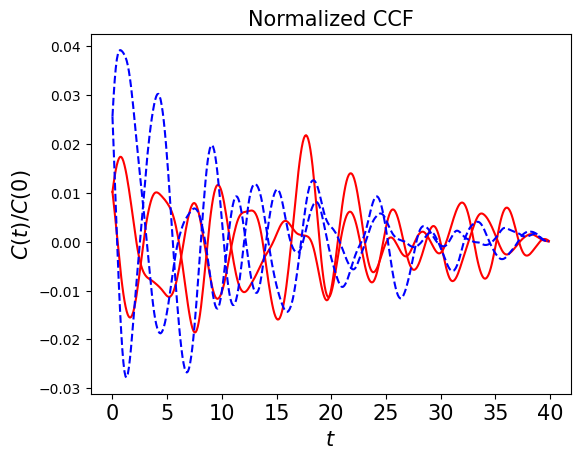

In [51]:
test2(model1)

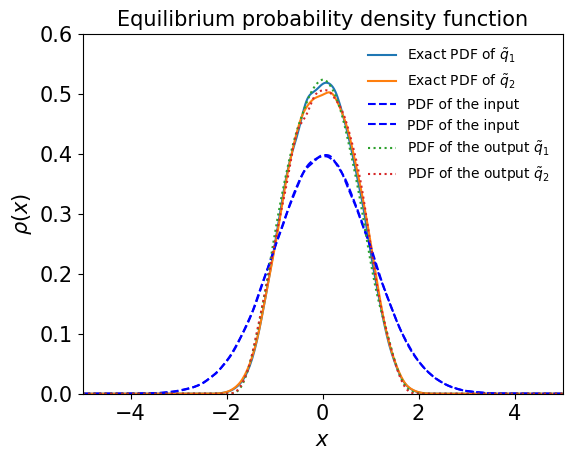

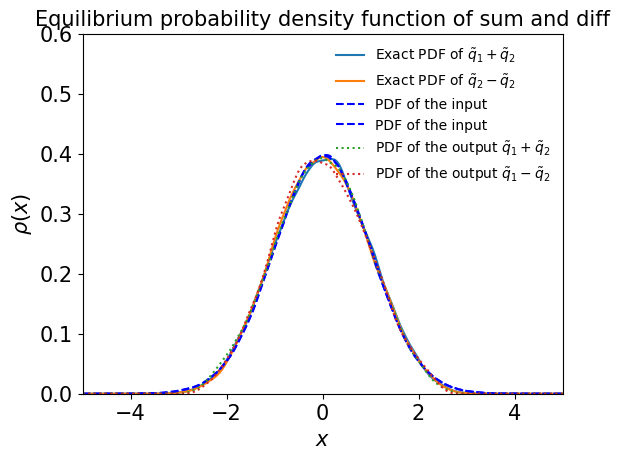

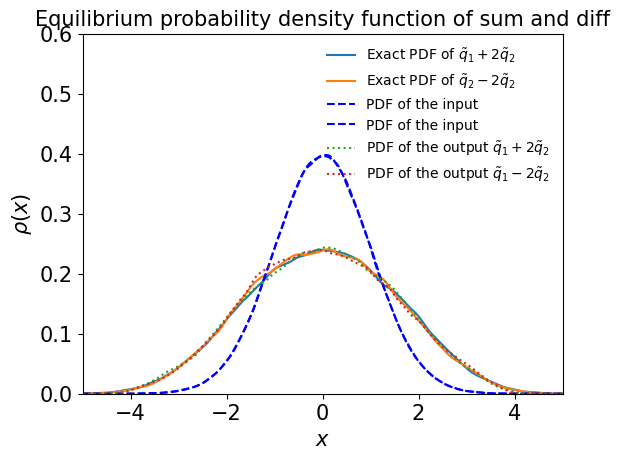

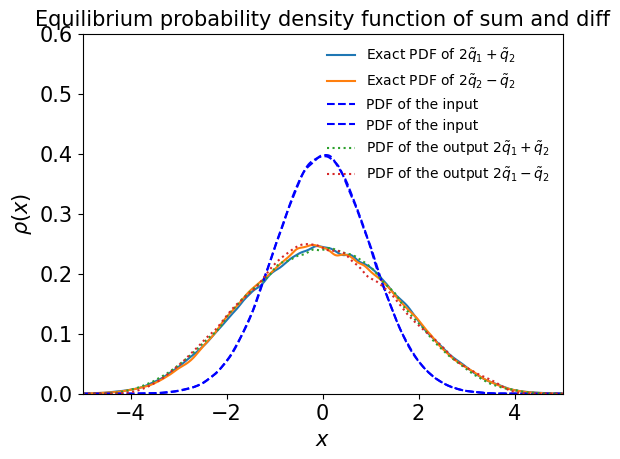

In [52]:
test3(model1)

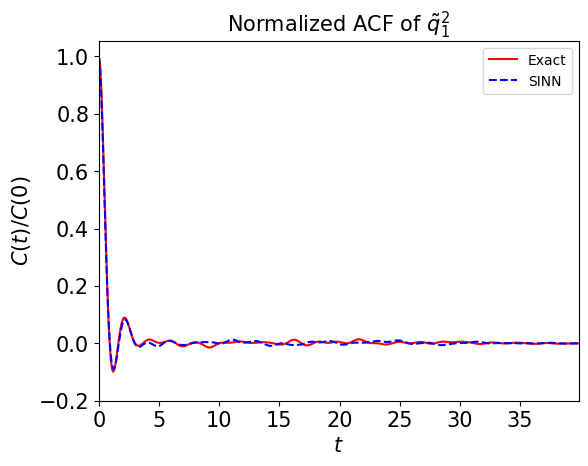

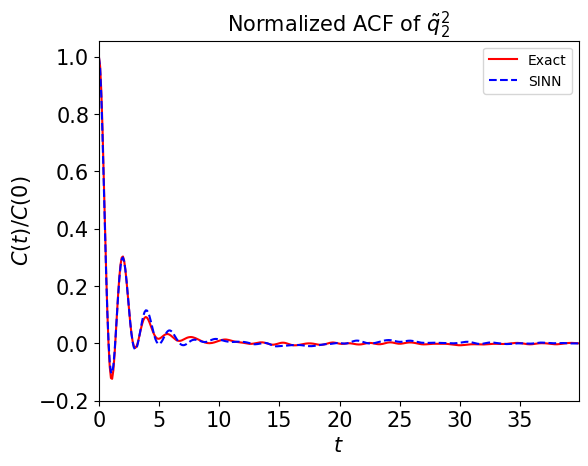

In [53]:
test4(model1)

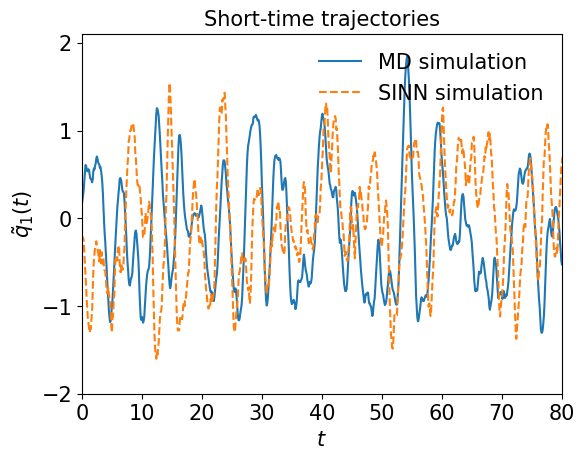

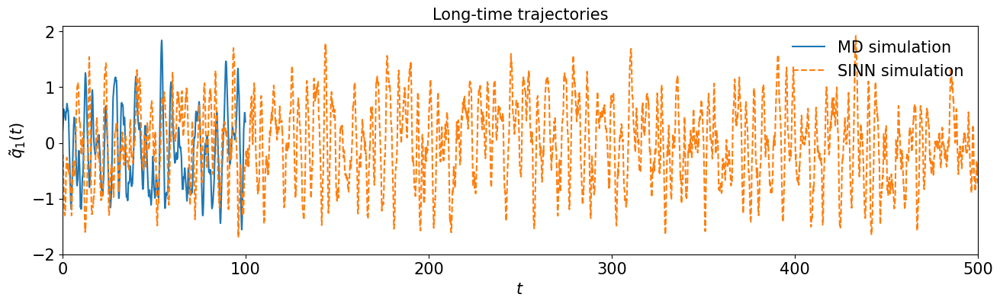

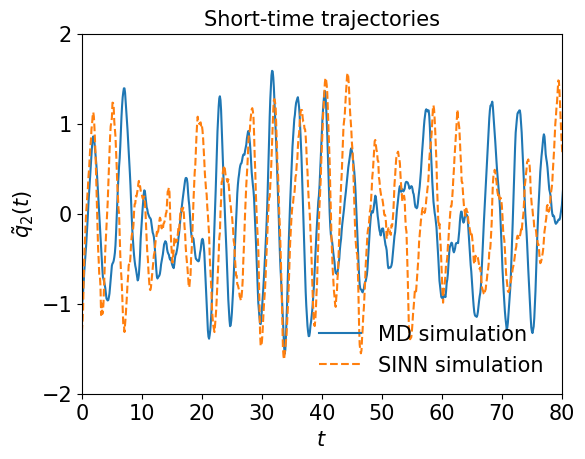

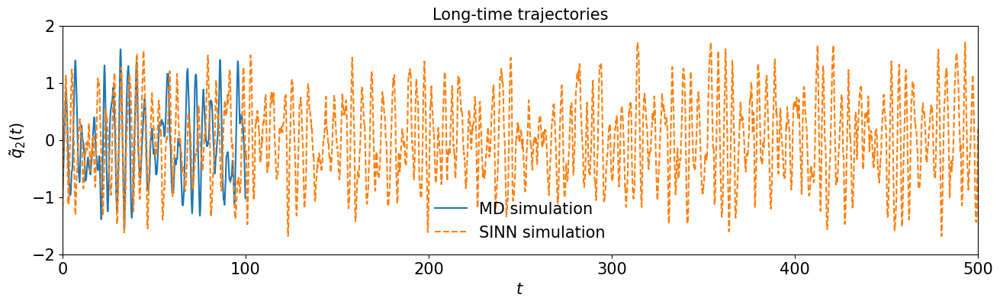

In [54]:
test5(model1)

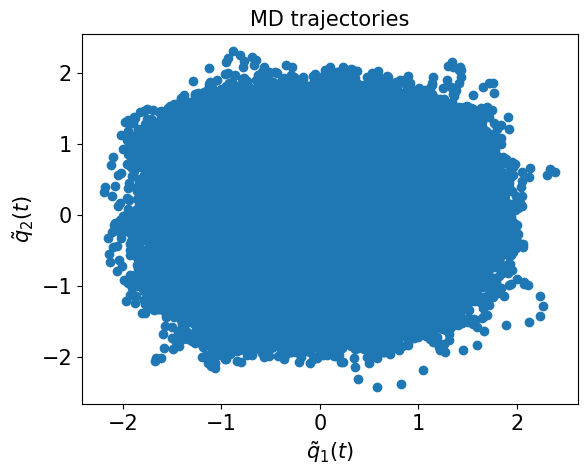

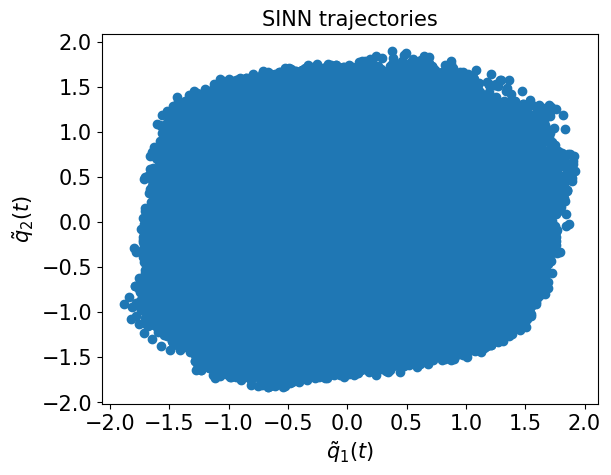

In [55]:
test6(model1)

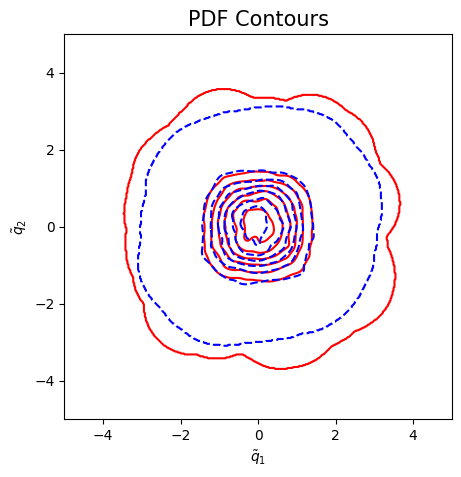

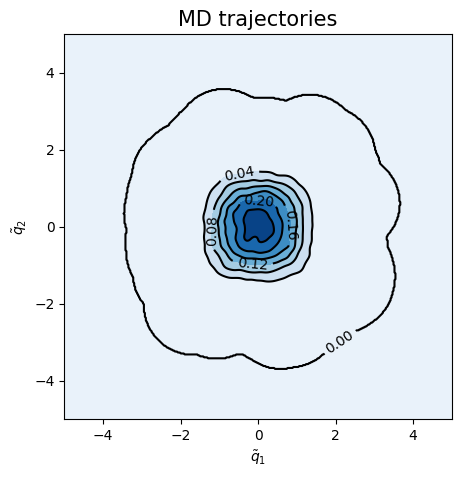

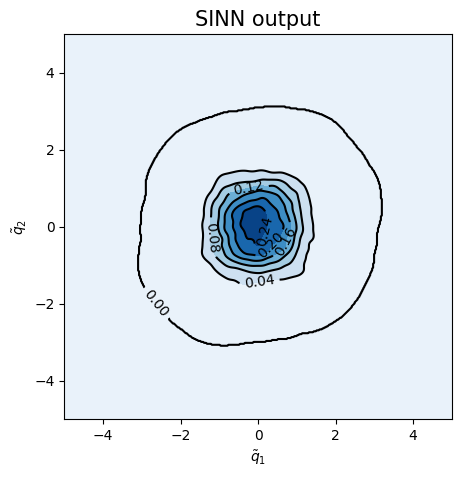

<Figure size 500x500 with 0 Axes>

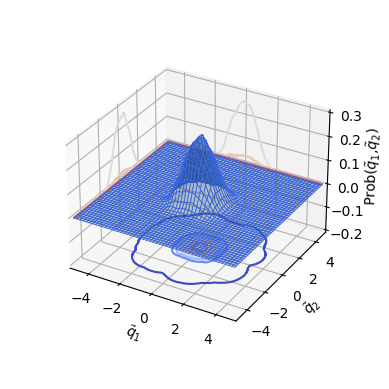

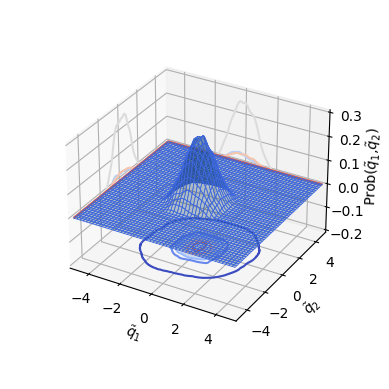

In [56]:
test7(model1)

In [57]:
### Defining SINN model
net2 = SINN(2, 10, 2, 2).to(device)

In [58]:
model2 = Model(net=net2)

In [59]:
model2.train()

[0]-th step loss: 0.5348, 0.5341, acf: 0.01160, ccf: 0.00380, pdf: 0.24692, pdf2: 0.26908, acf2: 0.00274
[50]-th step loss: 0.2464, 0.2367, acf: 0.00683, ccf: 0.01259, pdf: 0.11091, pdf2: 0.10397, acf2: 0.00242
[100]-th step loss: 0.0635, 0.0627, acf: 0.00688, ccf: 0.01364, pdf: 0.01536, pdf2: 0.02460, acf2: 0.00224
[150]-th step loss: 0.0320, 0.0322, acf: 0.00745, ccf: 0.00823, pdf: 0.00765, pdf2: 0.00718, acf2: 0.00166
[200]-th step loss: 0.0218, 0.0216, acf: 0.00792, ccf: 0.00645, pdf: 0.00282, pdf2: 0.00269, acf2: 0.00172
[250]-th step loss: 0.0177, 0.0177, acf: 0.00659, ccf: 0.00651, pdf: 0.00145, pdf2: 0.00178, acf2: 0.00138
[300]-th step loss: 0.0146, 0.0146, acf: 0.00501, ccf: 0.00582, pdf: 0.00111, pdf2: 0.00117, acf2: 0.00153
[350]-th step loss: 0.0097, 0.0096, acf: 0.00260, ccf: 0.00273, pdf: 0.00143, pdf2: 0.00097, acf2: 0.00191
[400]-th step loss: 0.0041, 0.0042, acf: 0.00074, ccf: 0.00109, pdf: 0.00074, pdf2: 0.00092, acf2: 0.00069
[450]-th step loss: 0.0032, 0.0033, acf:

[3850]-th step loss: 0.0004, 0.0003, acf: 0.00017, ccf: 0.00006, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00008
[3900]-th step loss: 0.0004, 0.0004, acf: 0.00018, ccf: 0.00006, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00008
[3950]-th step loss: 0.0004, 0.0005, acf: 0.00031, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00009
[4000]-th step loss: 0.0003, 0.0004, acf: 0.00015, ccf: 0.00009, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00008
[4050]-th step loss: 0.0003, 0.0003, acf: 0.00015, ccf: 0.00006, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00007
[4100]-th step loss: 0.0005, 0.0004, acf: 0.00019, ccf: 0.00009, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00008
[4150]-th step loss: 0.0004, 0.0004, acf: 0.00017, ccf: 0.00009, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00008
[4200]-th step loss: 0.0003, 0.0004, acf: 0.00016, ccf: 0.00010, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00010
[4250]-th step loss: 0.0004, 0.0004, acf: 0.00015, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00010
[4300]-th step loss: 0.0003,

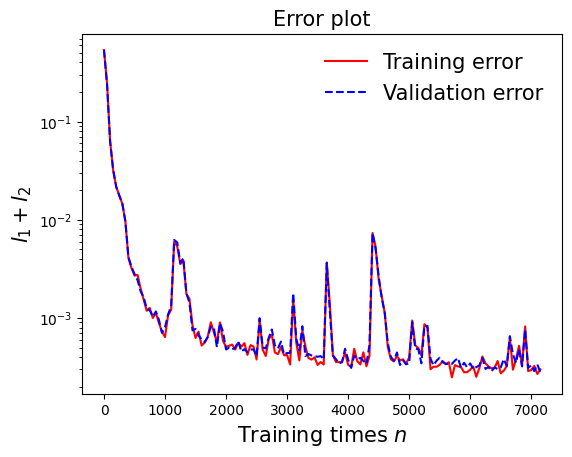

In [60]:
draw_loss(model2)

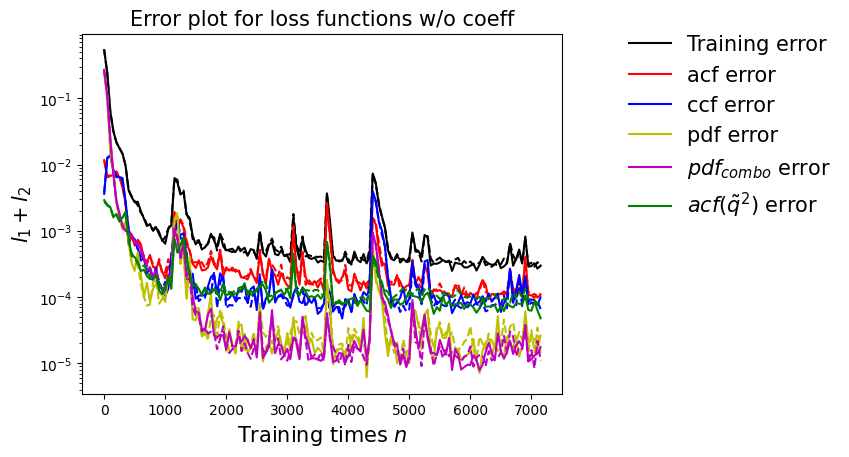

In [61]:
draw_errors(model2)

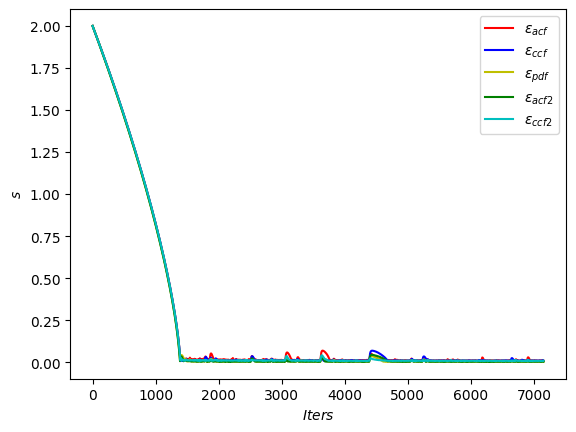

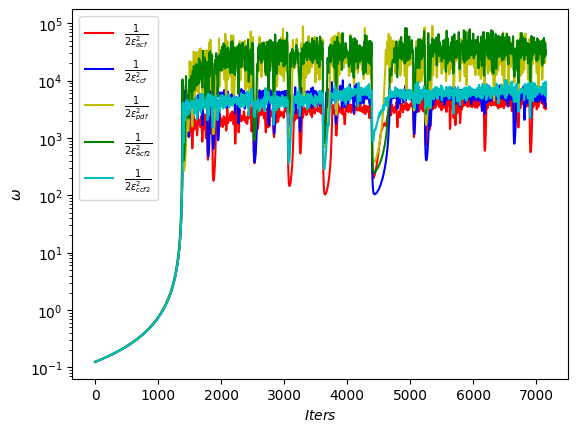

In [62]:
draw_adaptive_w(model2)
draw_epoch_w(model2)

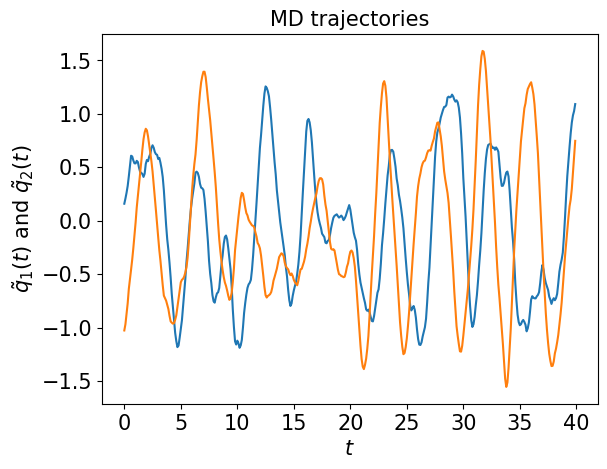

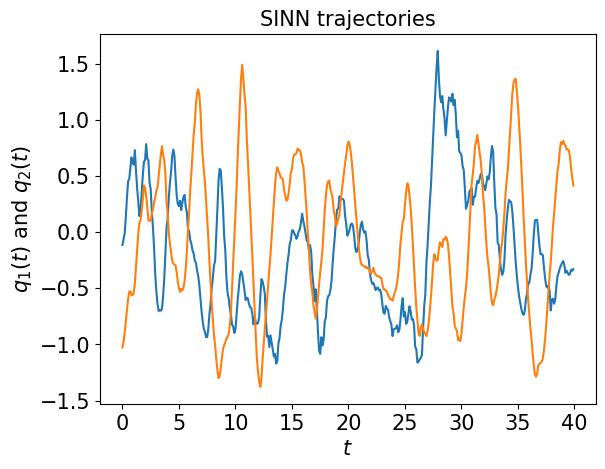

In [63]:
test1(model2)

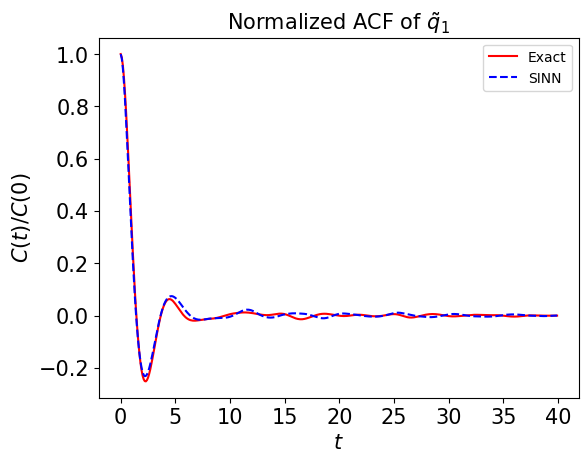

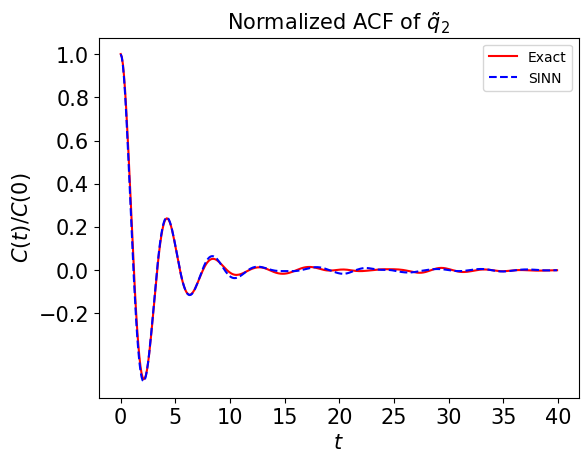

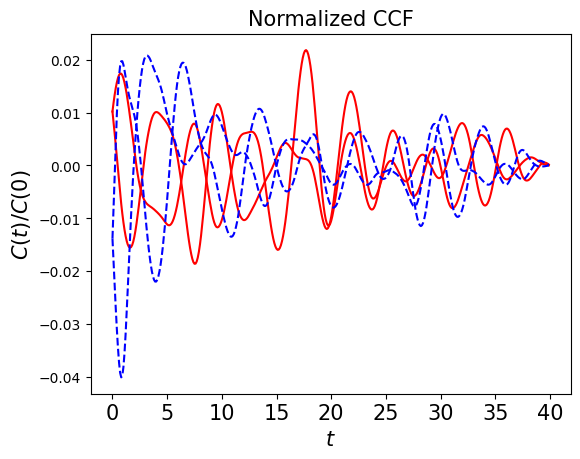

In [64]:
test2(model2)

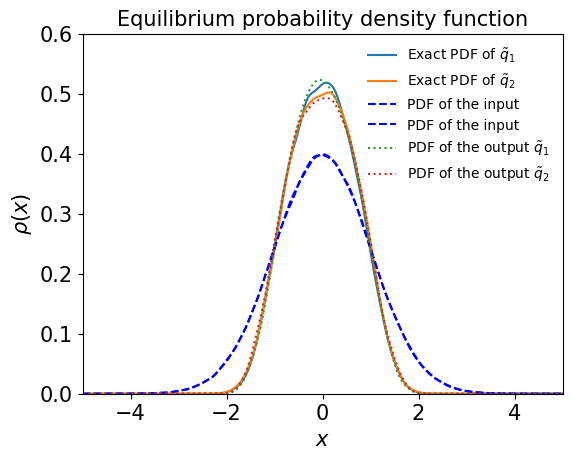

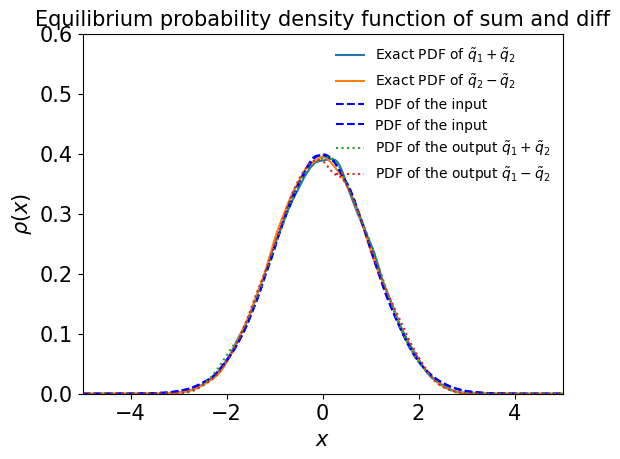

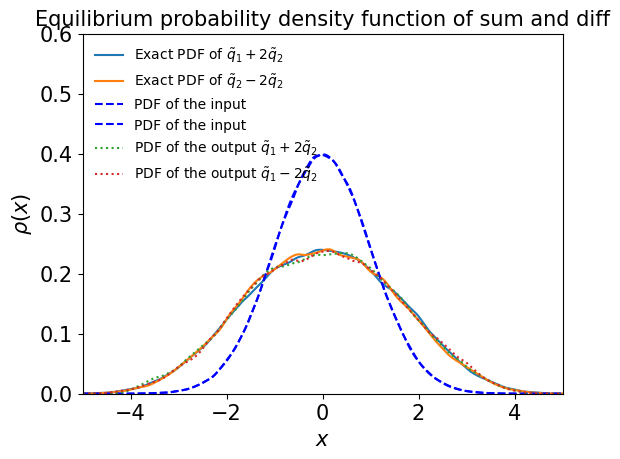

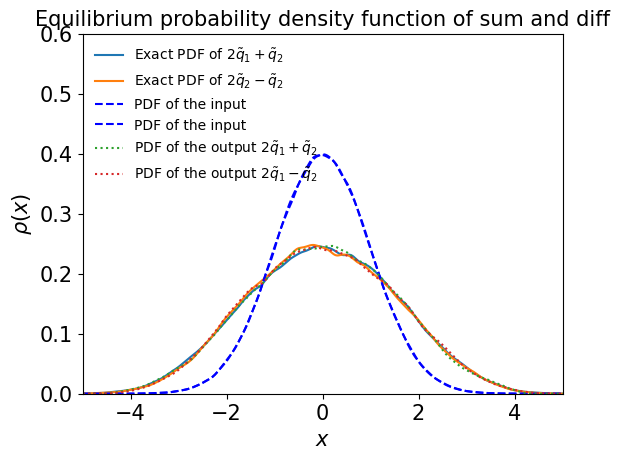

In [65]:
test3(model2)

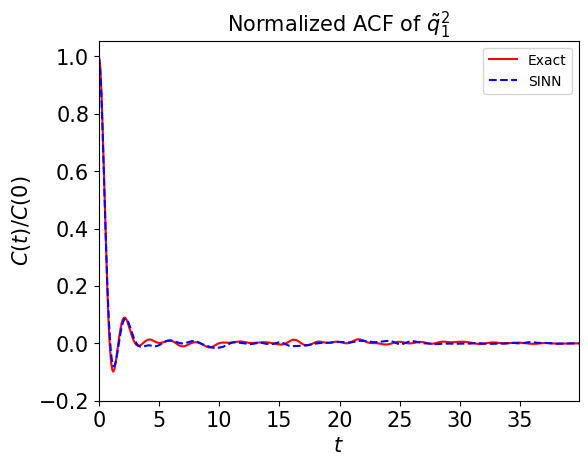

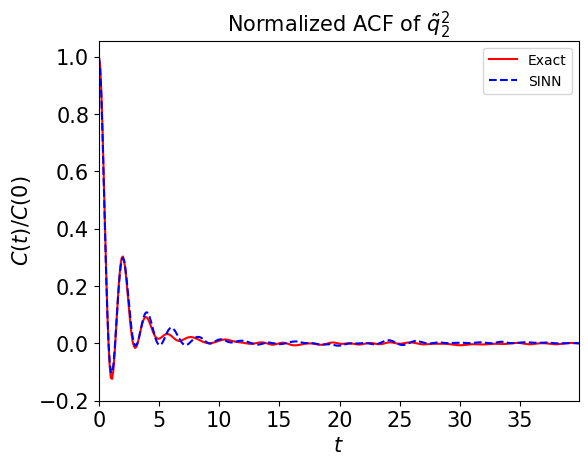

In [66]:
test4(model2)

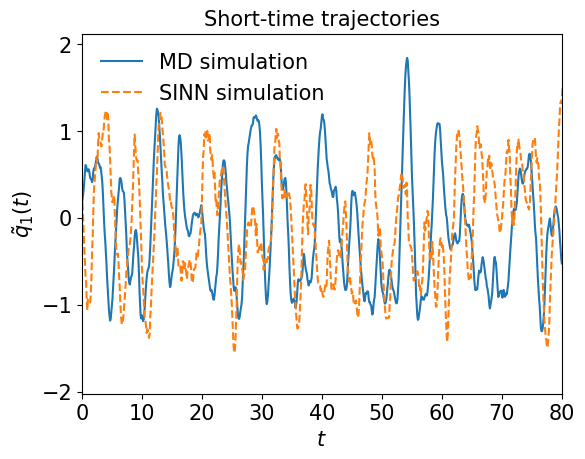

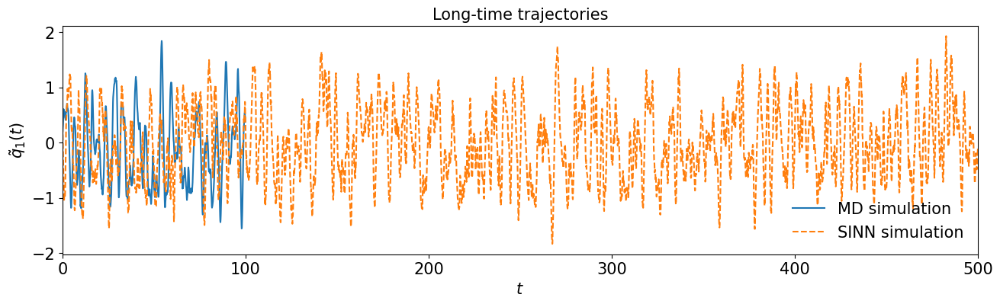

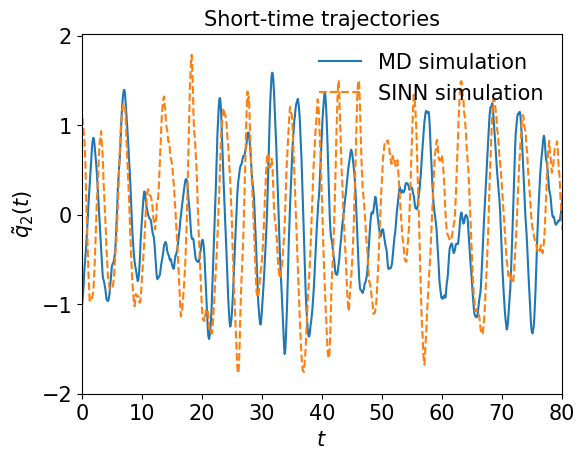

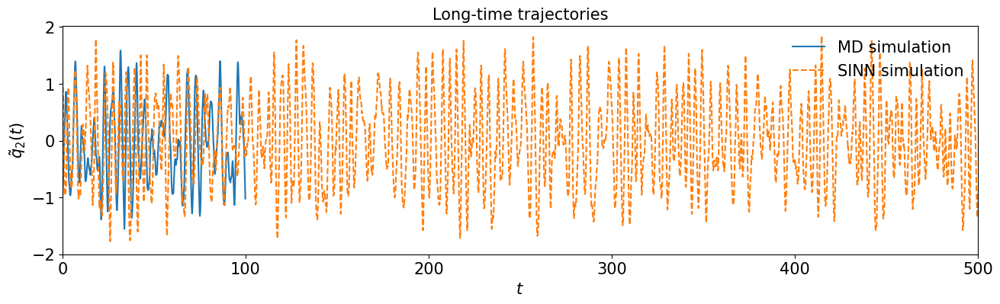

In [67]:
test5(model2)

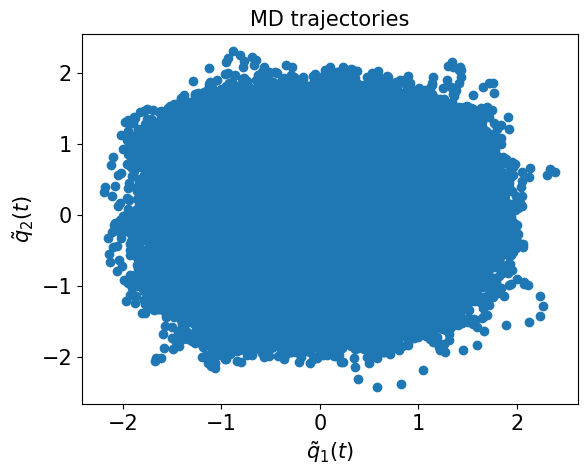

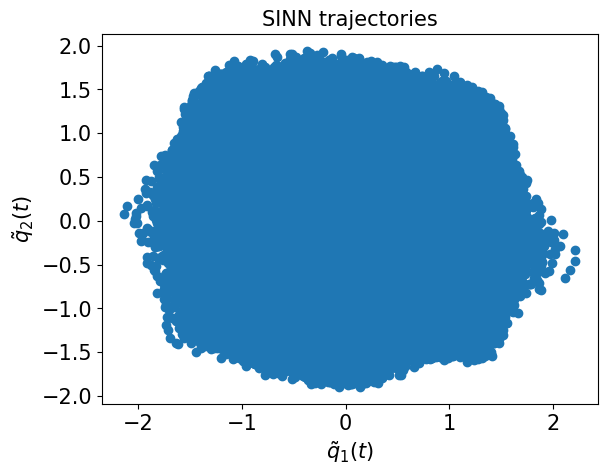

In [68]:
test6(model2)

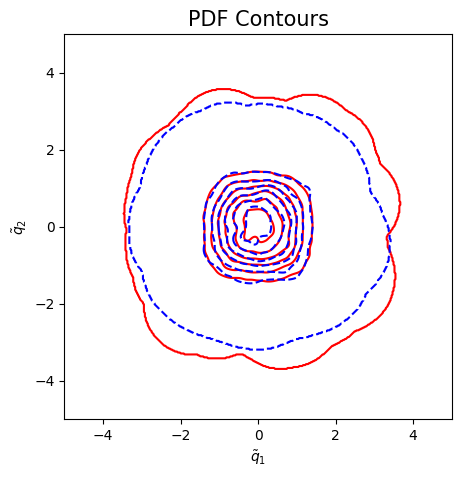

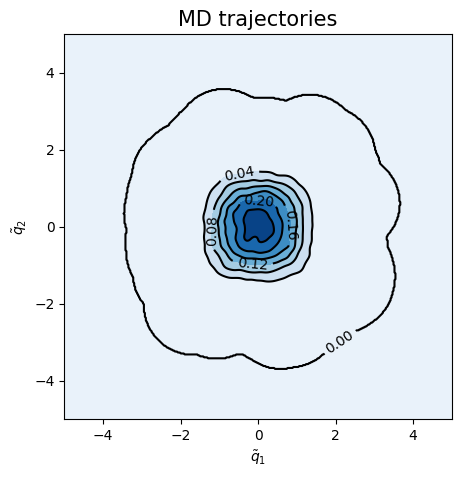

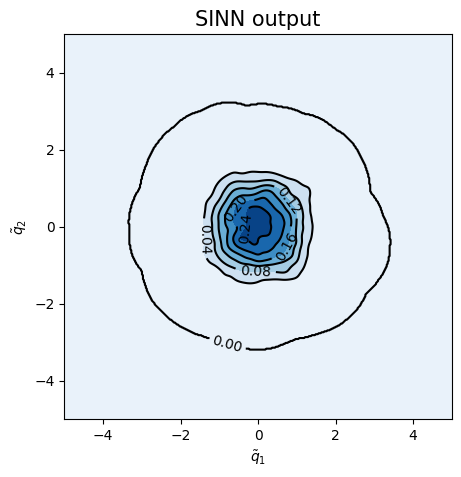

<Figure size 500x500 with 0 Axes>

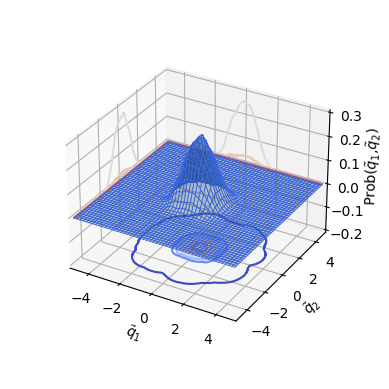

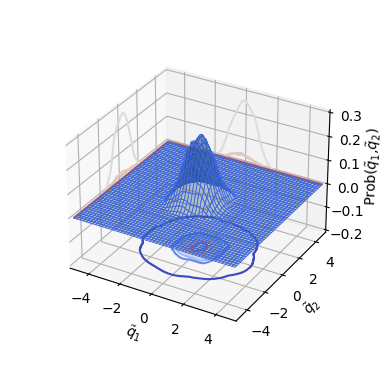

In [69]:
test7(model2)

In [70]:
### Defining SINN model
net3 = SINN(2, 10, 2, 2).to(device)

In [71]:
model3 = Model(net=net3)

In [72]:
model3.train()

[0]-th step loss: 0.5326, 0.5314, acf: 0.01208, ccf: 0.00186, pdf: 0.24685, pdf2: 0.26772, acf2: 0.00292
[50]-th step loss: 0.2436, 0.2353, acf: 0.00888, ccf: 0.00237, pdf: 0.14395, pdf2: 0.07783, acf2: 0.00223
[100]-th step loss: 0.0573, 0.0562, acf: 0.00786, ccf: 0.01385, pdf: 0.01854, pdf2: 0.01421, acf2: 0.00175
[150]-th step loss: 0.0275, 0.0276, acf: 0.00607, ccf: 0.00913, pdf: 0.00495, pdf2: 0.00525, acf2: 0.00218
[200]-th step loss: 0.0167, 0.0166, acf: 0.00512, ccf: 0.00634, pdf: 0.00175, pdf2: 0.00176, acf2: 0.00167
[250]-th step loss: 0.0129, 0.0126, acf: 0.00617, ccf: 0.00294, pdf: 0.00092, pdf2: 0.00137, acf2: 0.00119
[300]-th step loss: 0.0099, 0.0100, acf: 0.00589, ccf: 0.00120, pdf: 0.00050, pdf2: 0.00116, acf2: 0.00120
[350]-th step loss: 0.0065, 0.0066, acf: 0.00390, ccf: 0.00034, pdf: 0.00026, pdf2: 0.00097, acf2: 0.00110
[400]-th step loss: 0.0027, 0.0026, acf: 0.00108, ccf: 0.00030, pdf: 0.00014, pdf2: 0.00058, acf2: 0.00051
[450]-th step loss: 0.0014, 0.0014, acf:

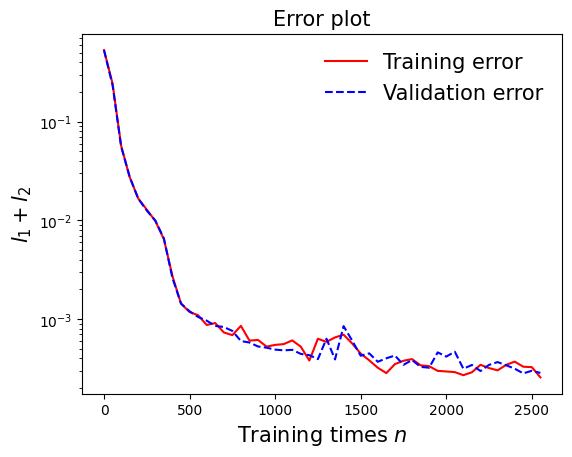

In [73]:
draw_loss(model3)

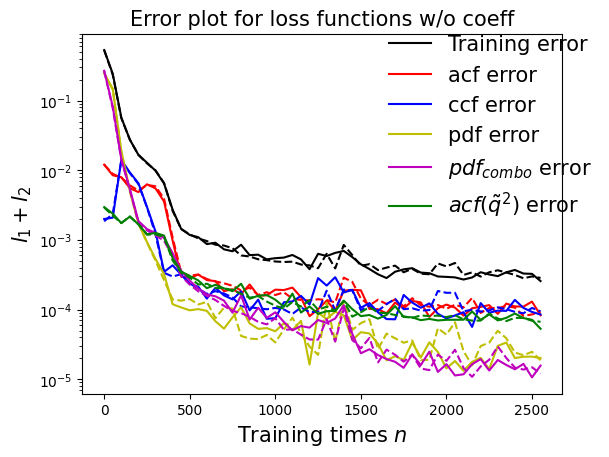

In [74]:
draw_errors(model3)

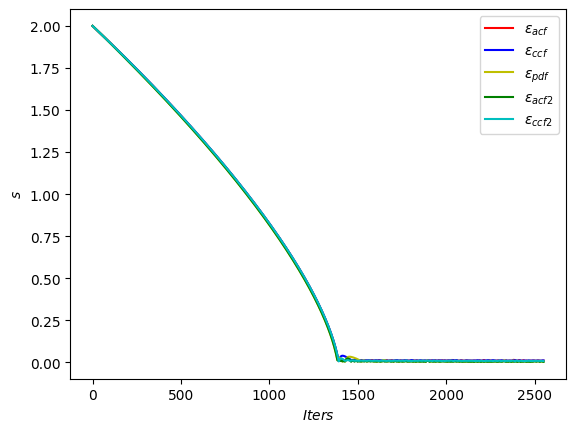

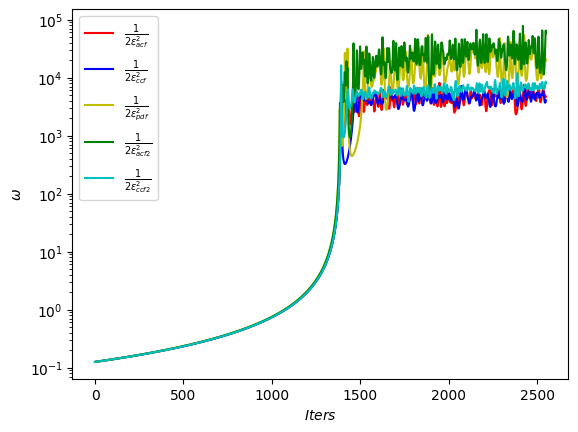

In [75]:
draw_adaptive_w(model3)
draw_epoch_w(model3)

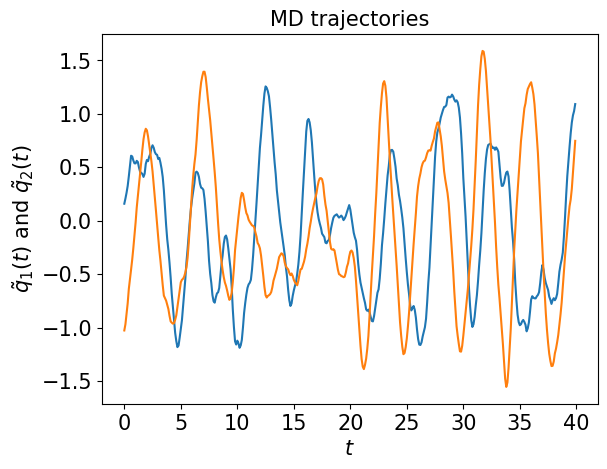

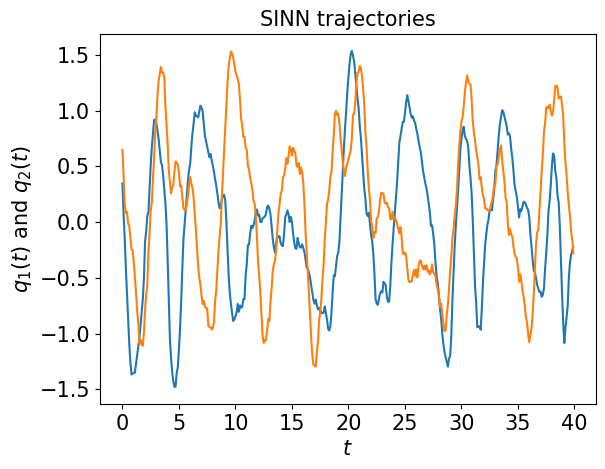

In [76]:
test1(model3)

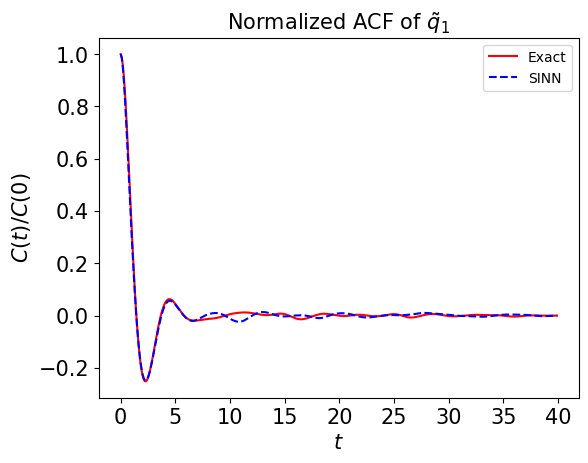

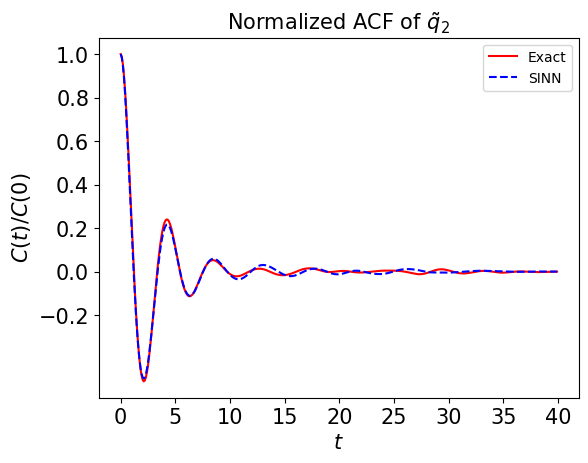

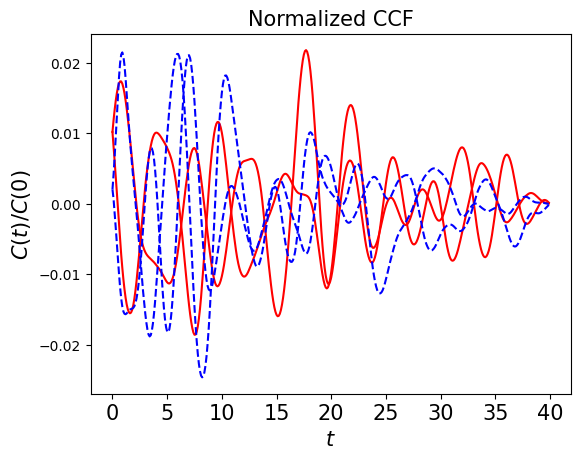

In [77]:
test2(model3)

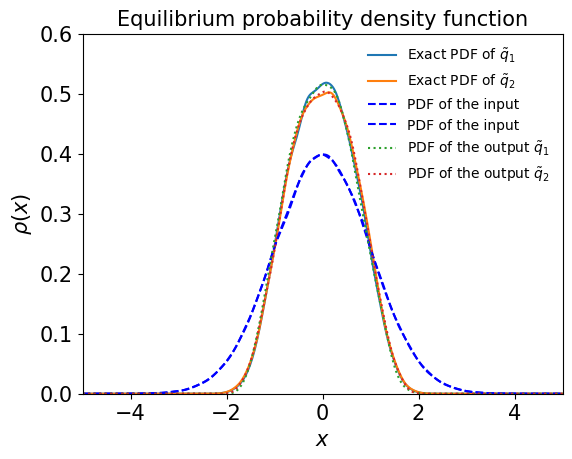

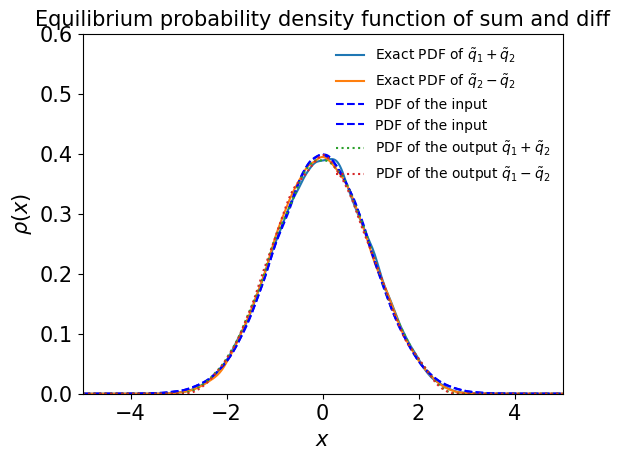

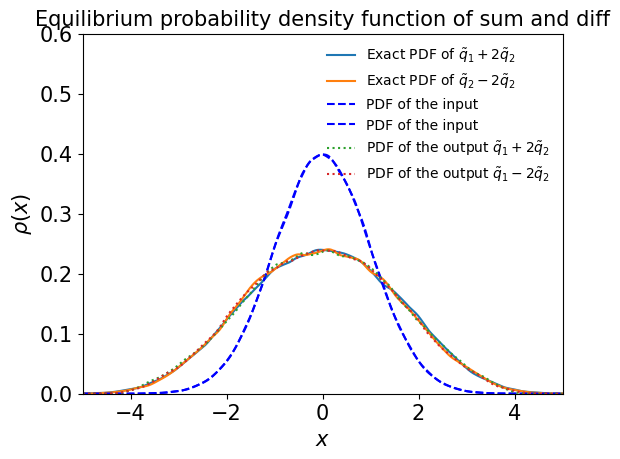

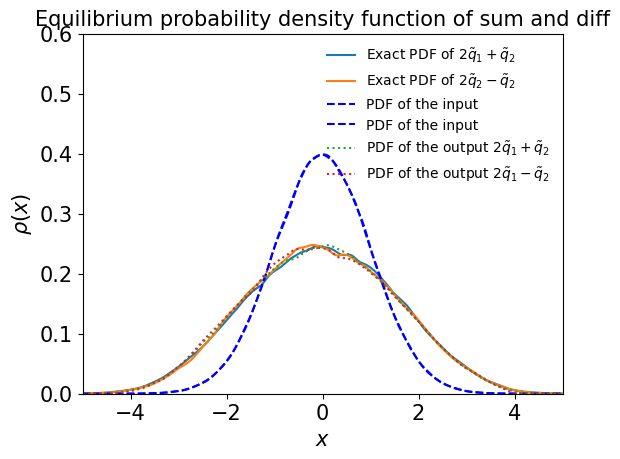

In [78]:
test3(model3)

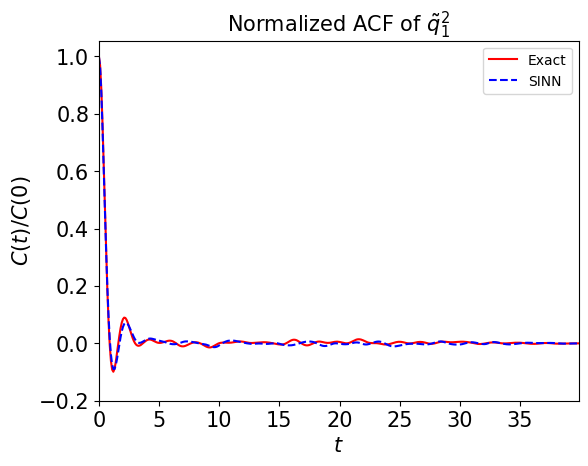

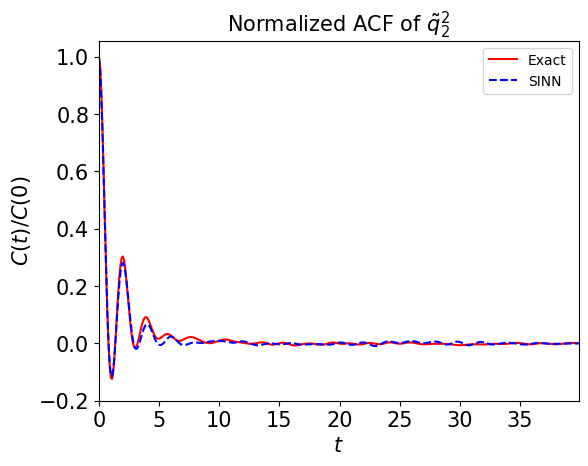

In [79]:
test4(model3)

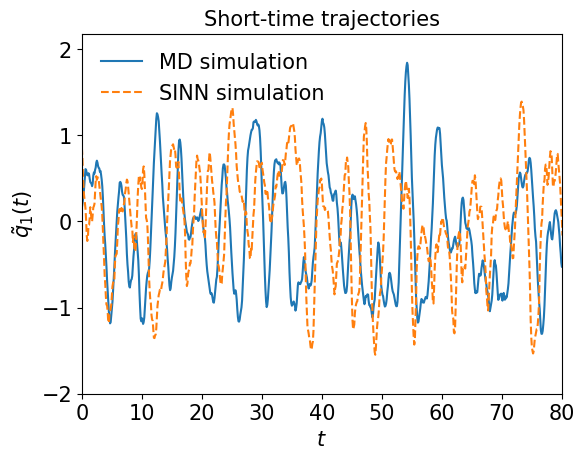

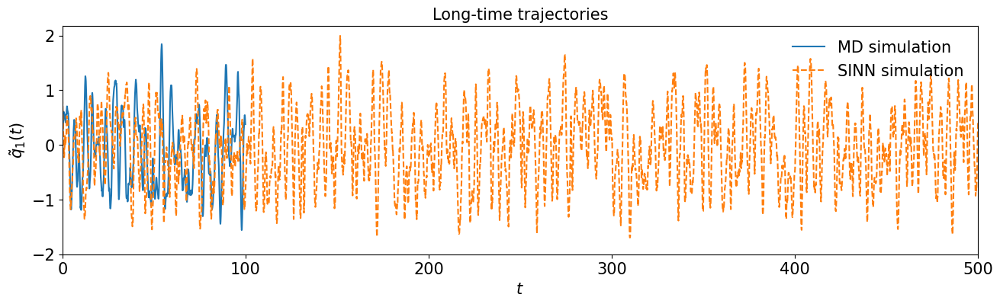

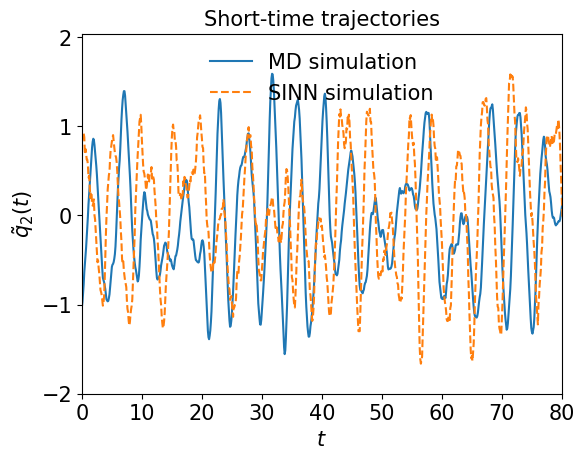

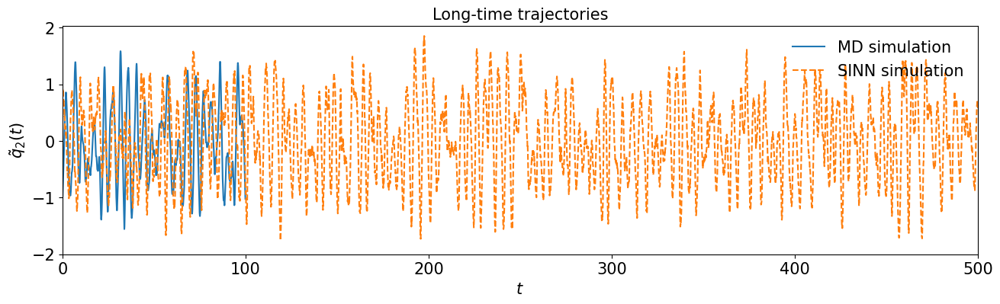

In [80]:
test5(model3)

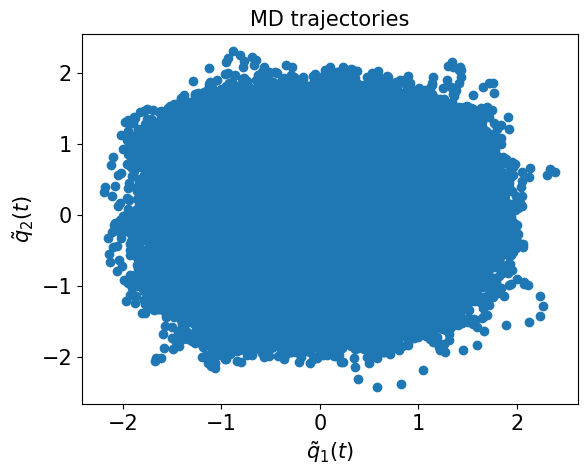

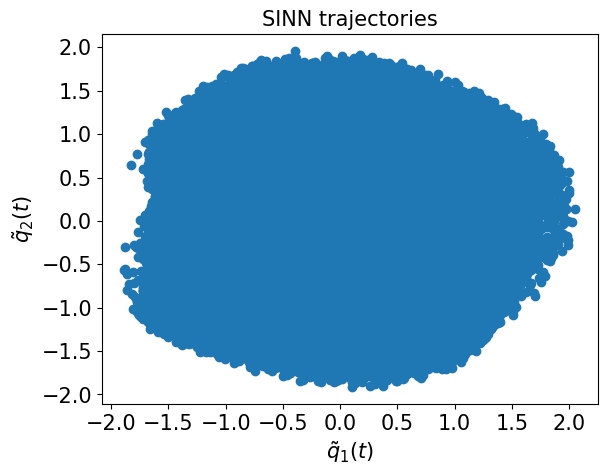

In [81]:
test6(model3)

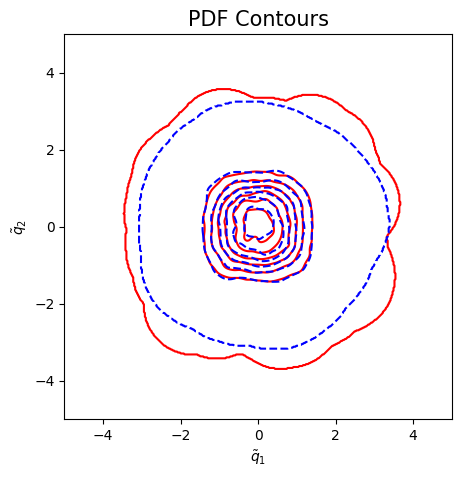

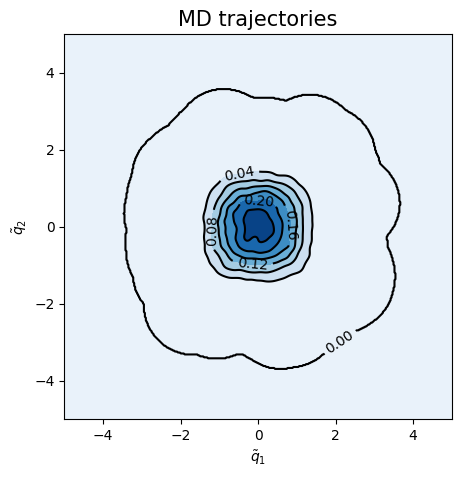

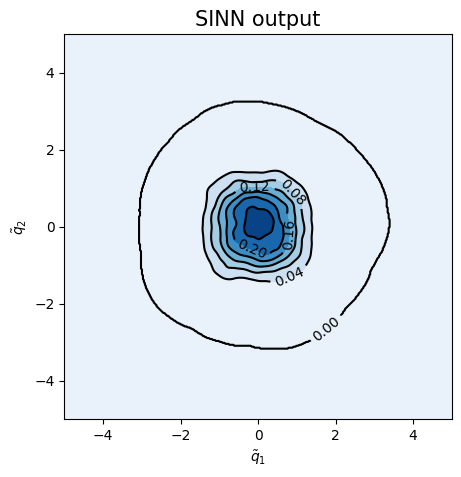

<Figure size 500x500 with 0 Axes>

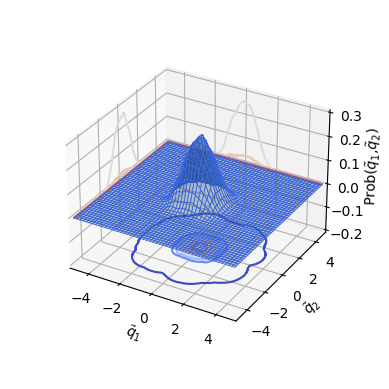

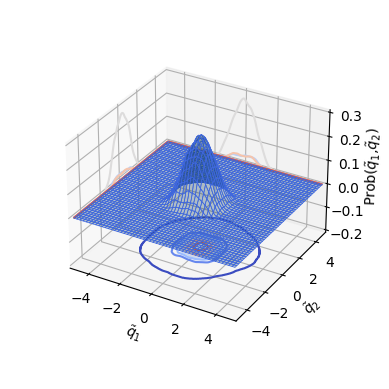

In [82]:
test7(model3)

In [83]:
### Defining SINN model
net4 = SINN(2, 10, 2, 2).to(device)

In [84]:
model4 = Model(net=net4)

In [85]:
model4.train()

[0]-th step loss: 0.5314, 0.5306, acf: 0.01079, ccf: 0.00361, pdf: 0.24596, pdf2: 0.26791, acf2: 0.00235
[50]-th step loss: 0.3096, 0.2989, acf: 0.00680, ccf: 0.00025, pdf: 0.17277, pdf2: 0.11741, acf2: 0.00168
[100]-th step loss: 0.0305, 0.0305, acf: 0.00622, ccf: 0.00379, pdf: 0.01131, pdf2: 0.00647, acf2: 0.00272
[150]-th step loss: 0.0161, 0.0165, acf: 0.00528, ccf: 0.00279, pdf: 0.00388, pdf2: 0.00314, acf2: 0.00137
[200]-th step loss: 0.0127, 0.0128, acf: 0.00575, ccf: 0.00155, pdf: 0.00217, pdf2: 0.00220, acf2: 0.00112
[250]-th step loss: 0.0100, 0.0104, acf: 0.00534, ccf: 0.00088, pdf: 0.00142, pdf2: 0.00164, acf2: 0.00111
[300]-th step loss: 0.0083, 0.0084, acf: 0.00479, ccf: 0.00041, pdf: 0.00095, pdf2: 0.00110, acf2: 0.00116
[350]-th step loss: 0.0069, 0.0072, acf: 0.00451, ccf: 0.00016, pdf: 0.00061, pdf2: 0.00069, acf2: 0.00121
[400]-th step loss: 0.0064, 0.0065, acf: 0.00426, ccf: 0.00013, pdf: 0.00041, pdf2: 0.00050, acf2: 0.00121
[450]-th step loss: 0.0058, 0.0059, acf:

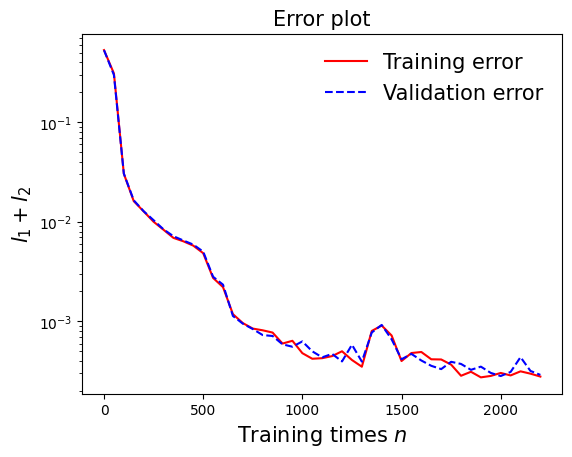

In [86]:
draw_loss(model4)

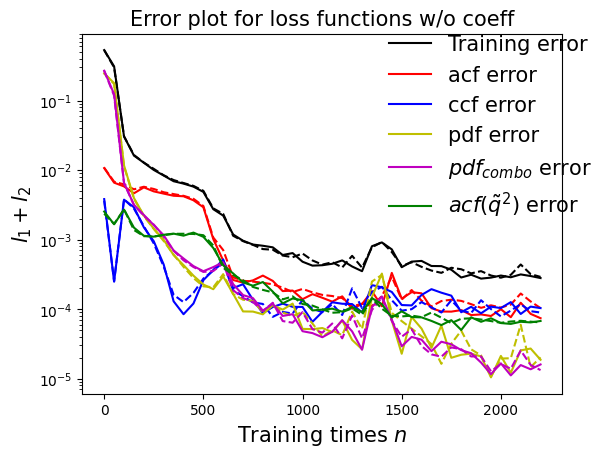

In [87]:
draw_errors(model4)

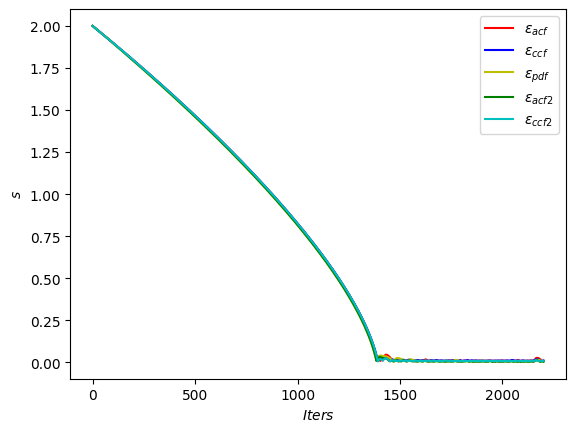

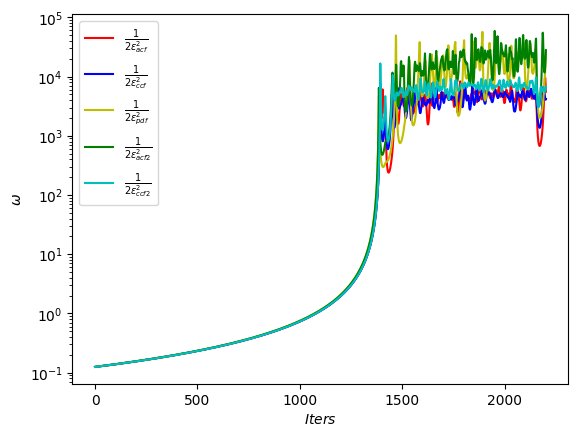

In [88]:
draw_adaptive_w(model4)
draw_epoch_w(model4)

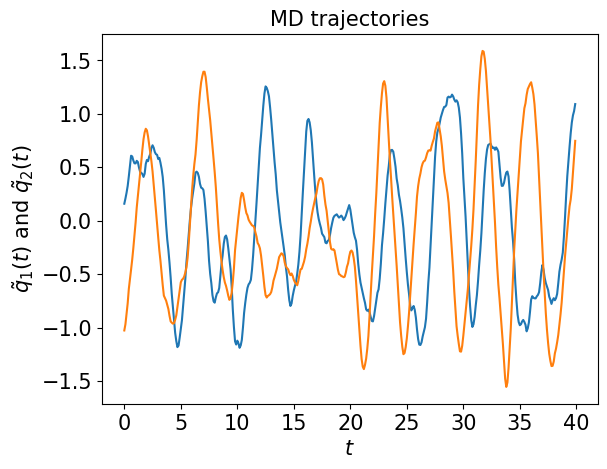

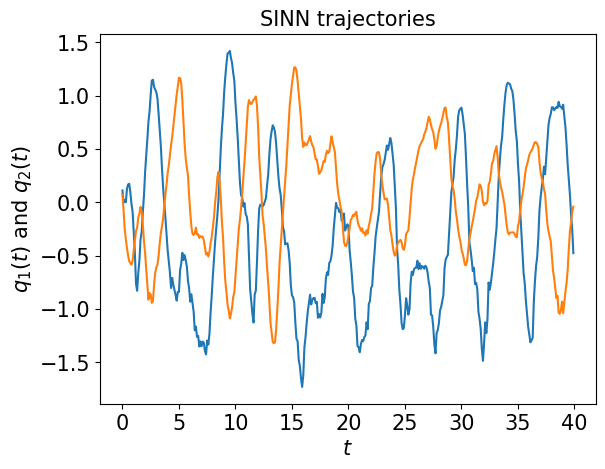

In [89]:
test1(model4)

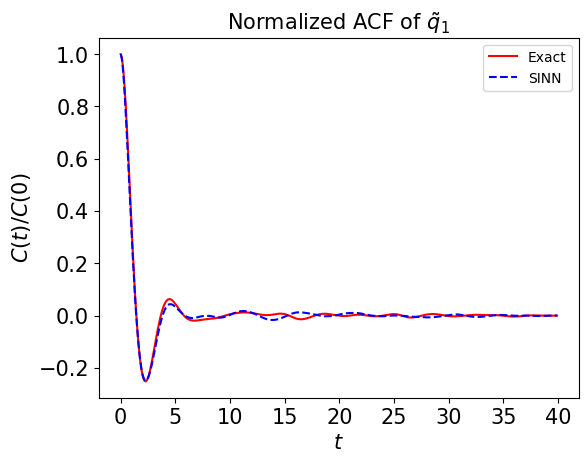

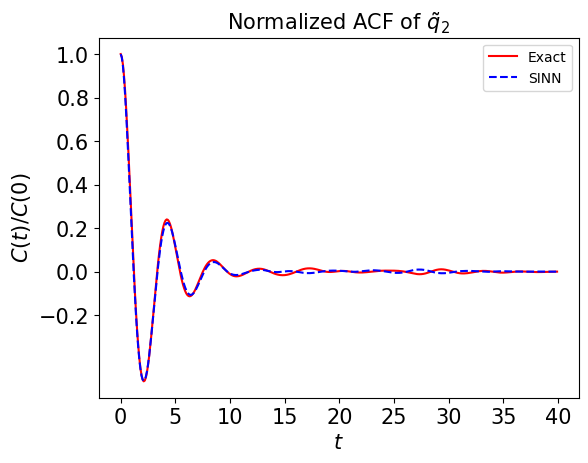

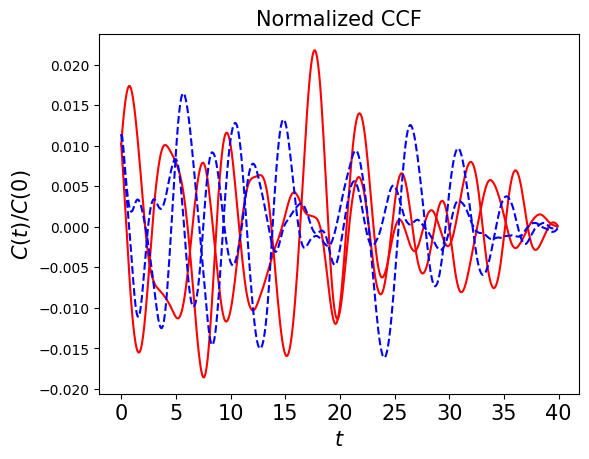

In [90]:
test2(model4)

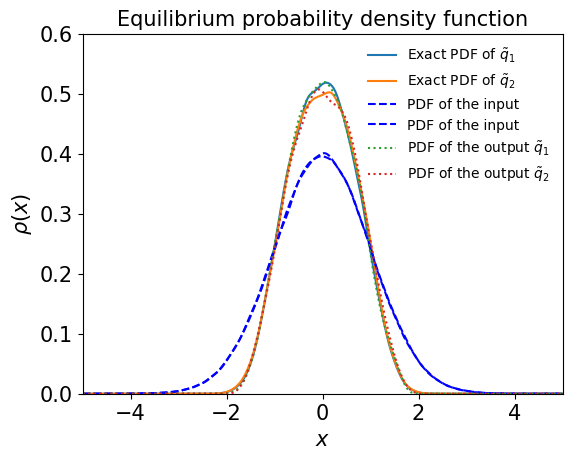

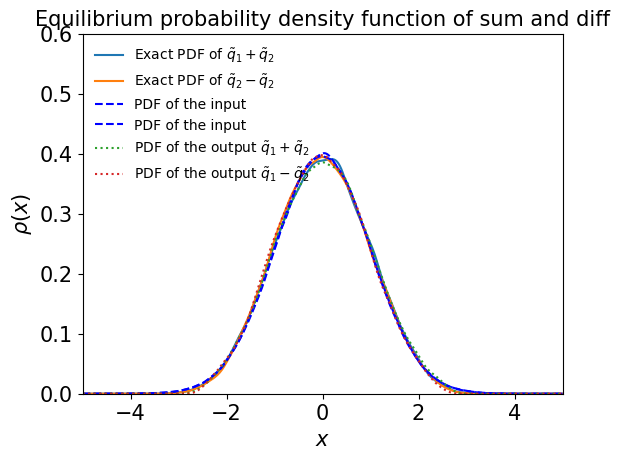

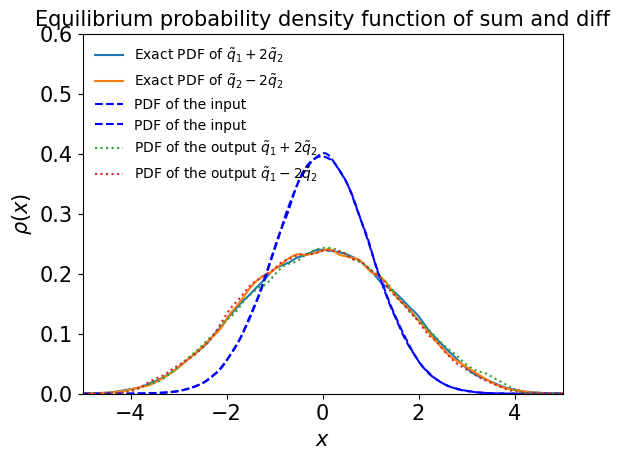

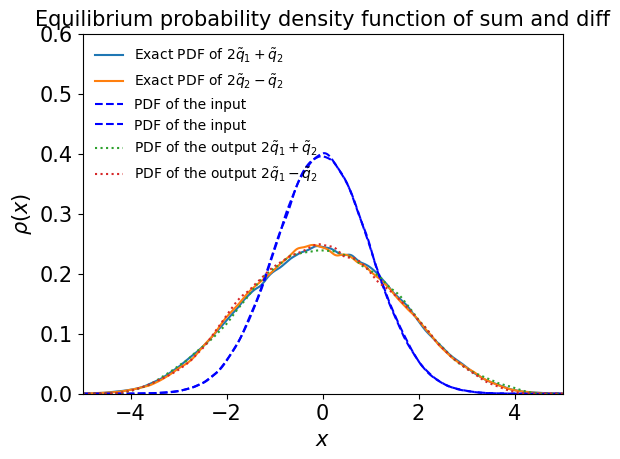

In [91]:
test3(model4)

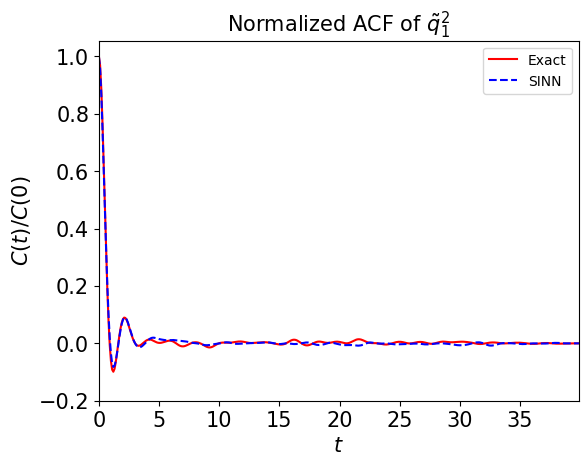

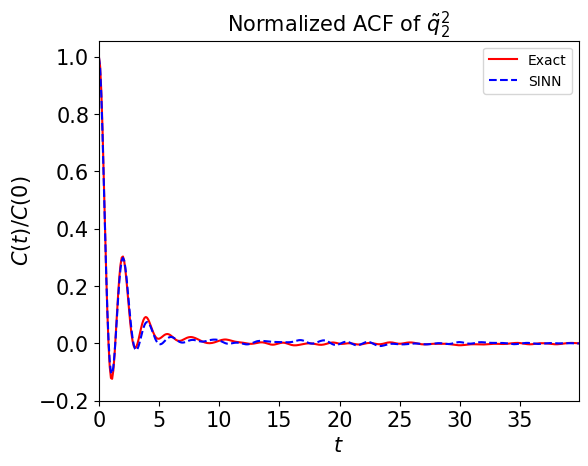

In [92]:
test4(model4)

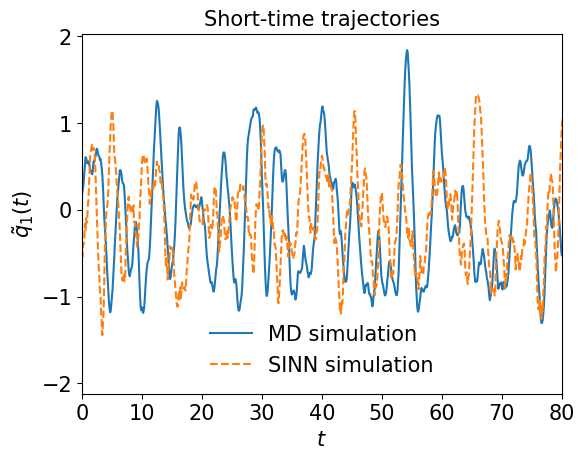

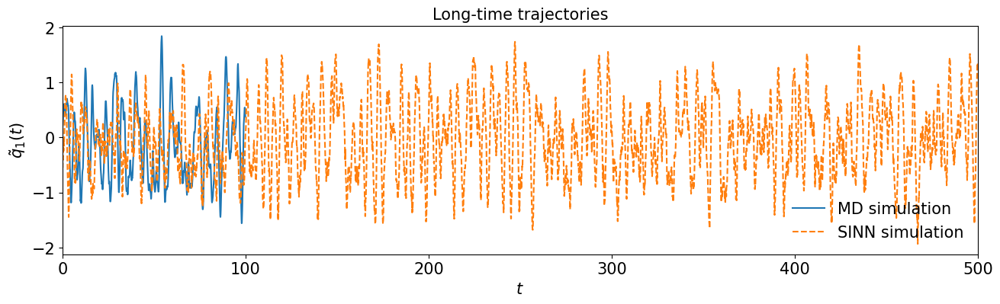

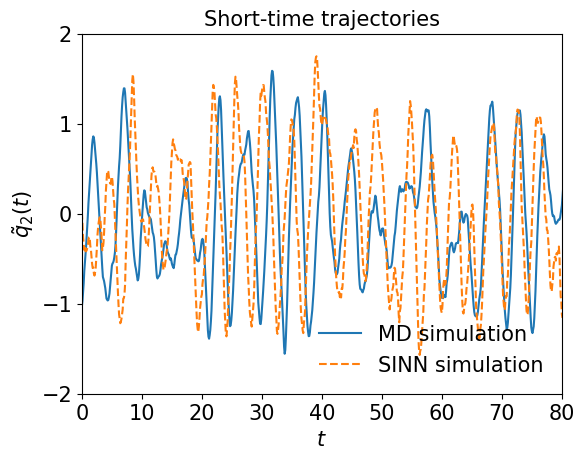

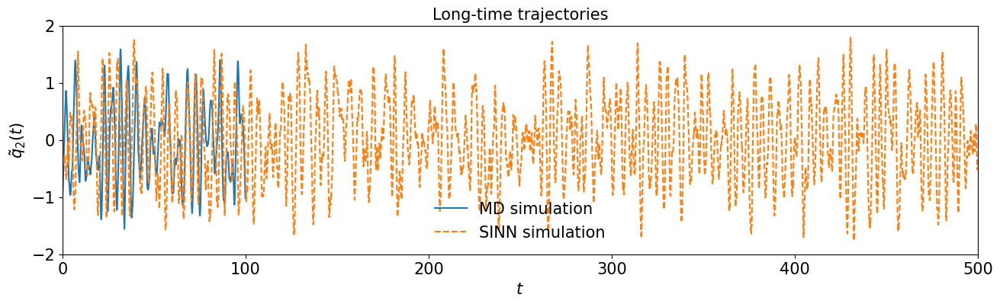

In [93]:
test5(model4)

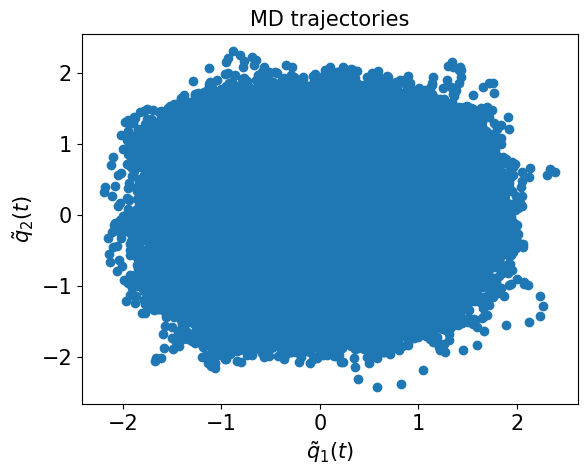

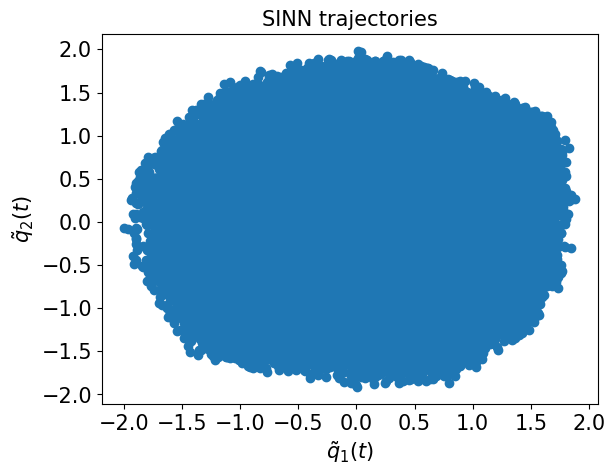

In [94]:
test6(model4)

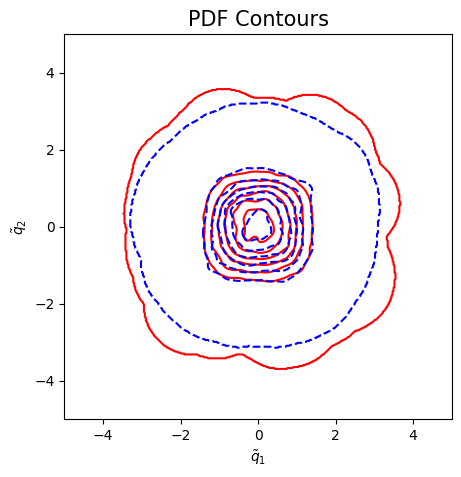

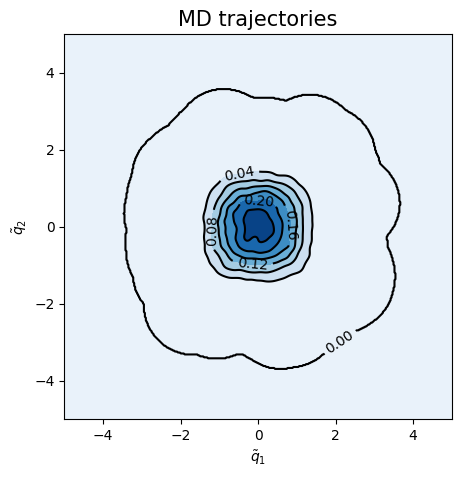

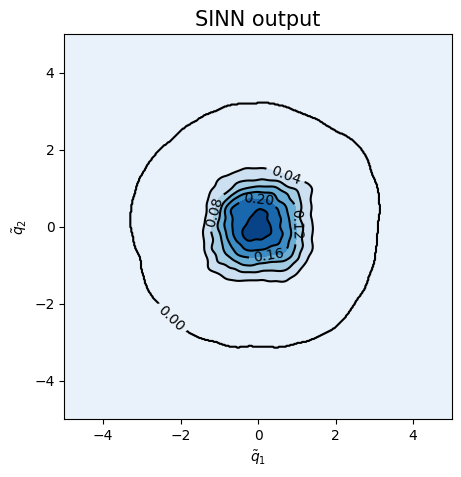

<Figure size 500x500 with 0 Axes>

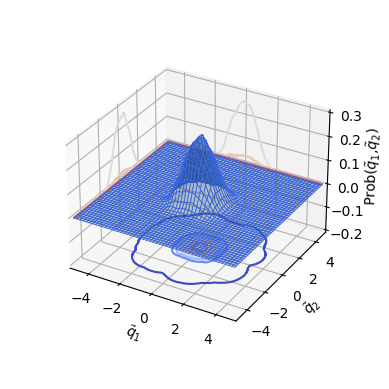

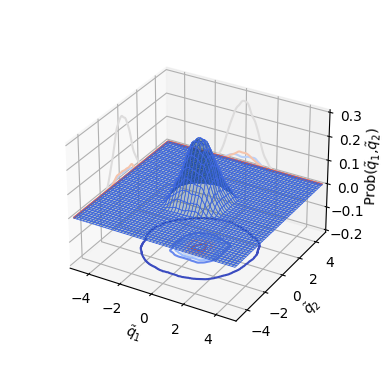

In [95]:
test7(model4)

In [96]:
### Defining SINN model
net5 = SINN(2, 10, 2, 2).to(device)

In [97]:
model5 = Model(net=net5)

In [98]:
model5.train()

[0]-th step loss: 0.5414, 0.5398, acf: 0.01360, ccf: 0.00171, pdf: 0.24788, pdf2: 0.27251, acf2: 0.00408
[50]-th step loss: 0.3927, 0.3833, acf: 0.00895, ccf: 0.00049, pdf: 0.20647, pdf2: 0.16523, acf2: 0.00219
[100]-th step loss: 0.1443, 0.1436, acf: 0.01122, ccf: 0.00034, pdf: 0.11882, pdf2: 0.01096, acf2: 0.00225
[150]-th step loss: 0.0195, 0.0194, acf: 0.00689, ccf: 0.00094, pdf: 0.00617, pdf2: 0.00325, acf2: 0.00220
[200]-th step loss: 0.0115, 0.0117, acf: 0.00523, ccf: 0.00194, pdf: 0.00169, pdf2: 0.00156, acf2: 0.00129
[250]-th step loss: 0.0097, 0.0097, acf: 0.00523, ccf: 0.00104, pdf: 0.00108, pdf2: 0.00113, acf2: 0.00123
[300]-th step loss: 0.0078, 0.0080, acf: 0.00481, ccf: 0.00054, pdf: 0.00072, pdf2: 0.00078, acf2: 0.00120
[350]-th step loss: 0.0062, 0.0062, acf: 0.00363, ccf: 0.00039, pdf: 0.00042, pdf2: 0.00056, acf2: 0.00118
[400]-th step loss: 0.0028, 0.0029, acf: 0.00104, ccf: 0.00039, pdf: 0.00018, pdf2: 0.00051, acf2: 0.00075
[450]-th step loss: 0.0017, 0.0019, acf:

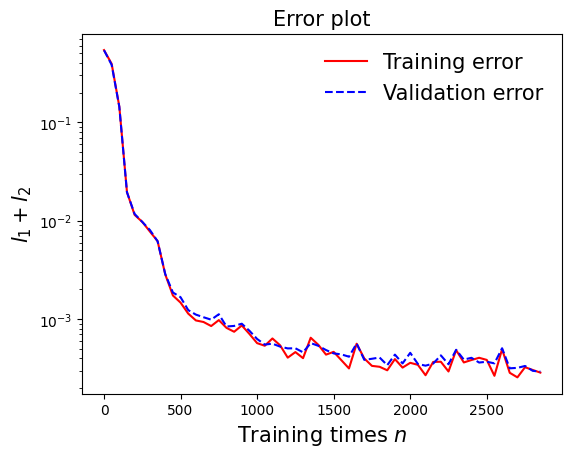

In [99]:
draw_loss(model5)

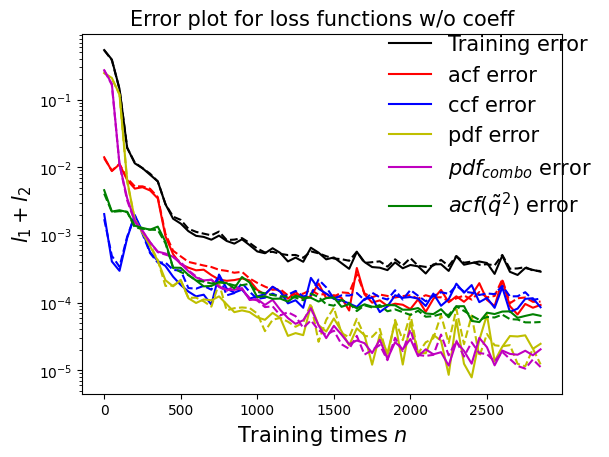

In [100]:
draw_errors(model5)

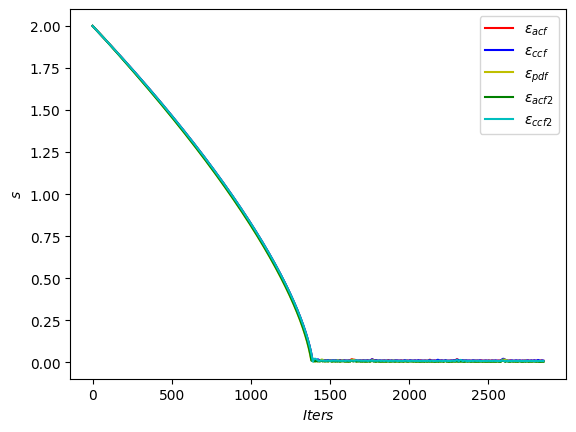

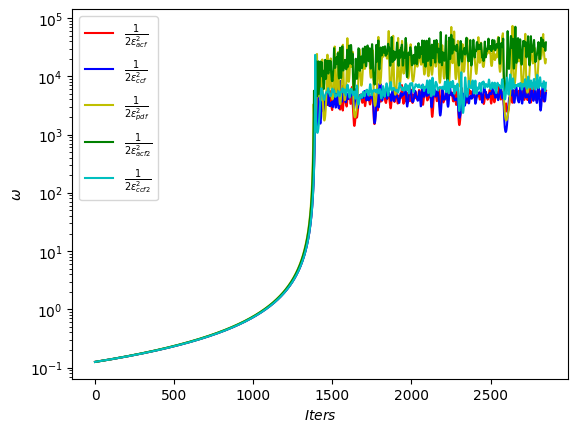

In [101]:
draw_adaptive_w(model5)
draw_epoch_w(model5)

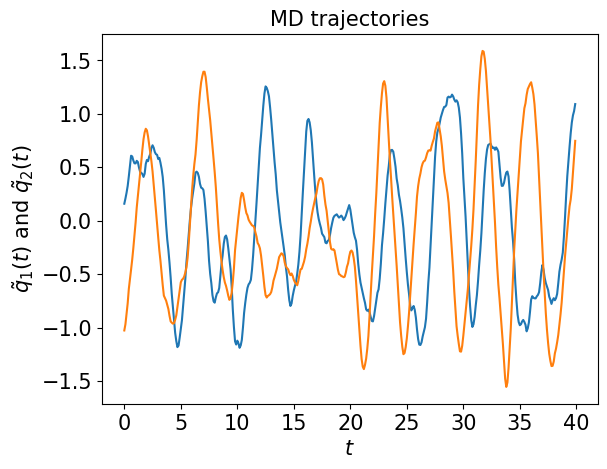

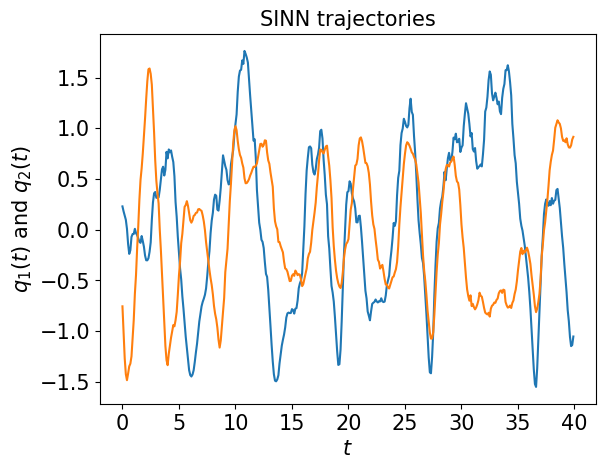

In [102]:
test1(model5)

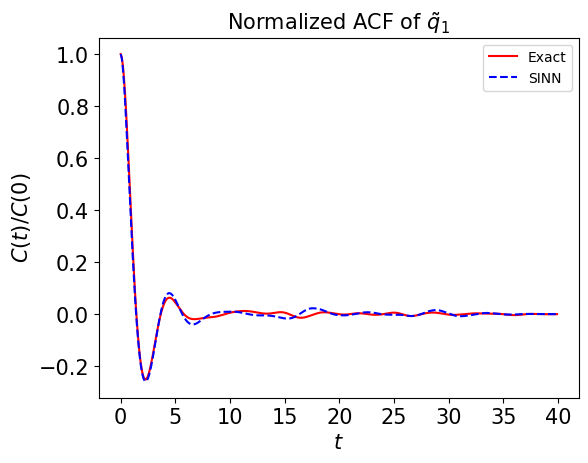

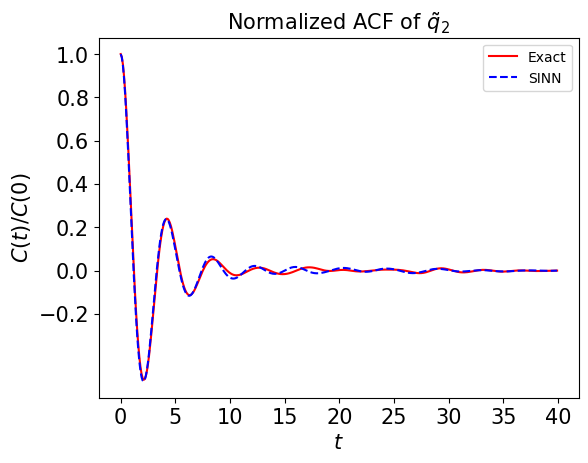

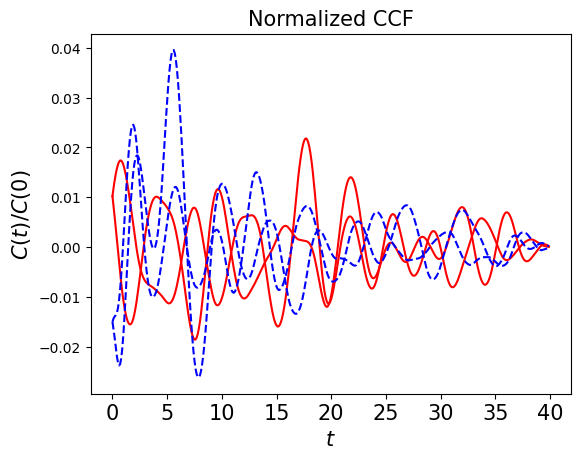

In [103]:
test2(model5)

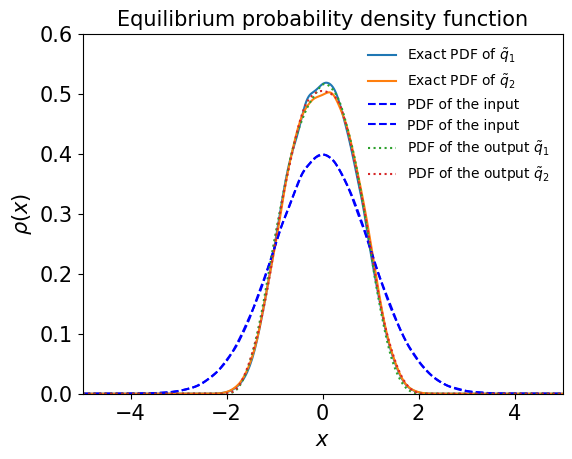

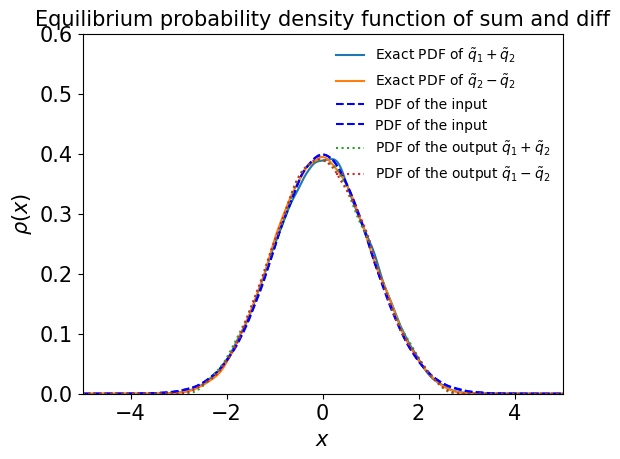

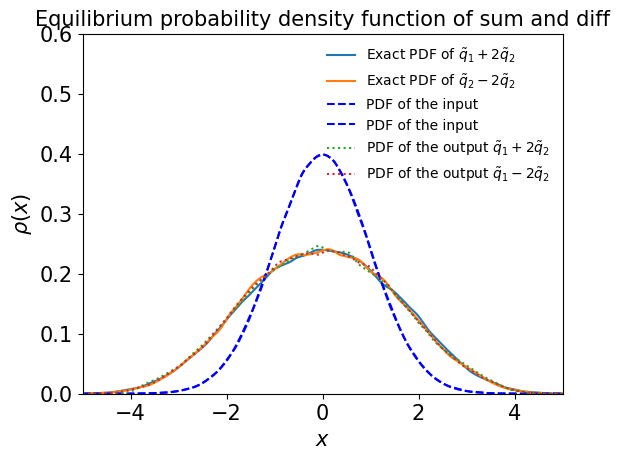

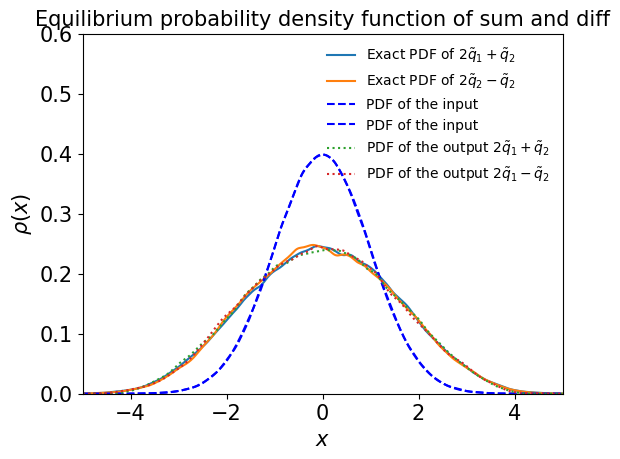

In [104]:
test3(model5)

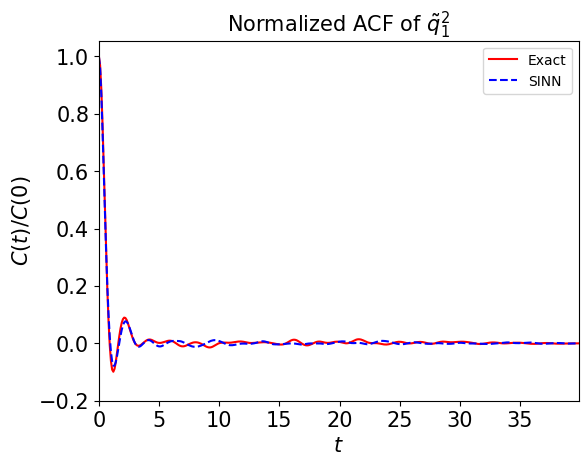

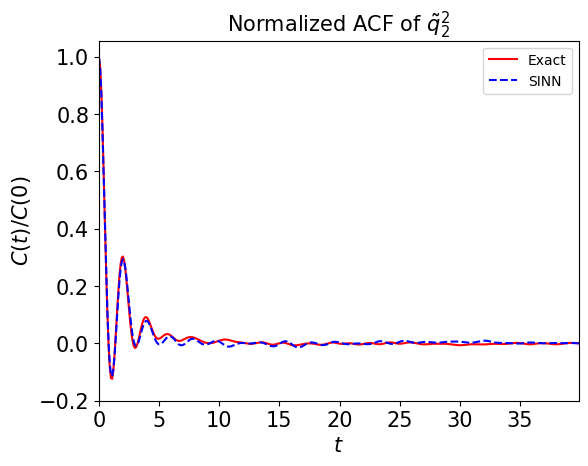

In [105]:
test4(model5)

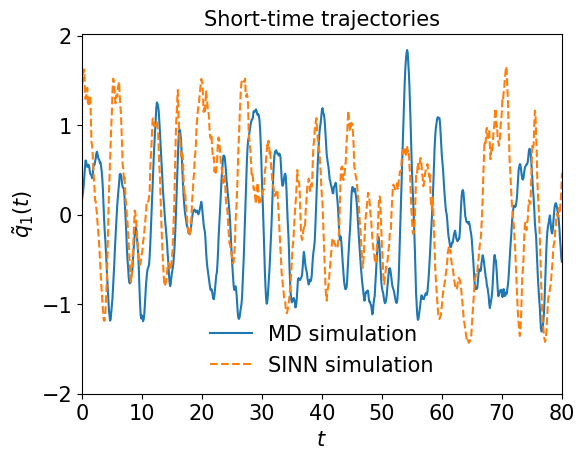

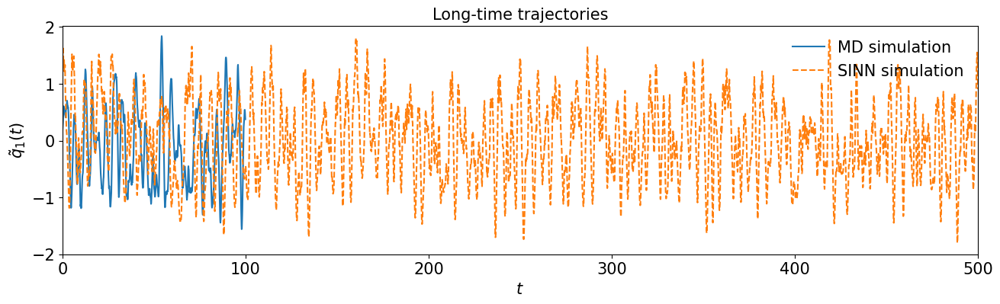

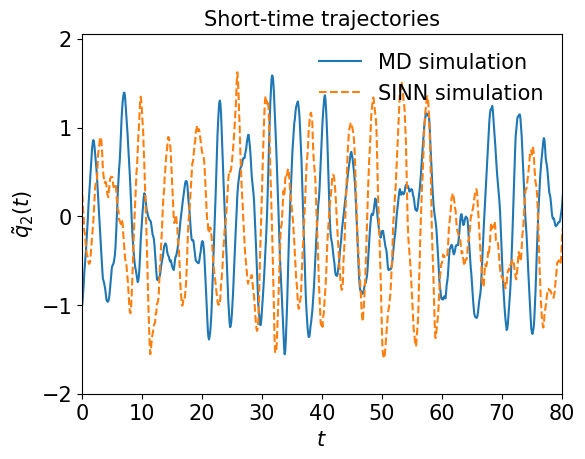

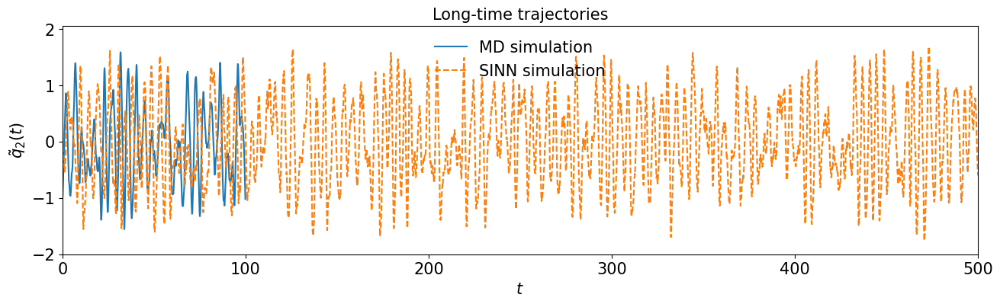

In [106]:
test5(model5)

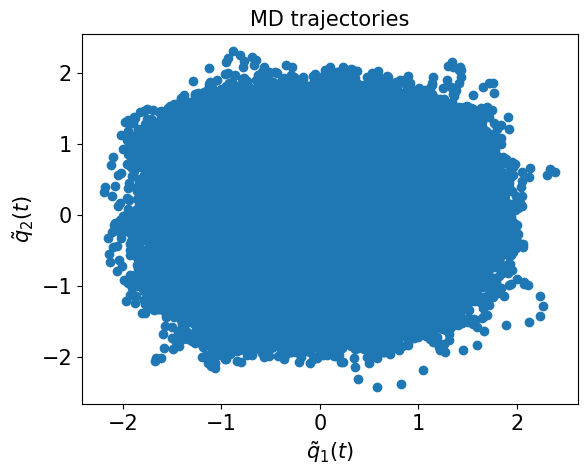

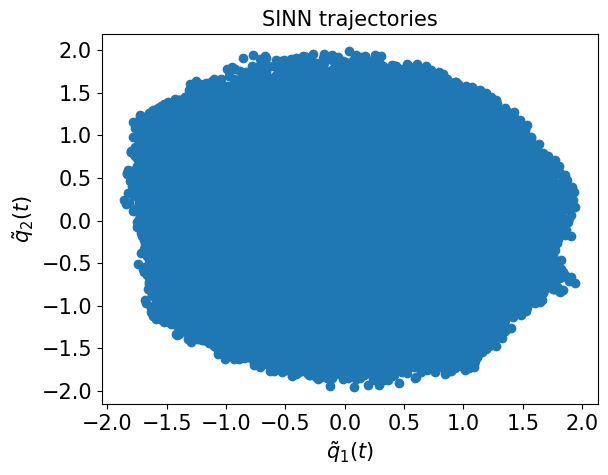

In [107]:
test6(model5)

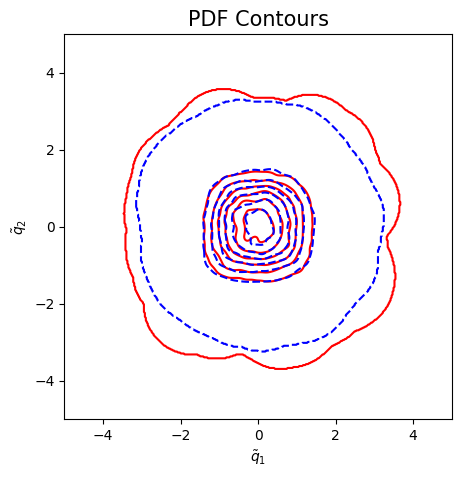

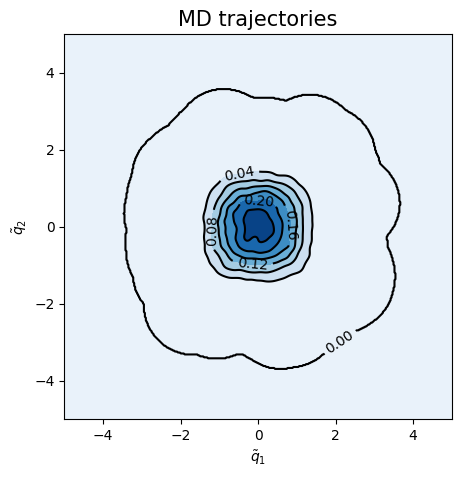

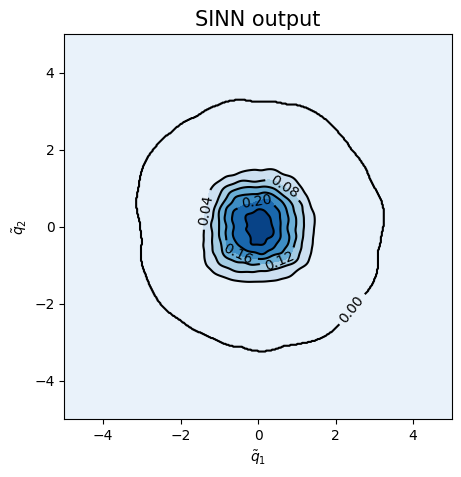

<Figure size 500x500 with 0 Axes>

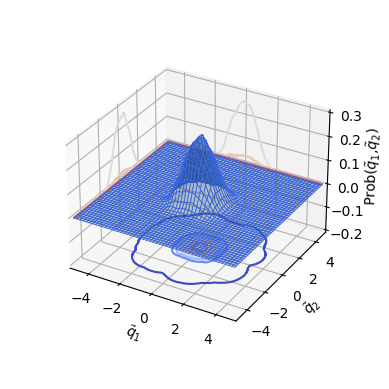

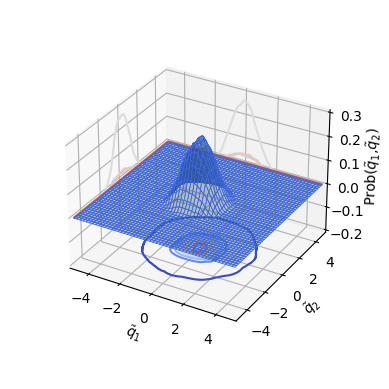

In [108]:
test7(model5)

In [109]:
### Defining SINN model
net6 = SINN(2, 10, 2, 2).to(device)

In [110]:
model6 = Model(net=net6)

In [111]:
model6.train()

[0]-th step loss: 0.5351, 0.5342, acf: 0.01026, ccf: 0.00462, pdf: 0.24770, pdf2: 0.26944, acf2: 0.00216
[50]-th step loss: 0.2866, 0.2743, acf: 0.00664, ccf: 0.00931, pdf: 0.14114, pdf2: 0.11514, acf2: 0.00203
[100]-th step loss: 0.0548, 0.0537, acf: 0.00563, ccf: 0.01092, pdf: 0.01788, pdf2: 0.01697, acf2: 0.00232
[150]-th step loss: 0.0190, 0.0191, acf: 0.00346, ccf: 0.00746, pdf: 0.00231, pdf2: 0.00406, acf2: 0.00180
[200]-th step loss: 0.0145, 0.0146, acf: 0.00462, ccf: 0.00470, pdf: 0.00134, pdf2: 0.00256, acf2: 0.00137
[250]-th step loss: 0.0120, 0.0120, acf: 0.00518, ccf: 0.00305, pdf: 0.00082, pdf2: 0.00177, acf2: 0.00123
[300]-th step loss: 0.0099, 0.0101, acf: 0.00547, ccf: 0.00172, pdf: 0.00052, pdf2: 0.00124, acf2: 0.00117
[350]-th step loss: 0.0084, 0.0085, acf: 0.00533, ccf: 0.00082, pdf: 0.00030, pdf2: 0.00093, acf2: 0.00113
[400]-th step loss: 0.0065, 0.0065, acf: 0.00414, ccf: 0.00051, pdf: 0.00017, pdf2: 0.00064, acf2: 0.00103
[450]-th step loss: 0.0027, 0.0029, acf:

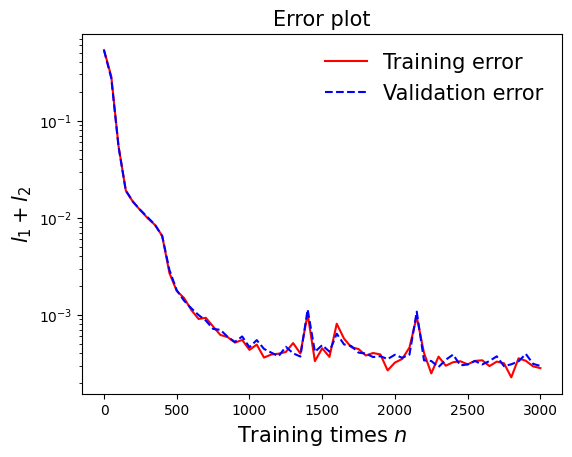

In [112]:
draw_loss(model6)

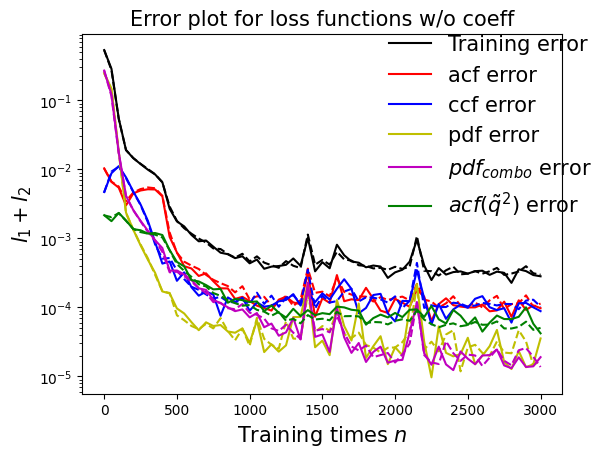

In [113]:
draw_errors(model6)

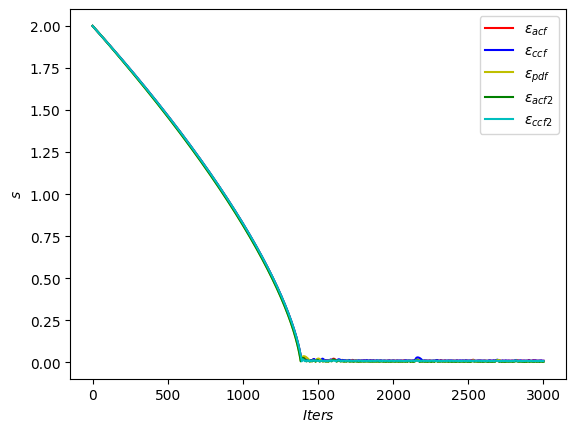

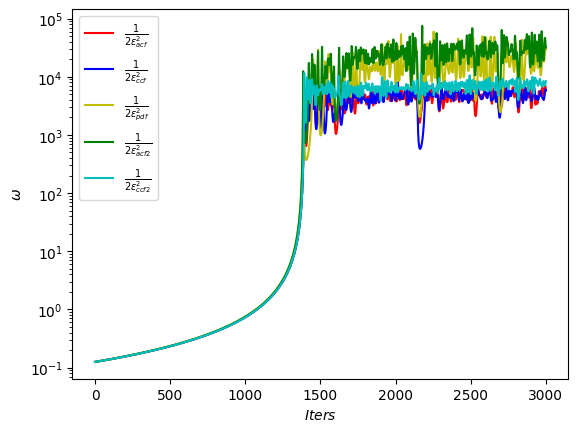

In [114]:
draw_adaptive_w(model6)
draw_epoch_w(model6)

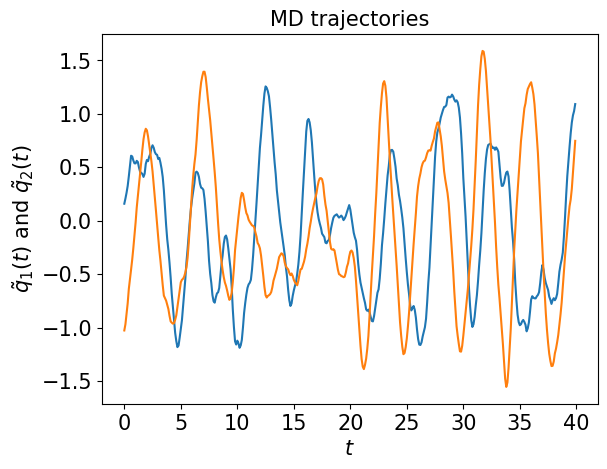

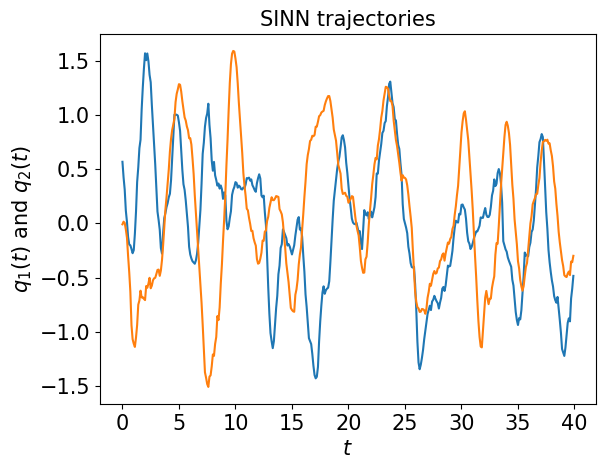

In [115]:
test1(model6)

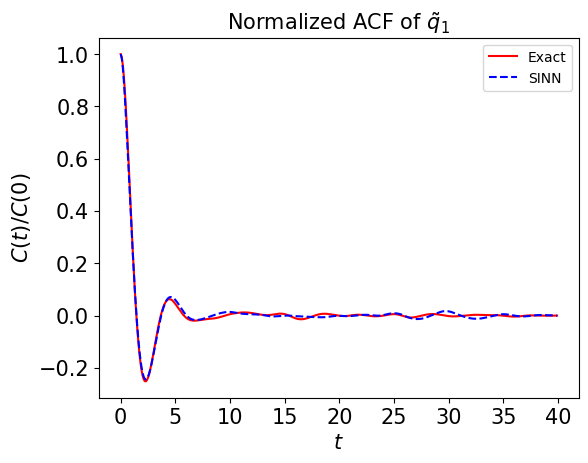

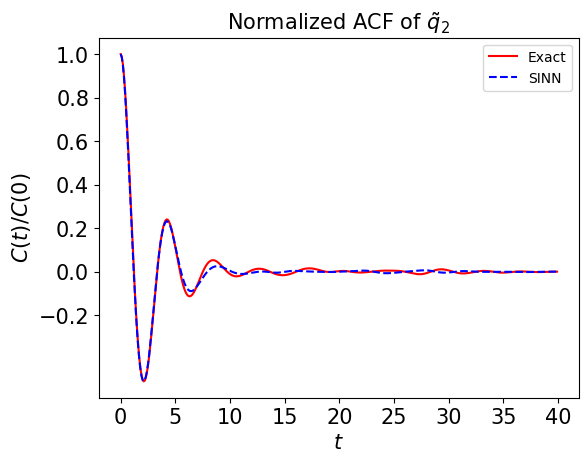

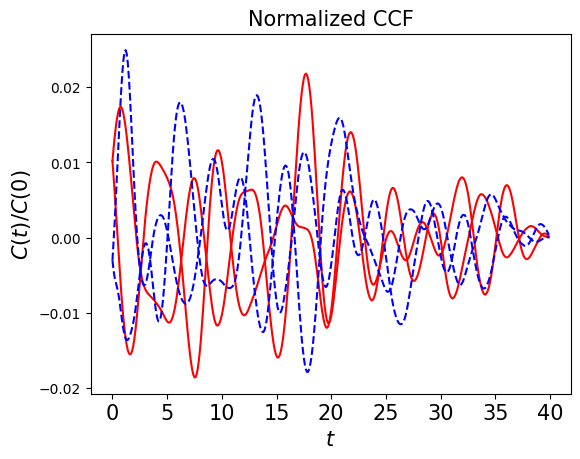

In [116]:
test2(model6)

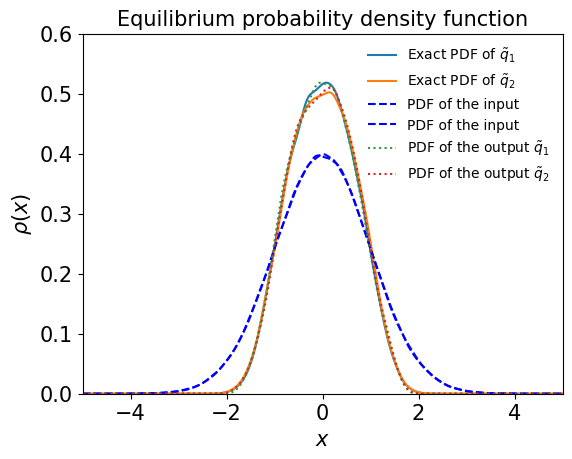

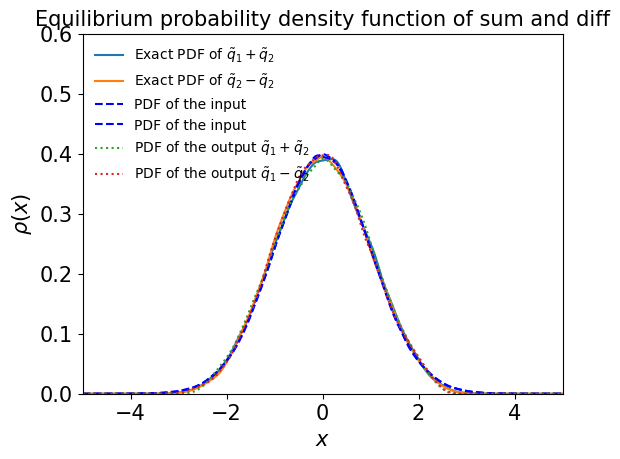

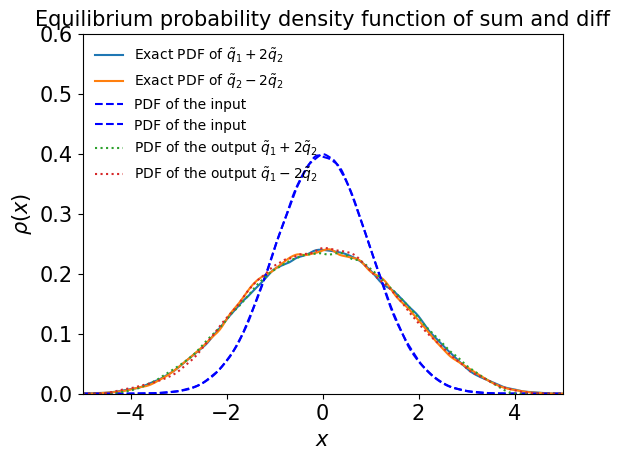

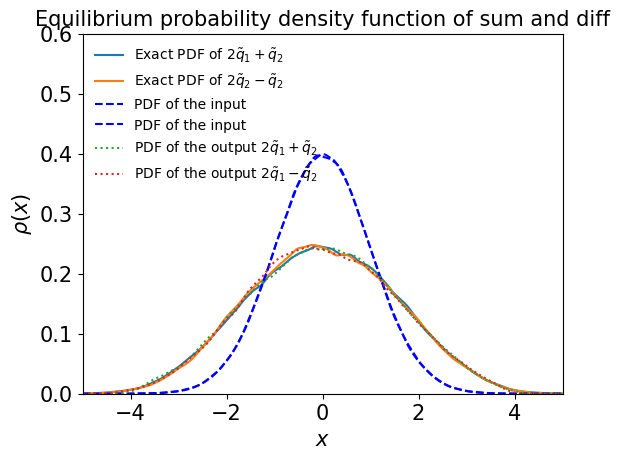

In [117]:
test3(model6)

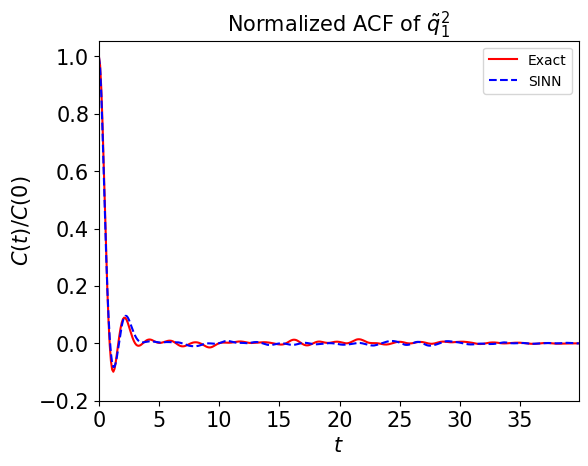

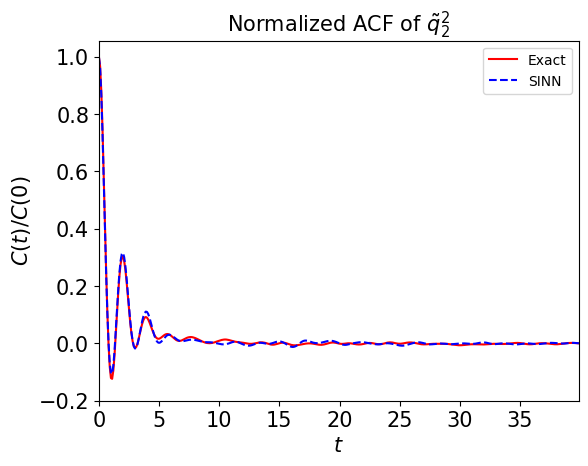

In [118]:
test4(model6)

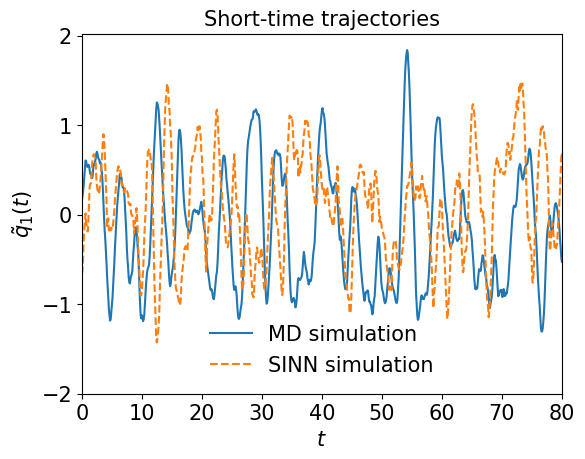

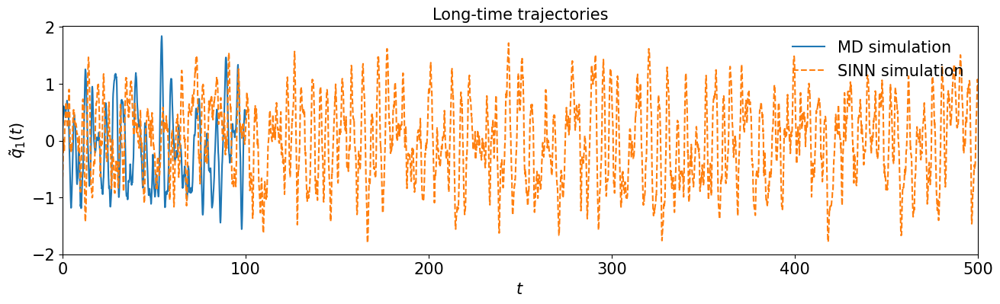

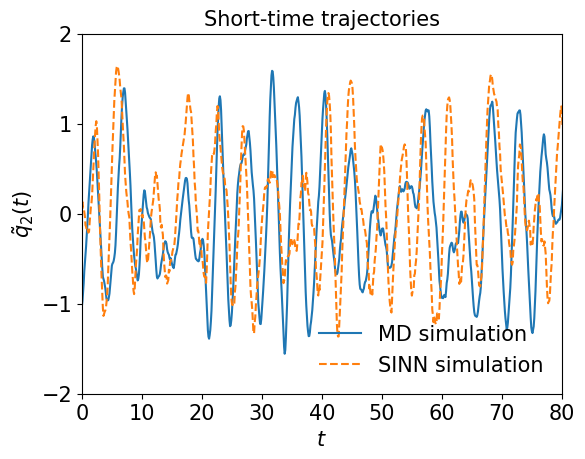

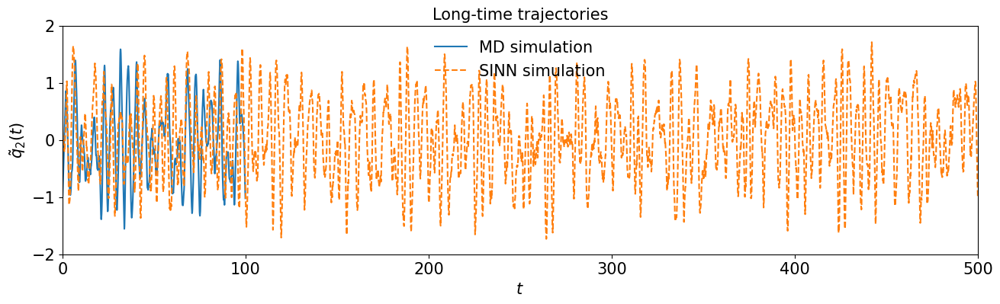

In [119]:
test5(model6)

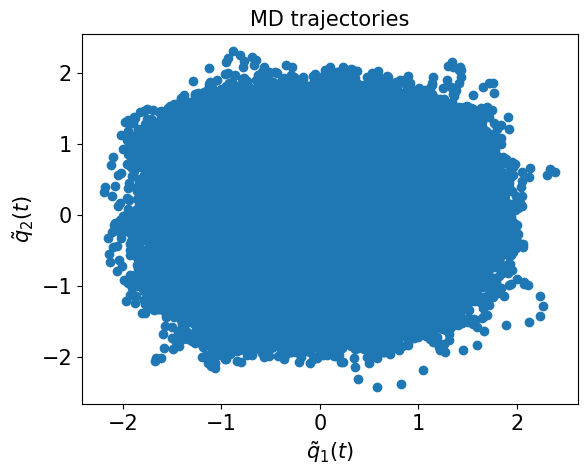

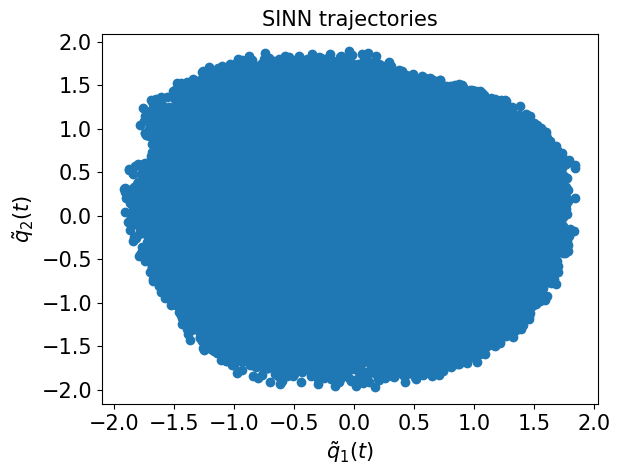

In [120]:
test6(model6)

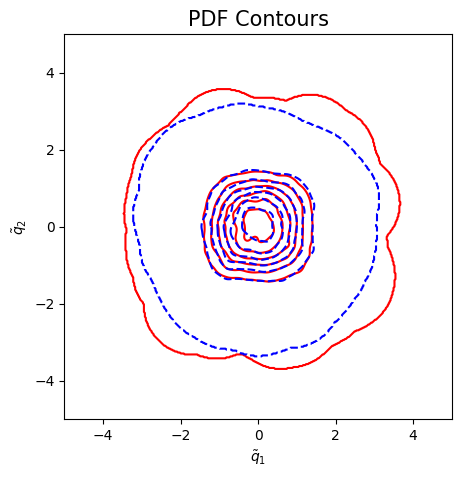

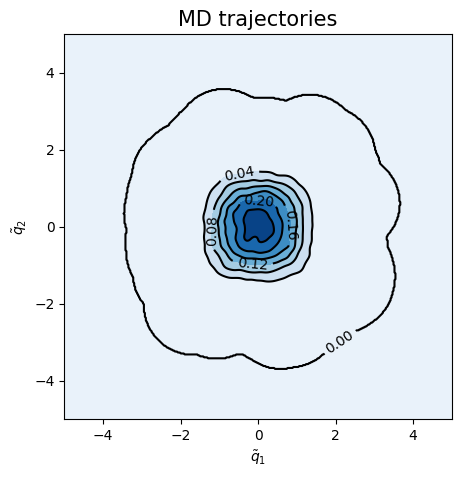

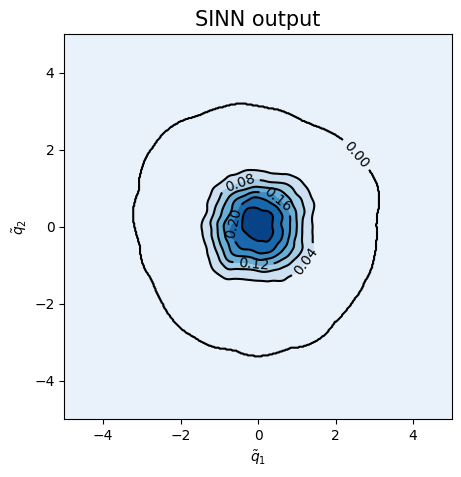

<Figure size 500x500 with 0 Axes>

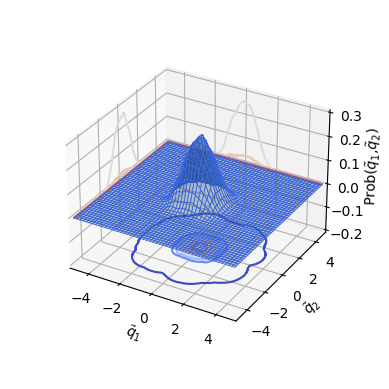

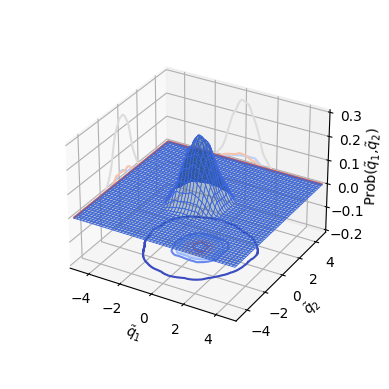

In [121]:
test7(model6)

In [122]:
### Defining SINN model
net7 = SINN(2, 10, 2, 2).to(device)

In [123]:
model7 = Model(net=net7)

In [124]:
model7.train()

[0]-th step loss: 0.5344, 0.5328, acf: 0.01041, ccf: 0.00181, pdf: 0.24817, pdf2: 0.27018, acf2: 0.00225
[50]-th step loss: 0.2488, 0.2391, acf: 0.00682, ccf: 0.00027, pdf: 0.15607, pdf2: 0.07388, acf2: 0.00206
[100]-th step loss: 0.0797, 0.0772, acf: 0.00930, ccf: 0.00068, pdf: 0.04597, pdf2: 0.01705, acf2: 0.00416
[150]-th step loss: 0.0267, 0.0265, acf: 0.00520, ccf: 0.00075, pdf: 0.01068, pdf2: 0.00785, acf2: 0.00203
[200]-th step loss: 0.0122, 0.0120, acf: 0.00402, ccf: 0.00174, pdf: 0.00223, pdf2: 0.00262, acf2: 0.00137
[250]-th step loss: 0.0078, 0.0078, acf: 0.00273, ccf: 0.00150, pdf: 0.00111, pdf2: 0.00144, acf2: 0.00107
[300]-th step loss: 0.0047, 0.0047, acf: 0.00151, ccf: 0.00055, pdf: 0.00076, pdf2: 0.00101, acf2: 0.00086
[350]-th step loss: 0.0031, 0.0031, acf: 0.00095, ccf: 0.00022, pdf: 0.00049, pdf2: 0.00079, acf2: 0.00068
[400]-th step loss: 0.0020, 0.0019, acf: 0.00046, ccf: 0.00016, pdf: 0.00024, pdf2: 0.00059, acf2: 0.00046
[450]-th step loss: 0.0013, 0.0013, acf:

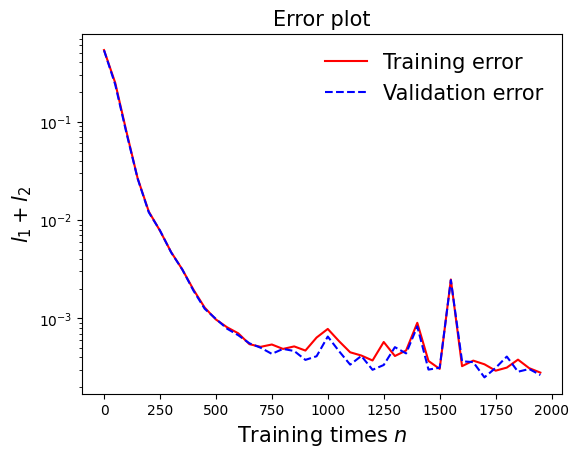

In [125]:
draw_loss(model7)

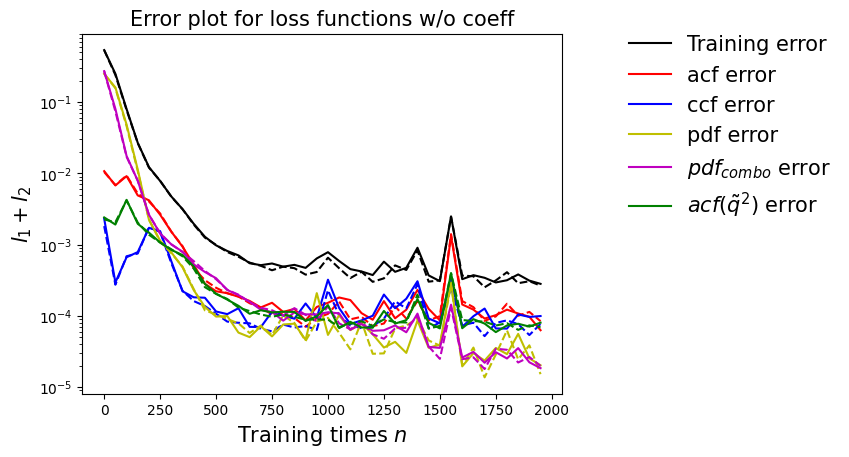

In [126]:
draw_errors(model7)

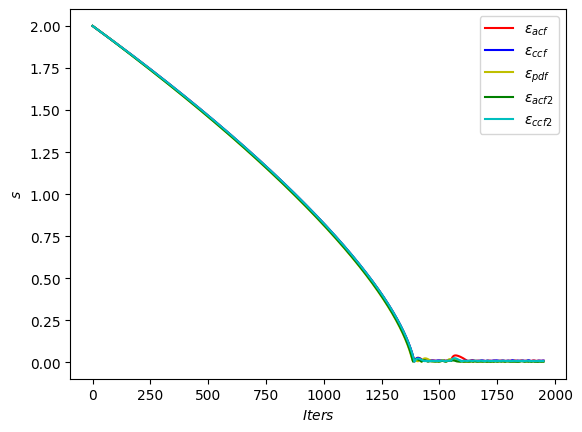

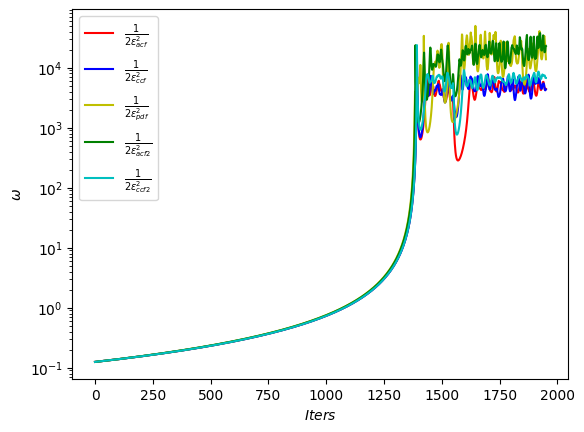

In [127]:
draw_adaptive_w(model7)
draw_epoch_w(model7)

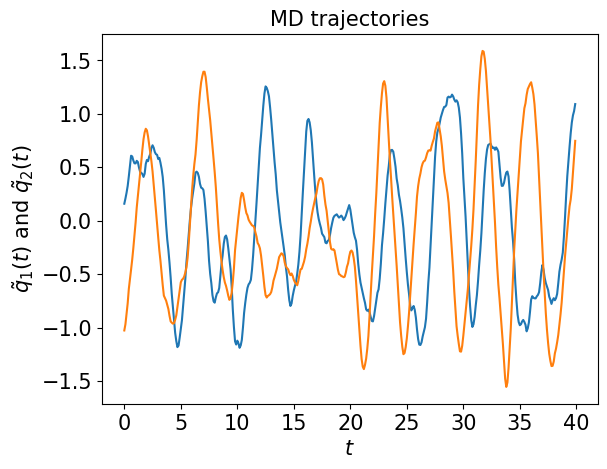

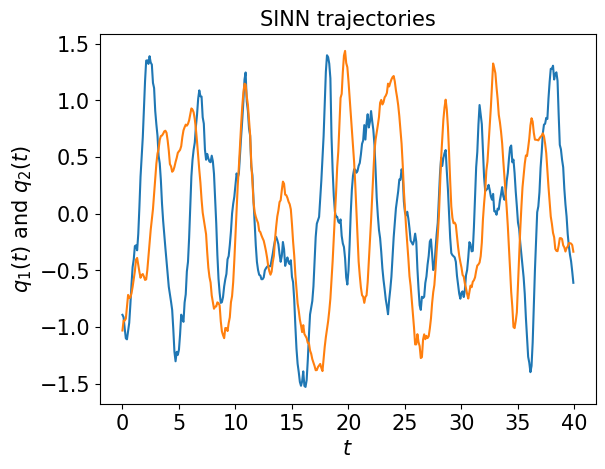

In [128]:
test1(model7)

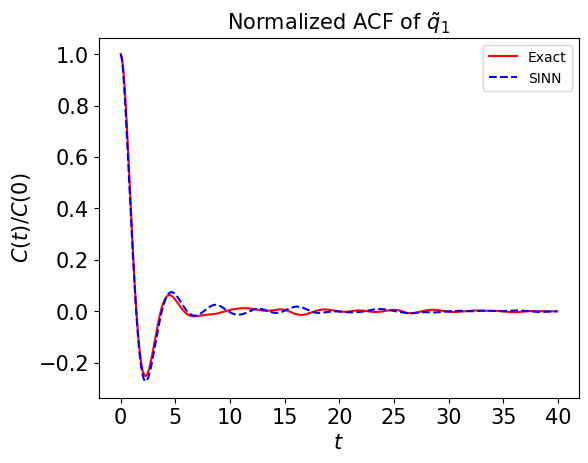

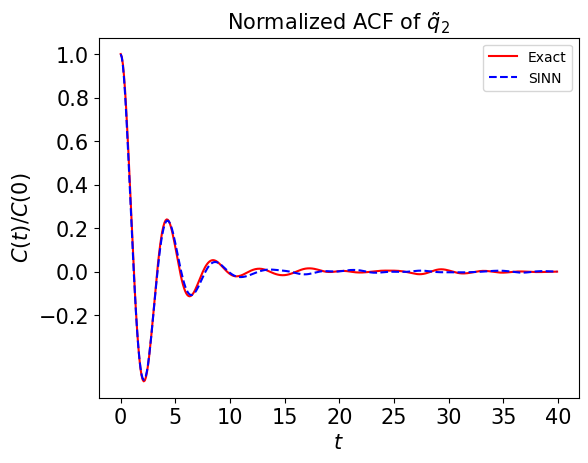

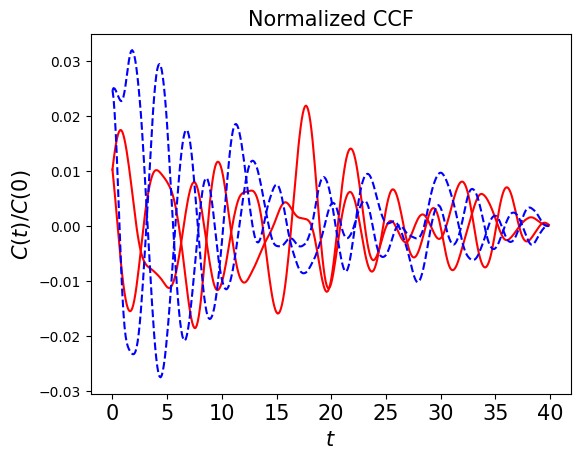

In [129]:
test2(model7)

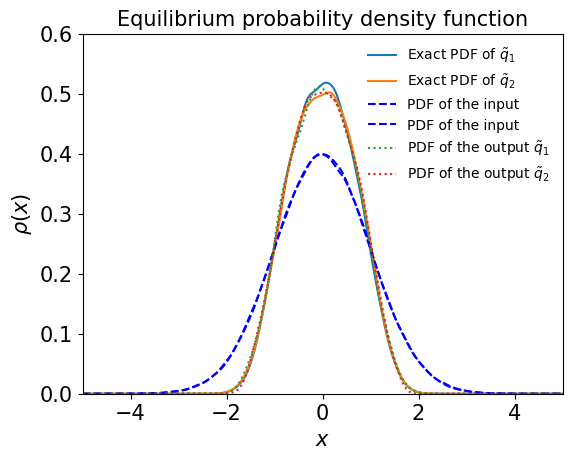

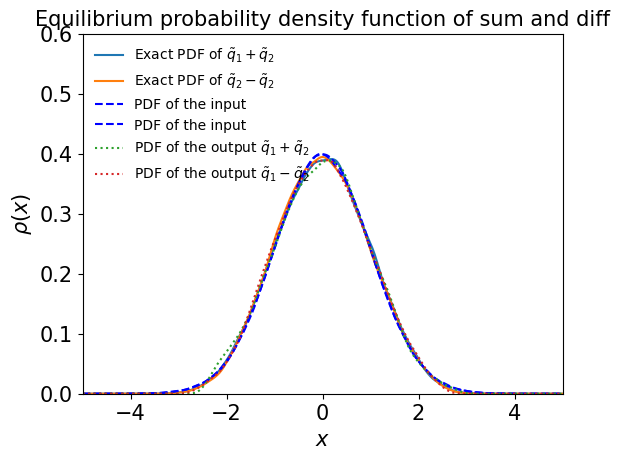

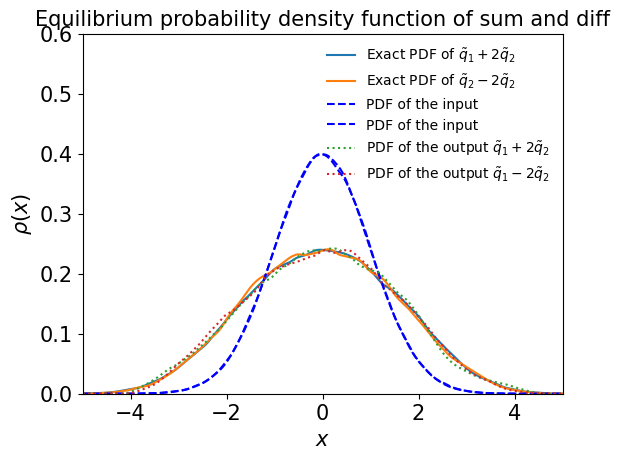

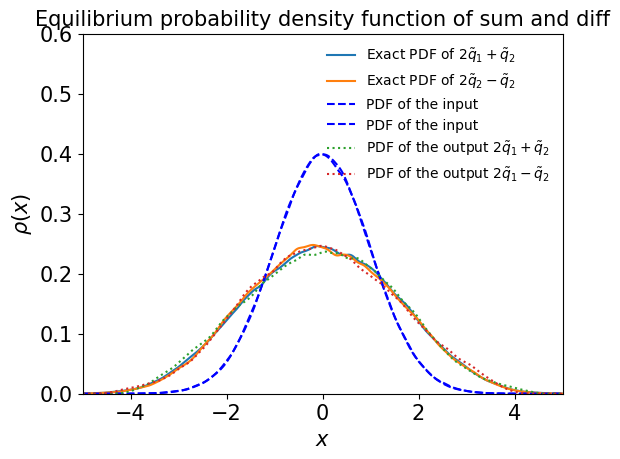

In [130]:
test3(model7)

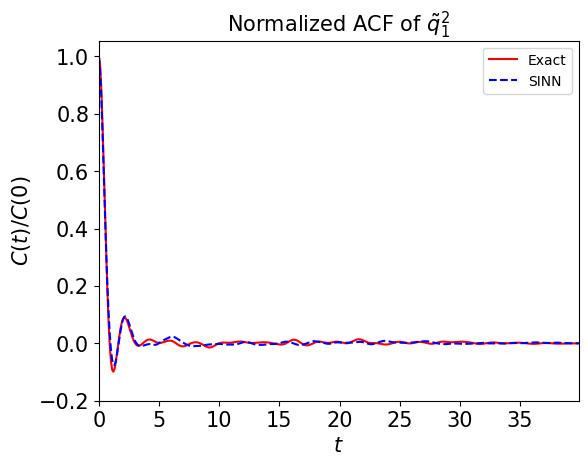

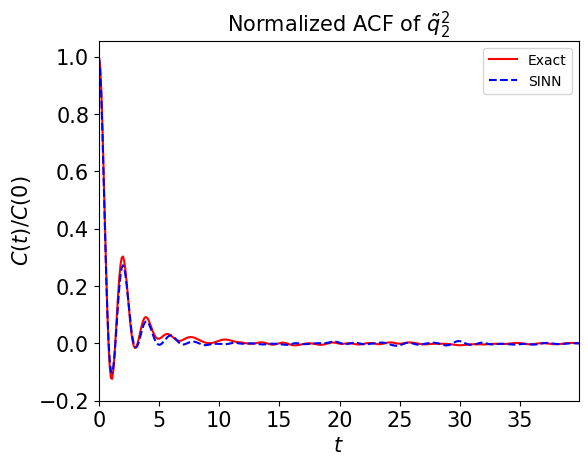

In [131]:
test4(model7)

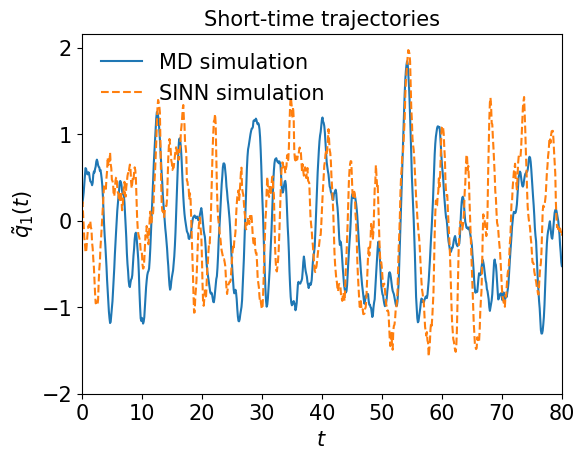

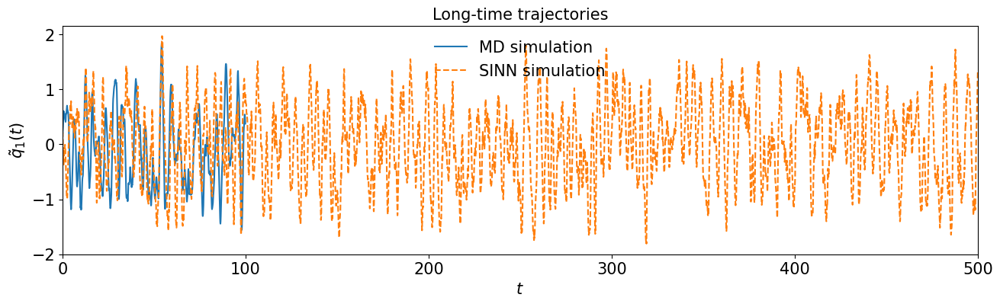

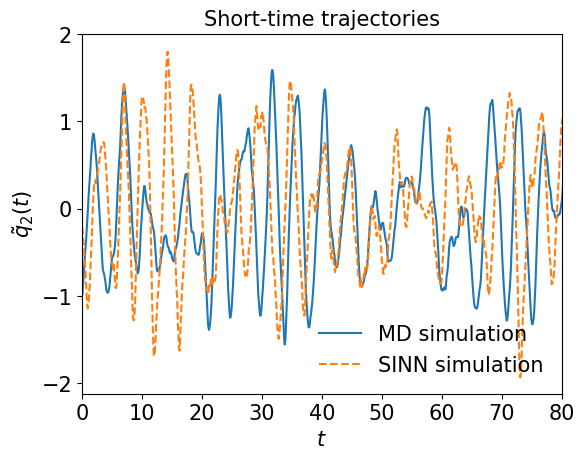

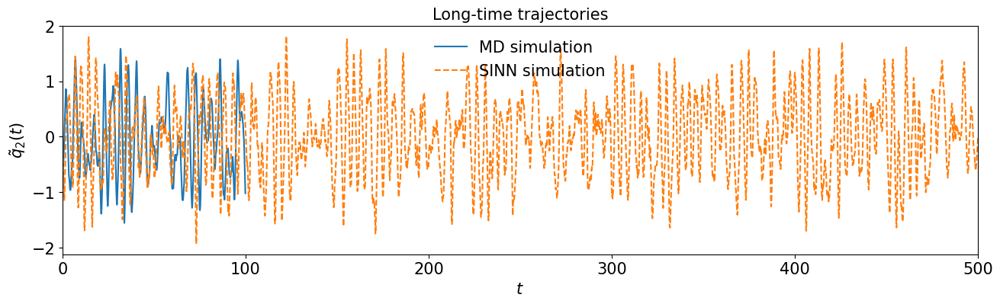

In [132]:
test5(model7)

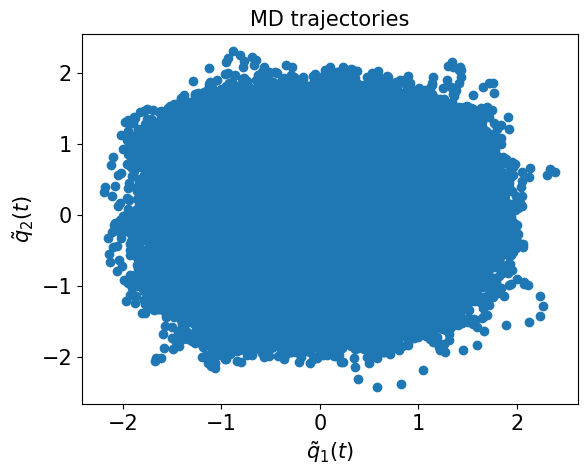

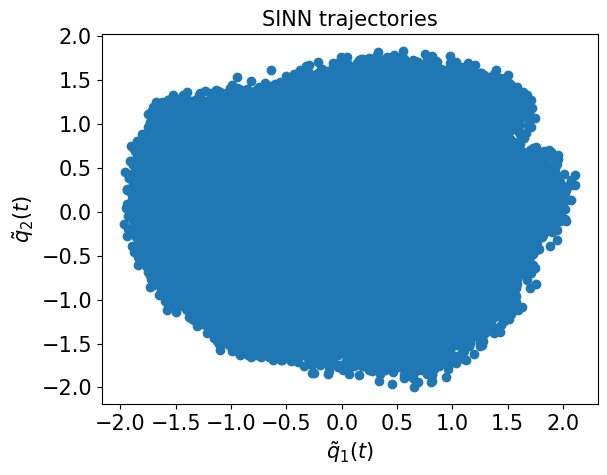

In [133]:
test6(model7)

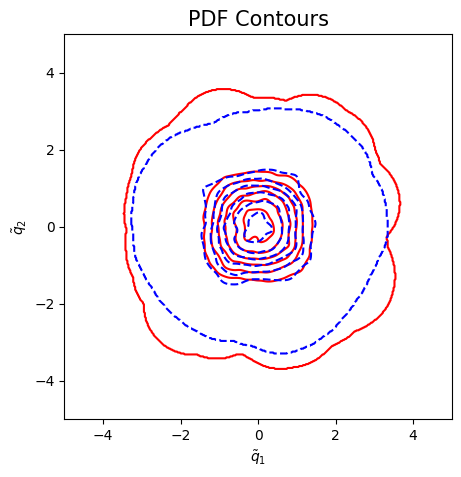

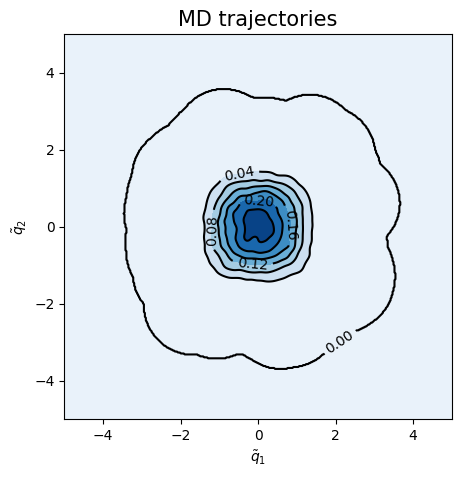

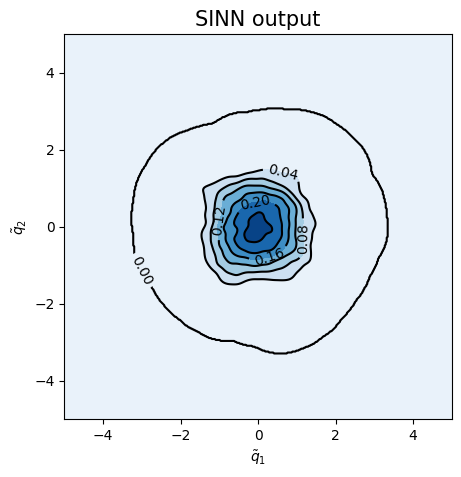

<Figure size 500x500 with 0 Axes>

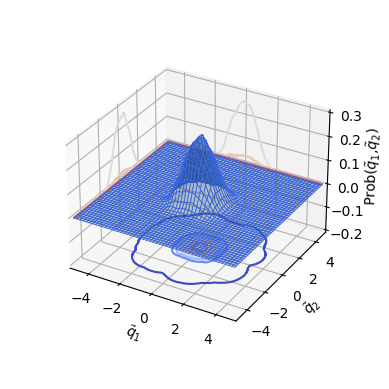

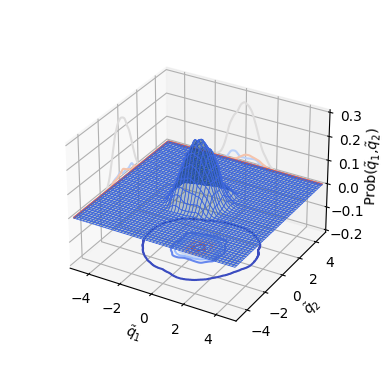

In [134]:
test7(model7)

In [135]:
### Defining SINN model
net8 = SINN(2, 10, 2, 2).to(device)

In [136]:
model8 = Model(net=net8)

In [137]:
model8.train()

[0]-th step loss: 0.5424, 0.5413, acf: 0.01533, ccf: 0.00068, pdf: 0.24796, pdf2: 0.27200, acf2: 0.00529
[50]-th step loss: 0.3839, 0.3722, acf: 0.00729, ccf: 0.00043, pdf: 0.20203, pdf2: 0.16094, acf2: 0.00149
[100]-th step loss: 0.0406, 0.0394, acf: 0.00522, ccf: 0.00723, pdf: 0.01645, pdf2: 0.00779, acf2: 0.00273
[150]-th step loss: 0.0221, 0.0216, acf: 0.00258, ccf: 0.00706, pdf: 0.00680, pdf2: 0.00358, acf2: 0.00157
[200]-th step loss: 0.0159, 0.0158, acf: 0.00350, ccf: 0.00480, pdf: 0.00386, pdf2: 0.00244, acf2: 0.00115
[250]-th step loss: 0.0115, 0.0116, acf: 0.00359, ccf: 0.00315, pdf: 0.00213, pdf2: 0.00180, acf2: 0.00096
[300]-th step loss: 0.0072, 0.0071, acf: 0.00211, ccf: 0.00159, pdf: 0.00123, pdf2: 0.00115, acf2: 0.00100
[350]-th step loss: 0.0034, 0.0035, acf: 0.00062, ccf: 0.00055, pdf: 0.00071, pdf2: 0.00087, acf2: 0.00074
[400]-th step loss: 0.0022, 0.0021, acf: 0.00030, ccf: 0.00026, pdf: 0.00041, pdf2: 0.00058, acf2: 0.00058
[450]-th step loss: 0.0017, 0.0016, acf:

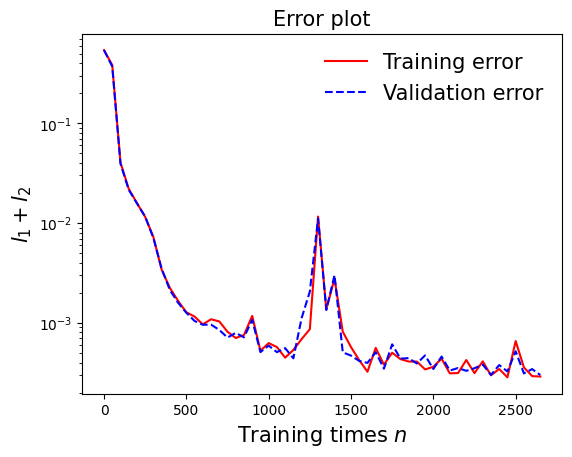

In [138]:
draw_loss(model8)

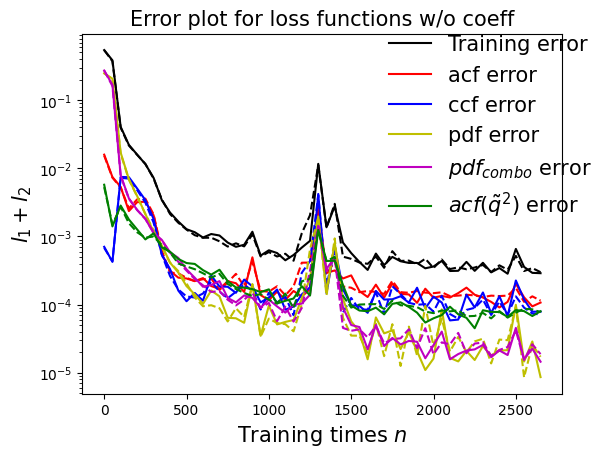

In [139]:
draw_errors(model8)

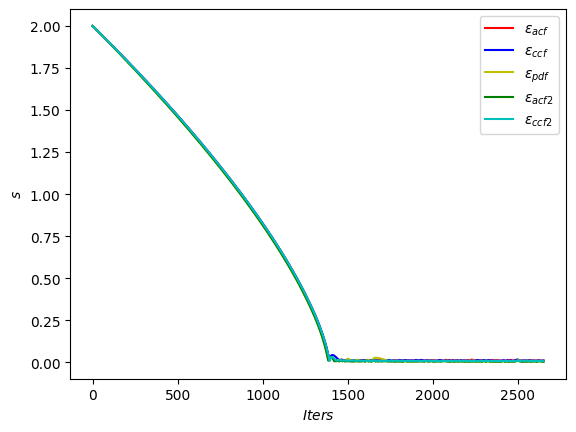

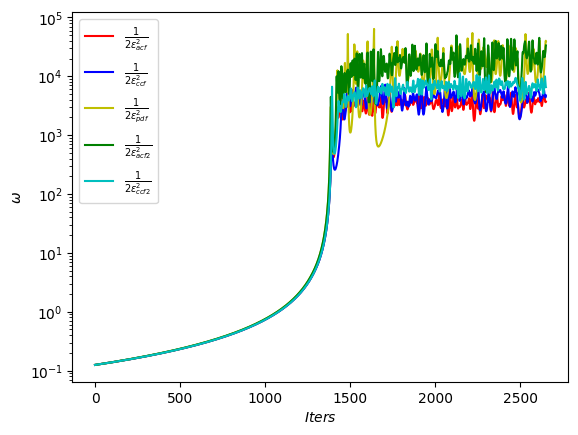

In [140]:
draw_adaptive_w(model8)
draw_epoch_w(model8)

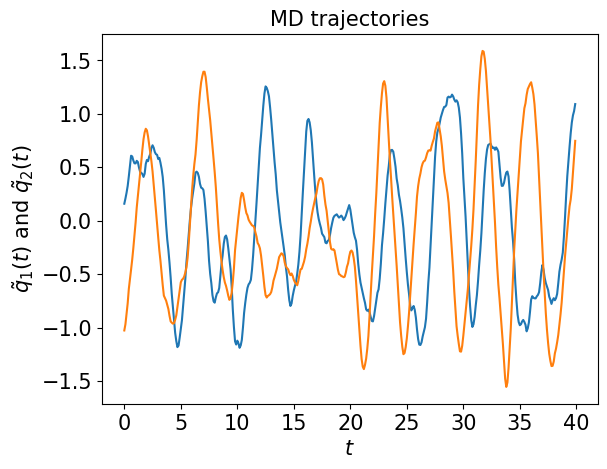

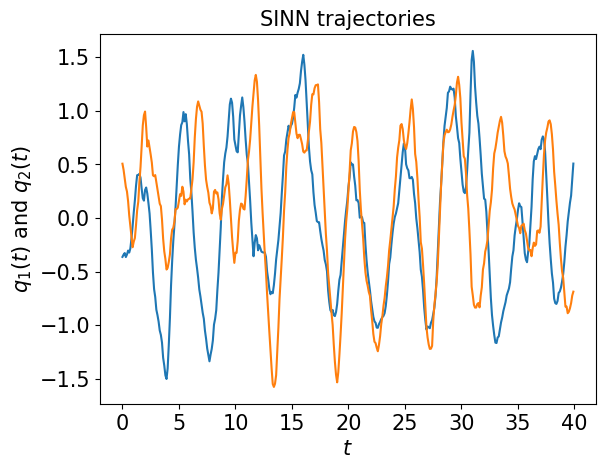

In [141]:
test1(model8)

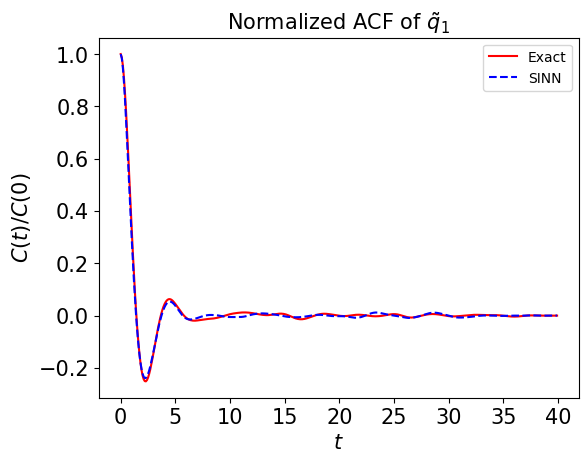

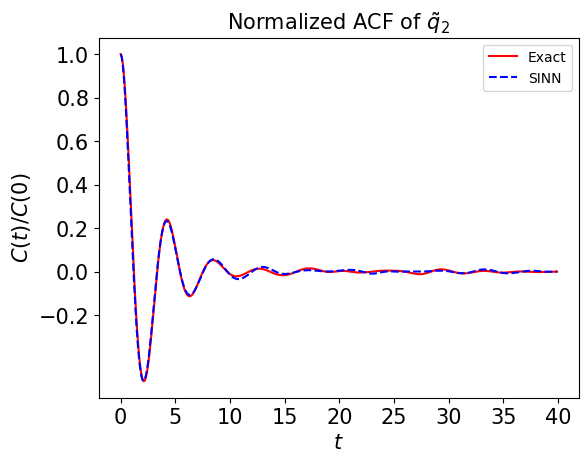

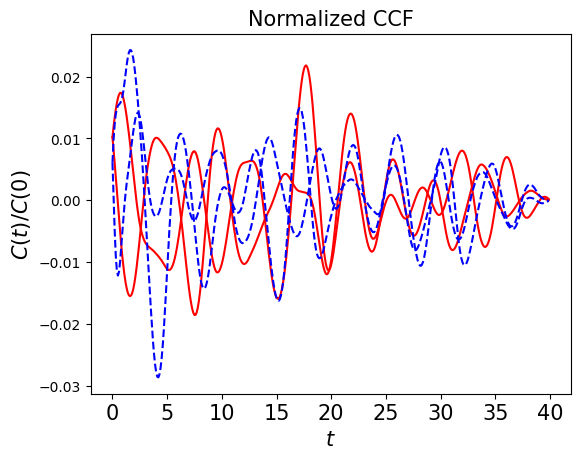

In [142]:
test2(model8)

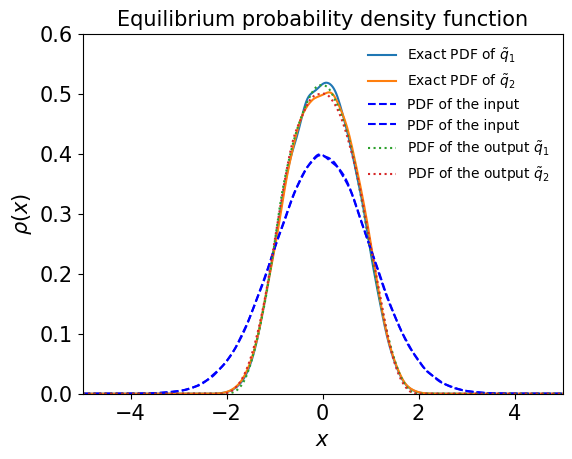

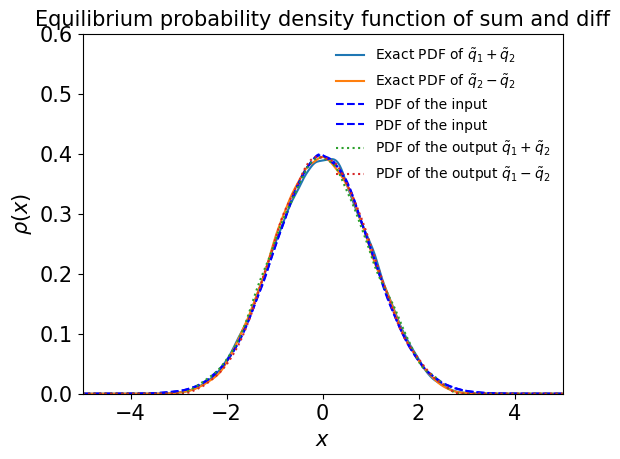

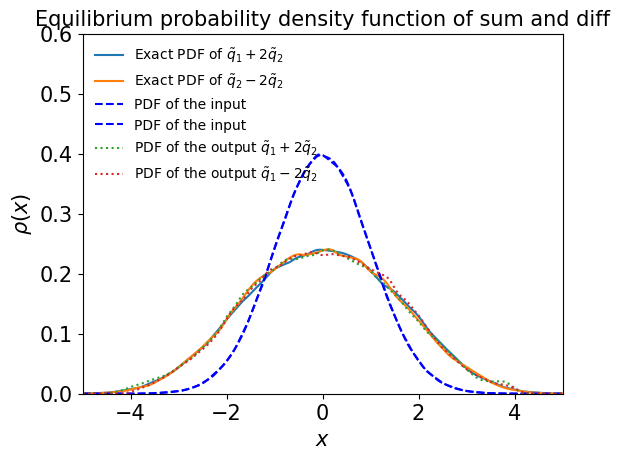

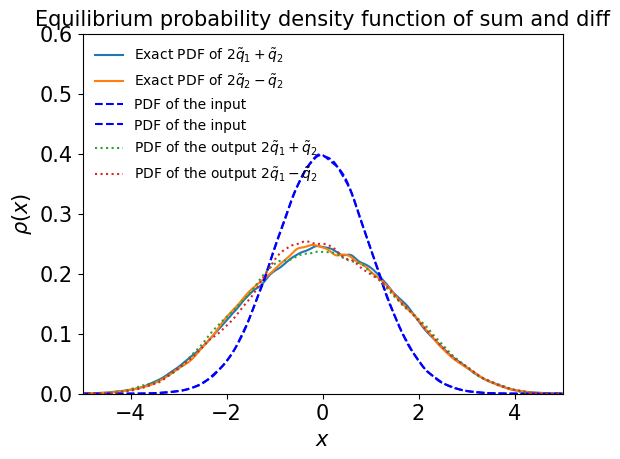

In [143]:
test3(model8)

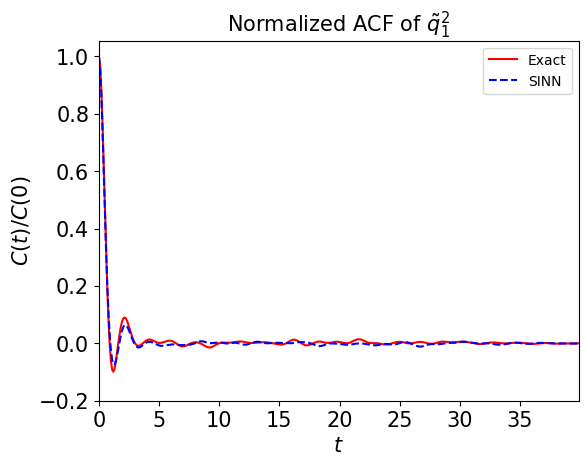

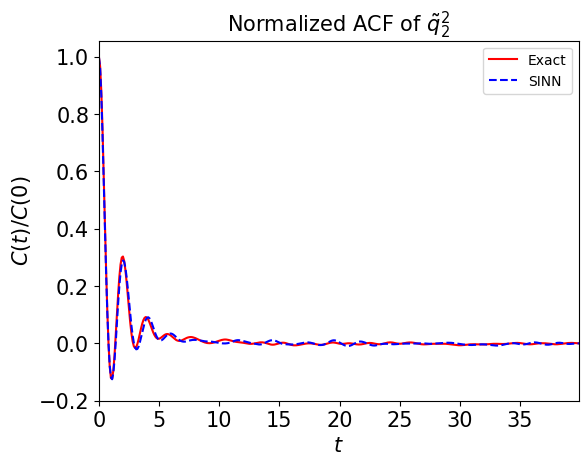

In [144]:
test4(model8)

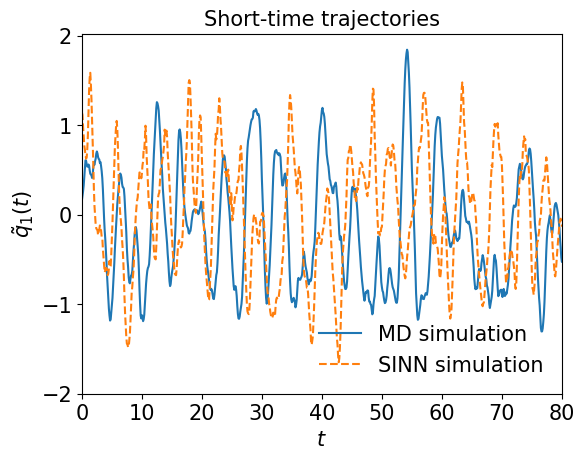

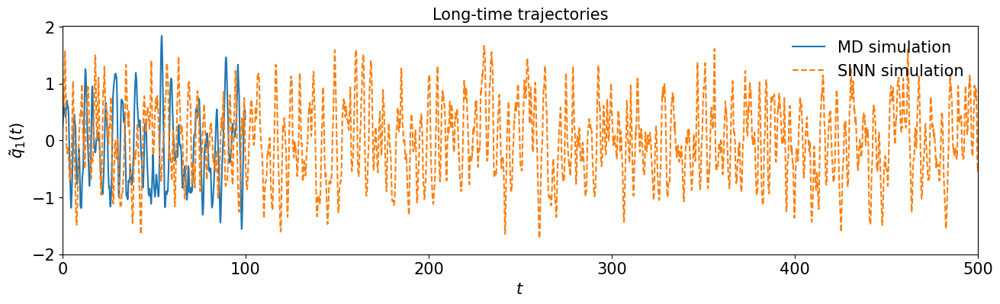

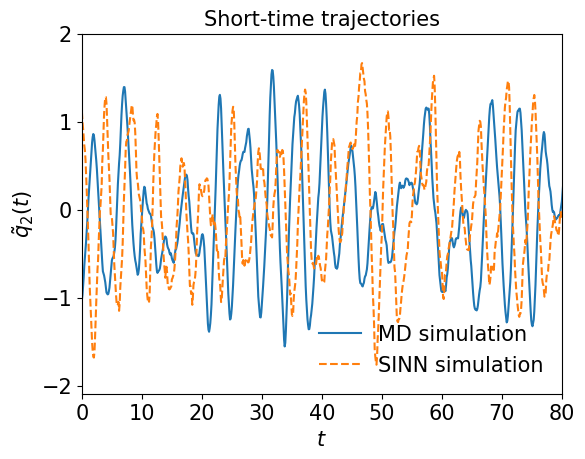

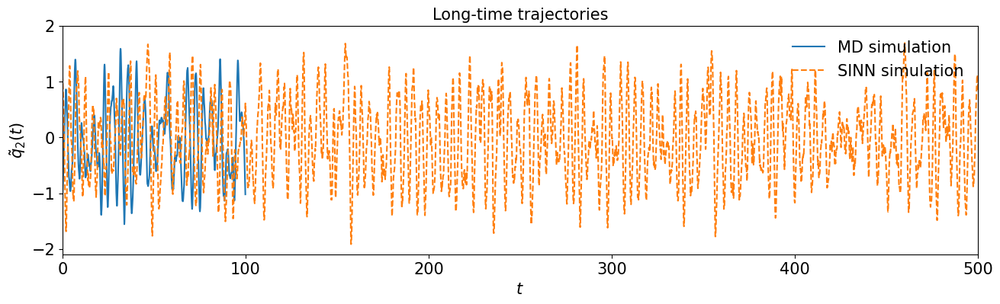

In [145]:
test5(model8)

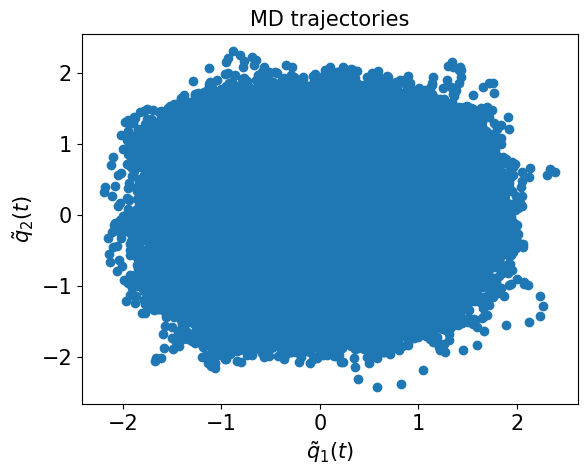

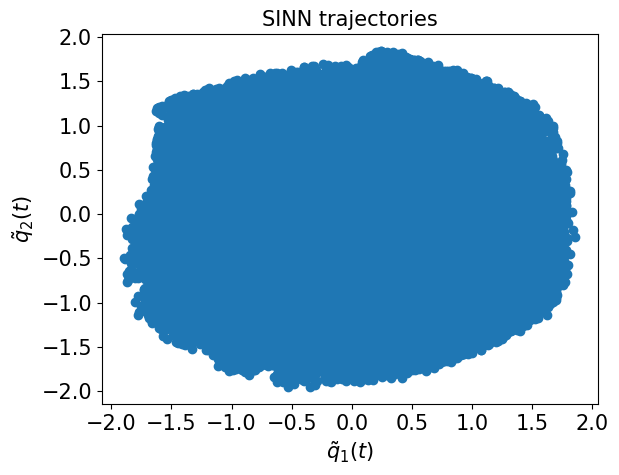

In [146]:
test6(model8)

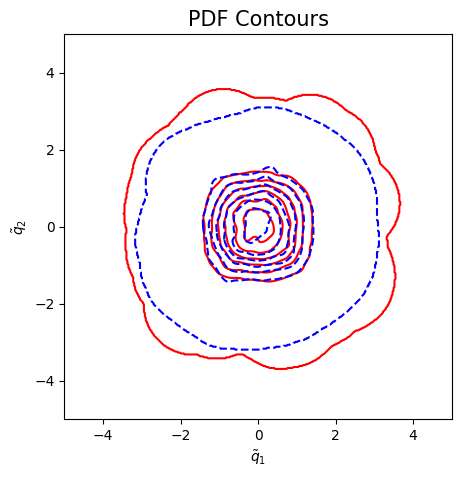

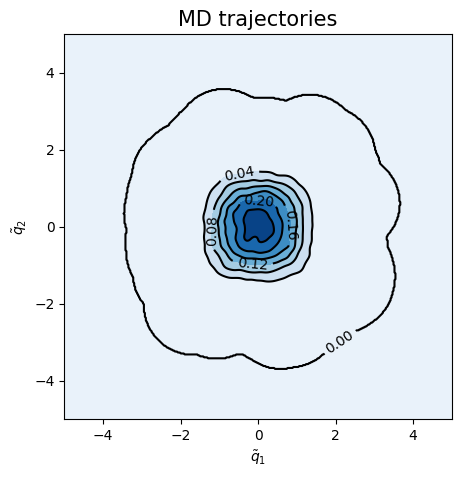

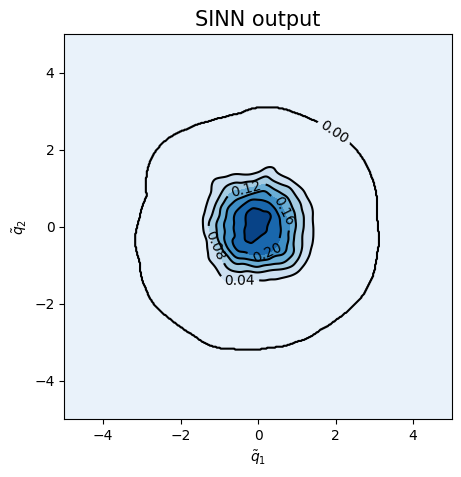

<Figure size 500x500 with 0 Axes>

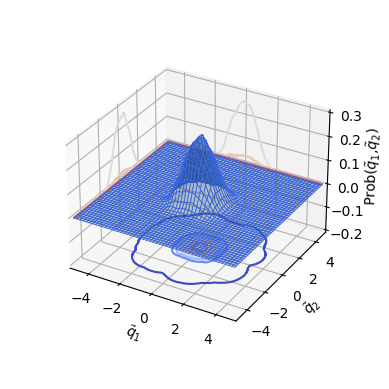

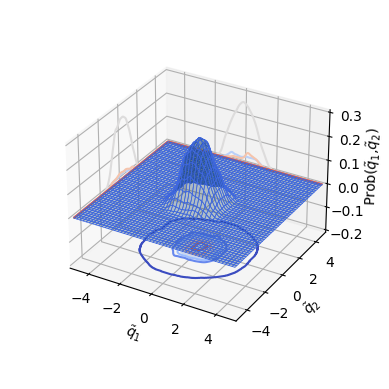

In [147]:
test7(model8)

In [148]:
### Defining SINN model
net9 = SINN(2, 10, 2, 2).to(device)

In [149]:
model9 = Model(net=net9)

In [150]:
model9.train()

[0]-th step loss: 0.5345, 0.5335, acf: 0.01176, ccf: 0.00341, pdf: 0.24714, pdf2: 0.26827, acf2: 0.00289
[50]-th step loss: 0.2988, 0.2891, acf: 0.00787, ccf: 0.00488, pdf: 0.15743, pdf2: 0.11755, acf2: 0.00137
[100]-th step loss: 0.0302, 0.0287, acf: 0.00682, ccf: 0.00579, pdf: 0.00722, pdf2: 0.00702, acf2: 0.00190
[150]-th step loss: 0.0125, 0.0123, acf: 0.00584, ccf: 0.00166, pdf: 0.00110, pdf2: 0.00236, acf2: 0.00135
[200]-th step loss: 0.0104, 0.0105, acf: 0.00554, ccf: 0.00125, pdf: 0.00069, pdf2: 0.00179, acf2: 0.00124
[250]-th step loss: 0.0094, 0.0092, acf: 0.00535, ccf: 0.00070, pdf: 0.00048, pdf2: 0.00145, acf2: 0.00121
[300]-th step loss: 0.0077, 0.0078, acf: 0.00484, ccf: 0.00039, pdf: 0.00035, pdf2: 0.00107, acf2: 0.00119
[350]-th step loss: 0.0056, 0.0056, acf: 0.00312, ccf: 0.00047, pdf: 0.00025, pdf2: 0.00064, acf2: 0.00111
[400]-th step loss: 0.0017, 0.0018, acf: 0.00032, ccf: 0.00027, pdf: 0.00017, pdf2: 0.00041, acf2: 0.00059
[450]-th step loss: 0.0011, 0.0011, acf:

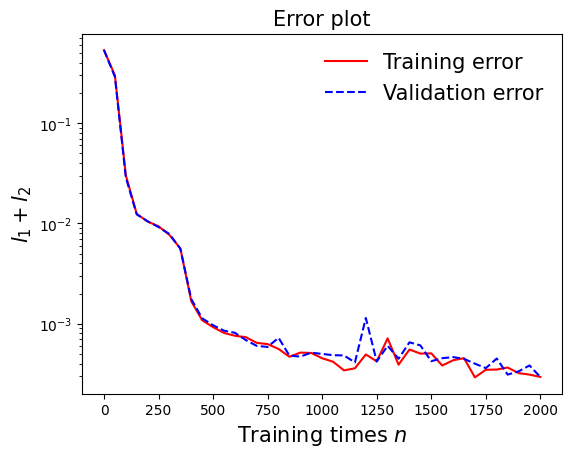

In [151]:
draw_loss(model9)

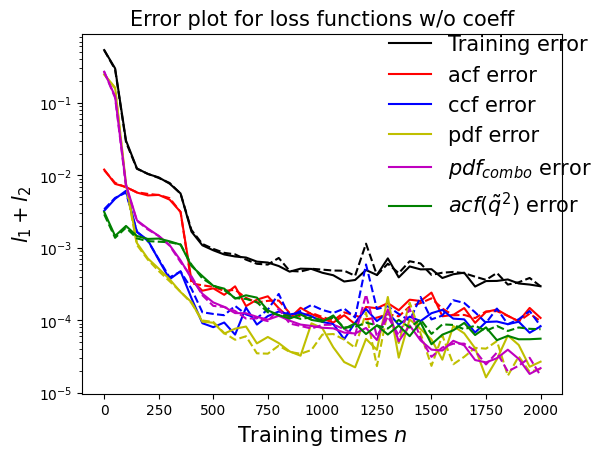

In [152]:
draw_errors(model9)

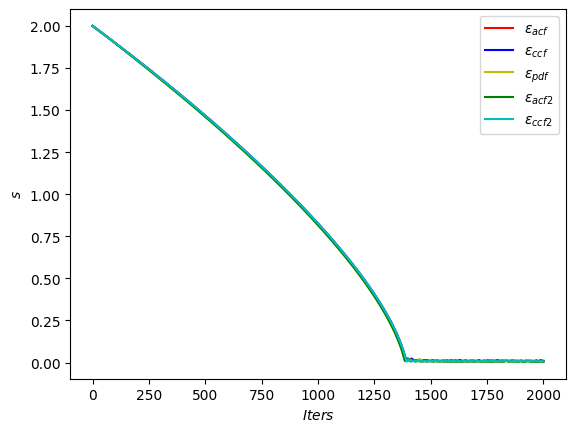

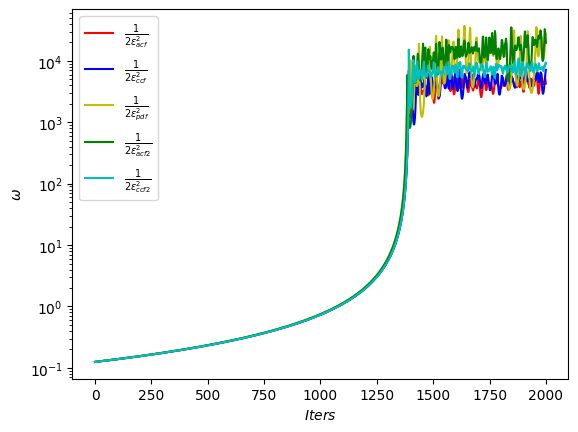

In [153]:
draw_adaptive_w(model9)
draw_epoch_w(model9)

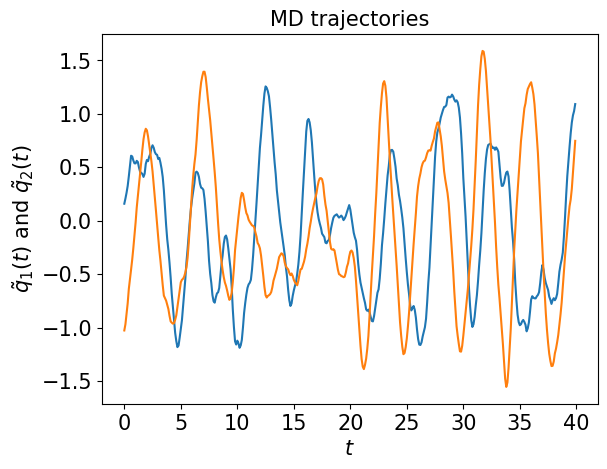

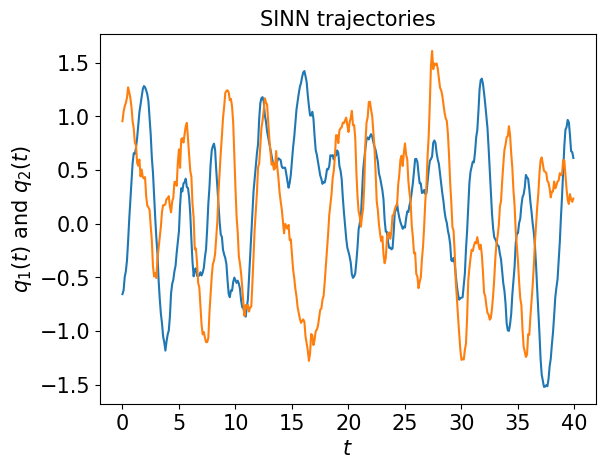

In [154]:
test1(model9)

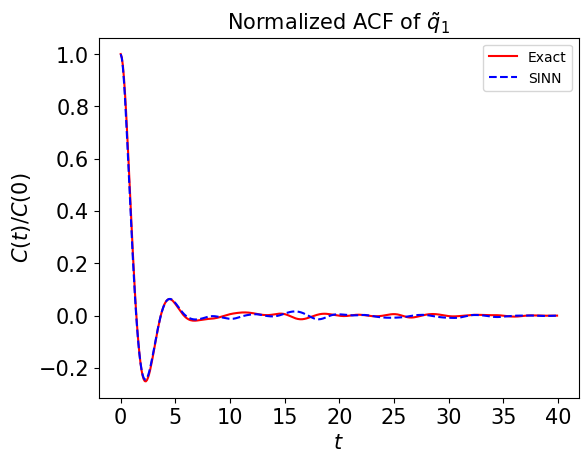

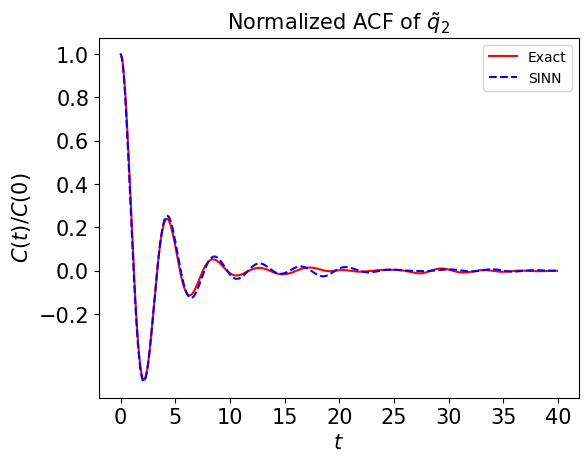

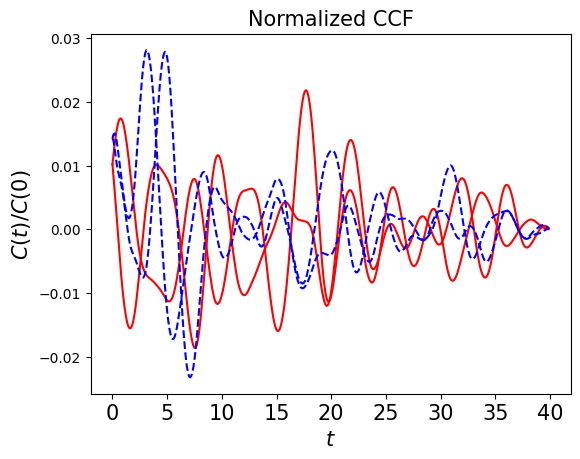

In [155]:
test2(model9)

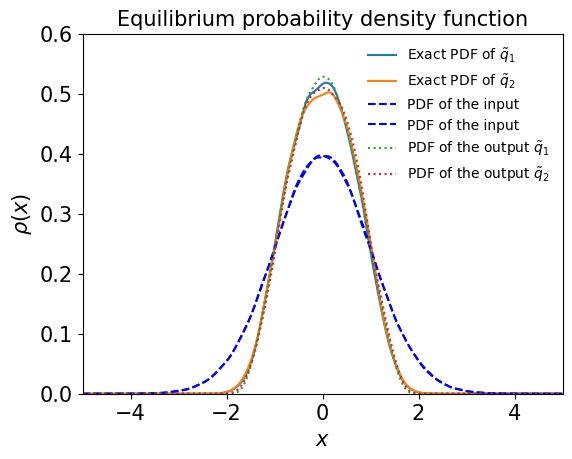

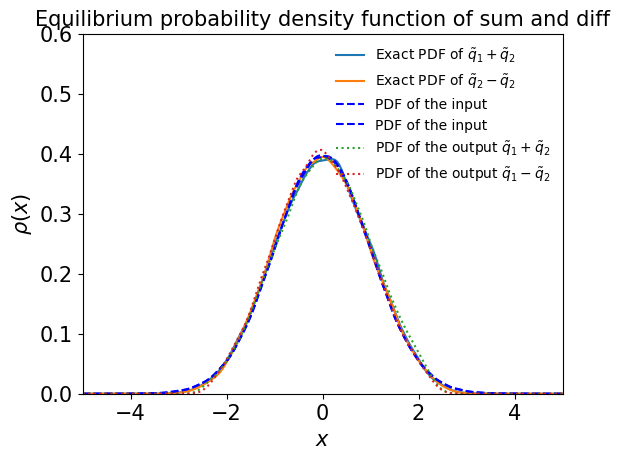

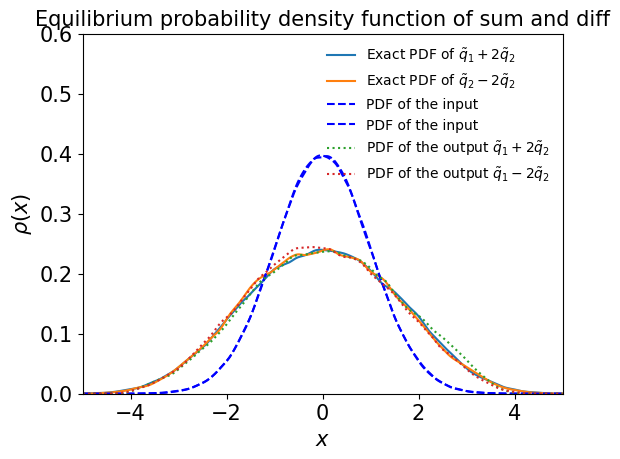

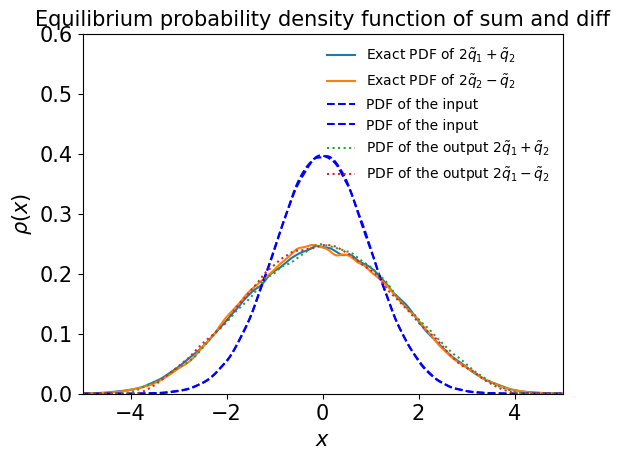

In [156]:
test3(model9)

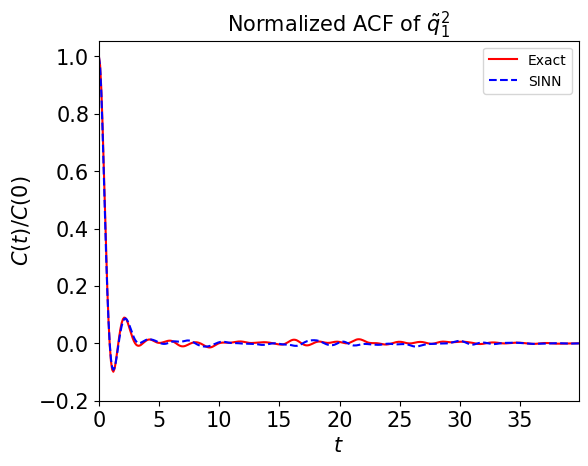

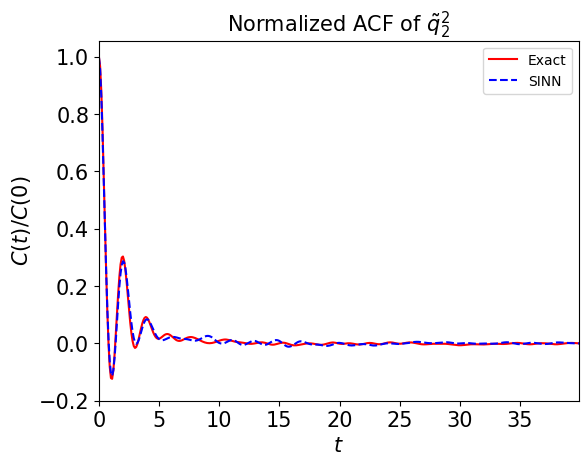

In [157]:
test4(model9)

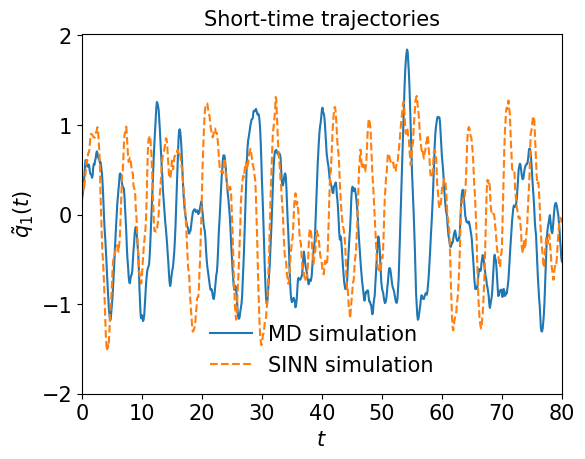

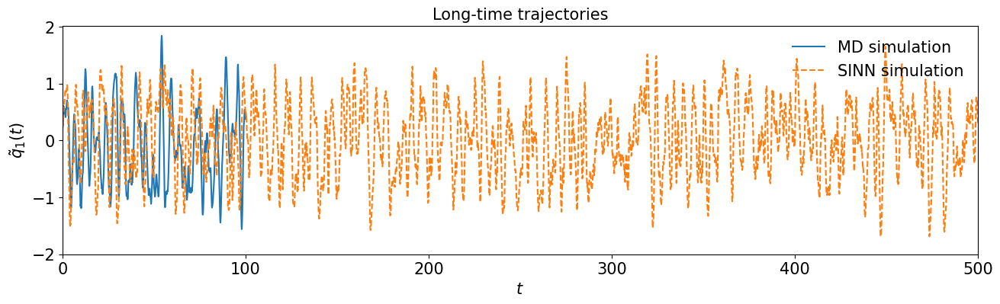

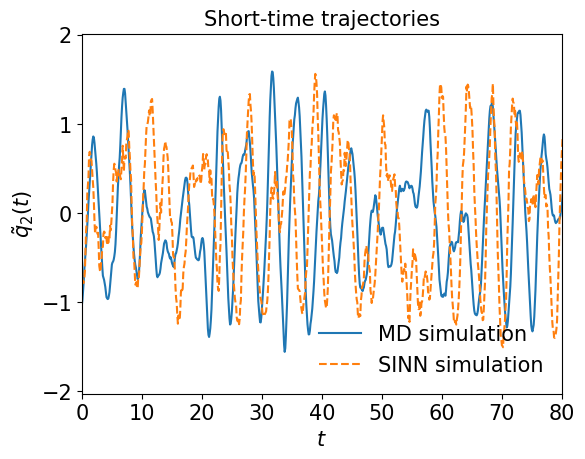

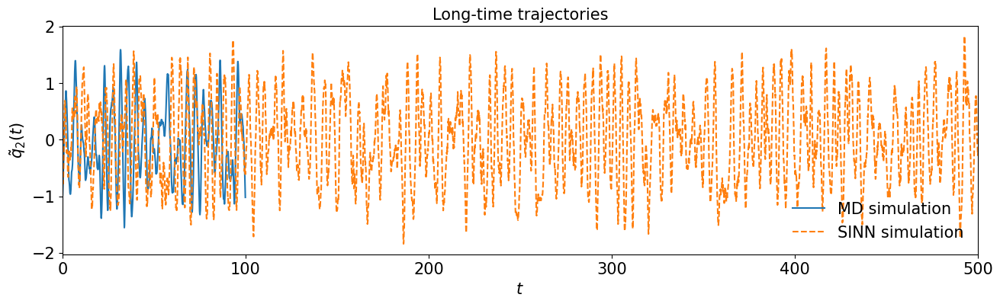

In [158]:
test5(model9)

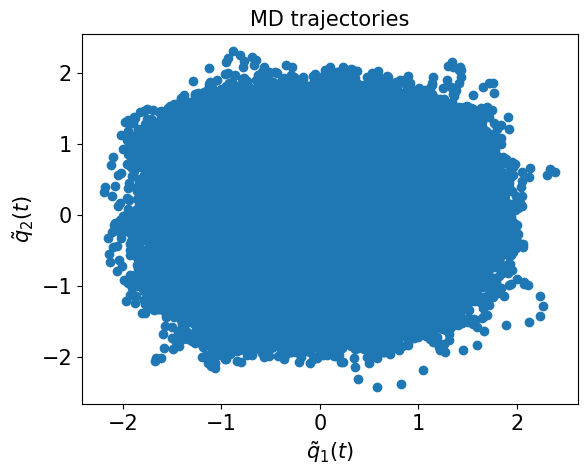

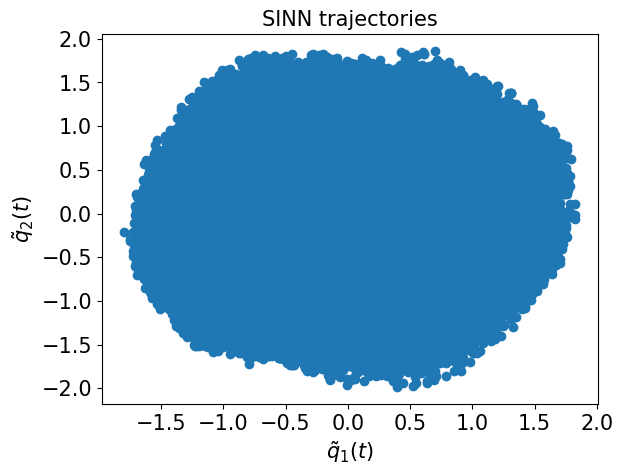

In [159]:
test6(model9)

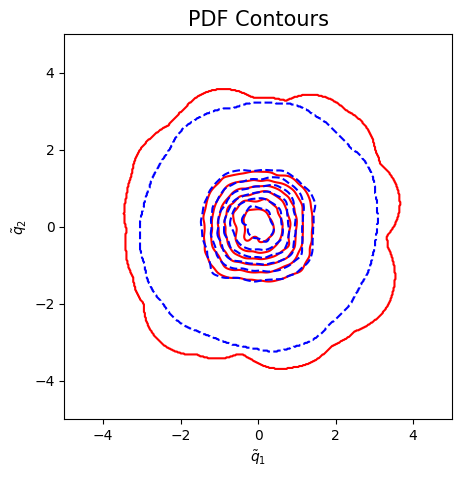

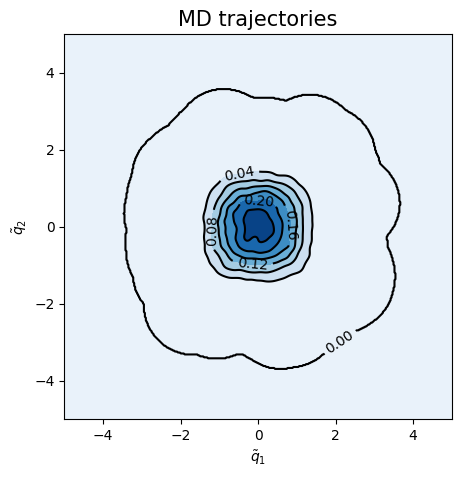

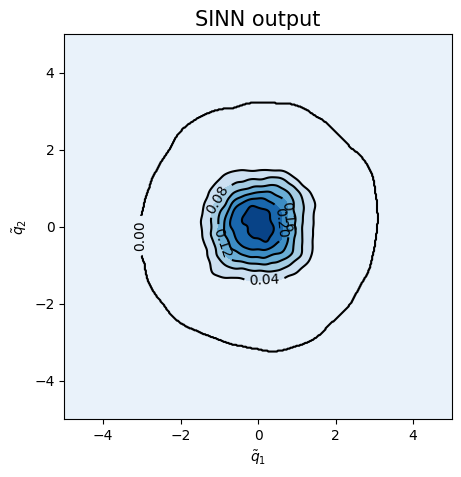

<Figure size 500x500 with 0 Axes>

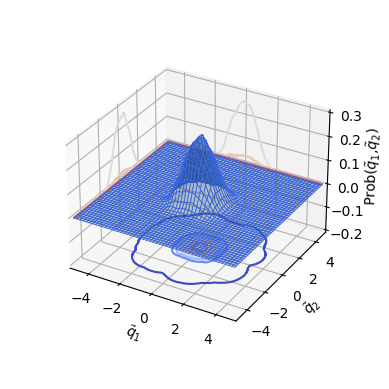

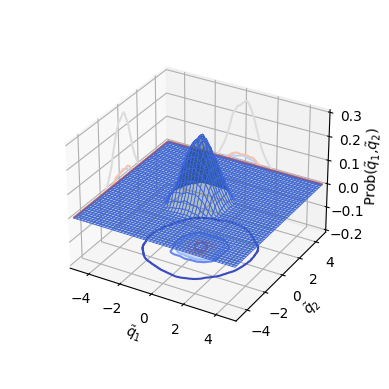

In [160]:
test7(model9)

In [161]:
### Defining SINN model
net10 = SINN(2, 10, 2, 2).to(device)

In [162]:
model10 = Model(net=net10)

In [163]:
model10.train()

[0]-th step loss: 0.5375, 0.5360, acf: 0.01380, ccf: 0.00127, pdf: 0.24804, pdf2: 0.26866, acf2: 0.00423
[50]-th step loss: 0.2361, 0.2252, acf: 0.00710, ccf: 0.00872, pdf: 0.12081, pdf2: 0.08699, acf2: 0.00162
[100]-th step loss: 0.0587, 0.0585, acf: 0.00819, ccf: 0.01570, pdf: 0.00886, pdf2: 0.02436, acf2: 0.00143
[150]-th step loss: 0.0330, 0.0323, acf: 0.00594, ccf: 0.00958, pdf: 0.00478, pdf2: 0.01066, acf2: 0.00134
[200]-th step loss: 0.0125, 0.0128, acf: 0.00678, ccf: 0.00135, pdf: 0.00153, pdf2: 0.00199, acf2: 0.00119
[250]-th step loss: 0.0095, 0.0099, acf: 0.00556, ccf: 0.00100, pdf: 0.00077, pdf2: 0.00140, acf2: 0.00119
[300]-th step loss: 0.0079, 0.0079, acf: 0.00438, ccf: 0.00085, pdf: 0.00046, pdf2: 0.00108, acf2: 0.00118
[350]-th step loss: 0.0060, 0.0060, acf: 0.00262, ccf: 0.00115, pdf: 0.00039, pdf2: 0.00080, acf2: 0.00108
[400]-th step loss: 0.0046, 0.0046, acf: 0.00166, ccf: 0.00104, pdf: 0.00035, pdf2: 0.00063, acf2: 0.00089
[450]-th step loss: 0.0031, 0.0034, acf:

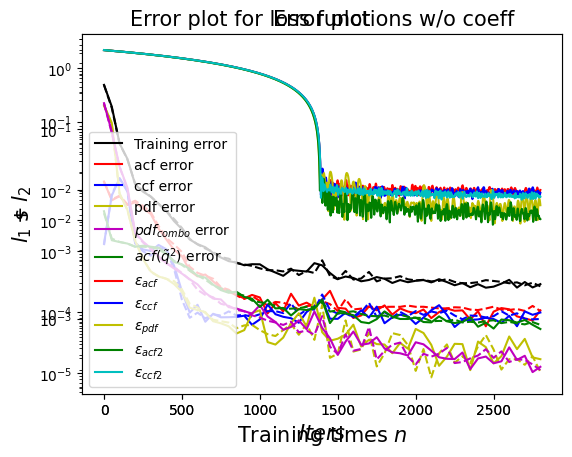

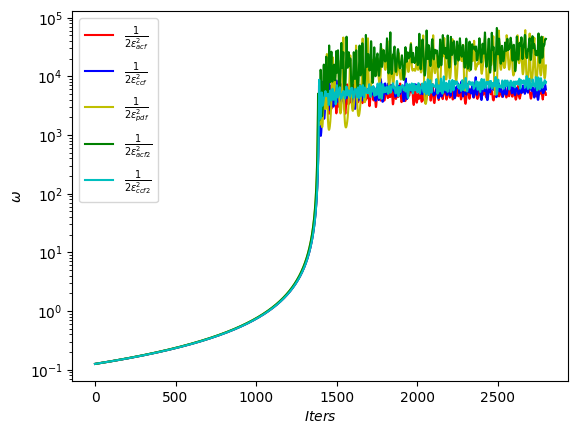

In [164]:
draw_loss(model10)
draw_errors(model10)
draw_adaptive_w(model10)
draw_epoch_w(model10)

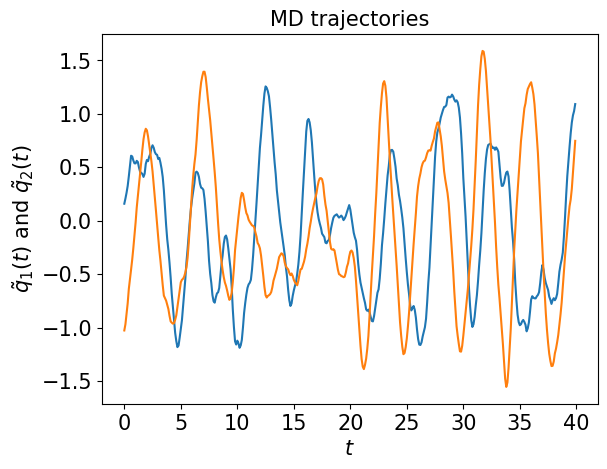

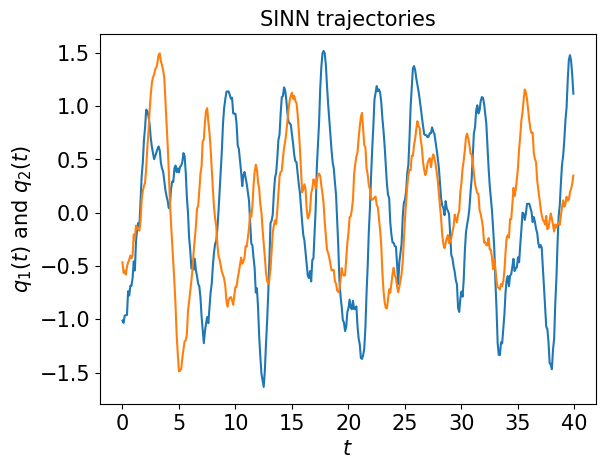

In [165]:
test1(model10)

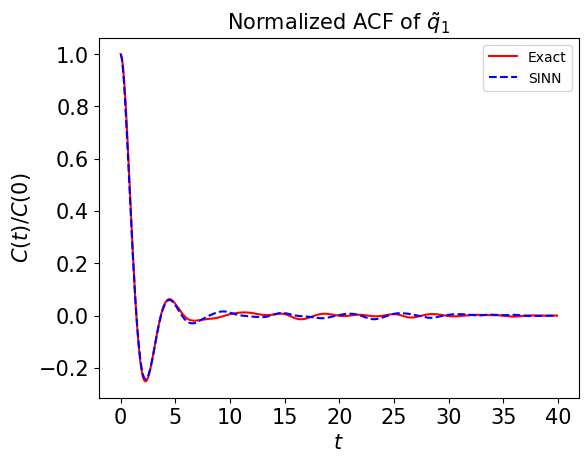

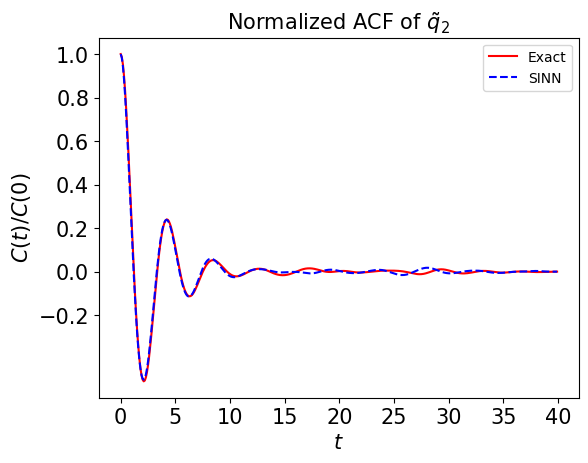

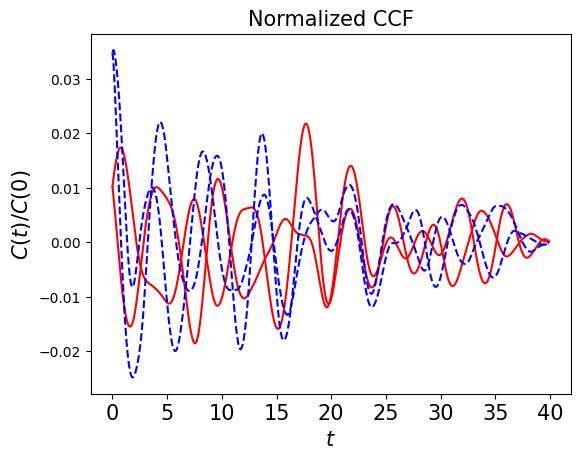

In [166]:
test2(model10)

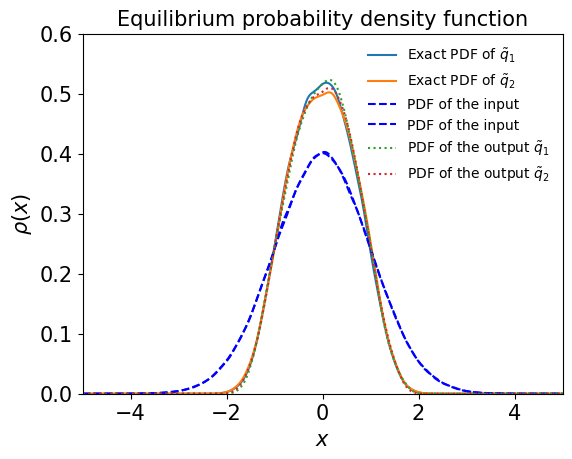

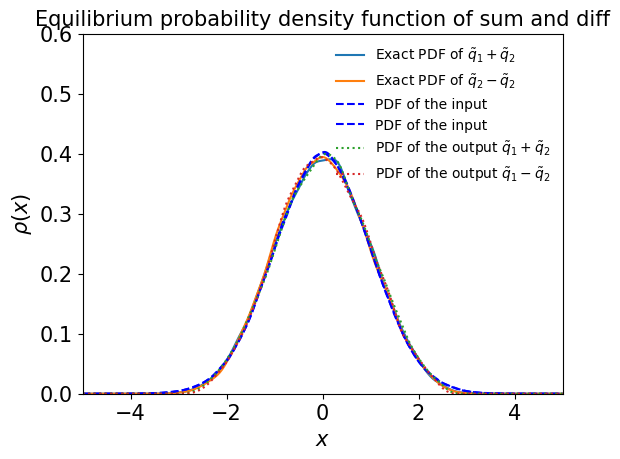

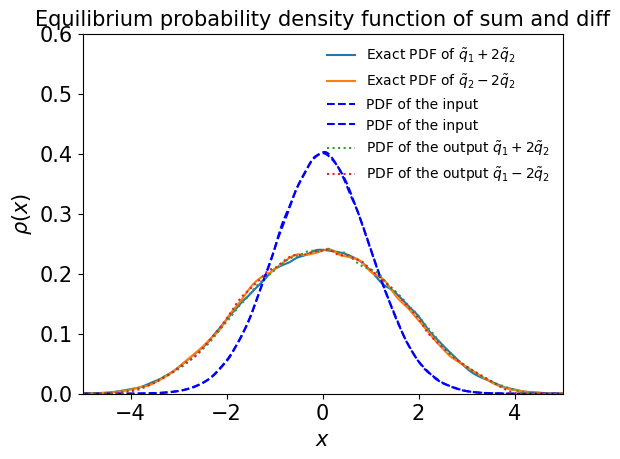

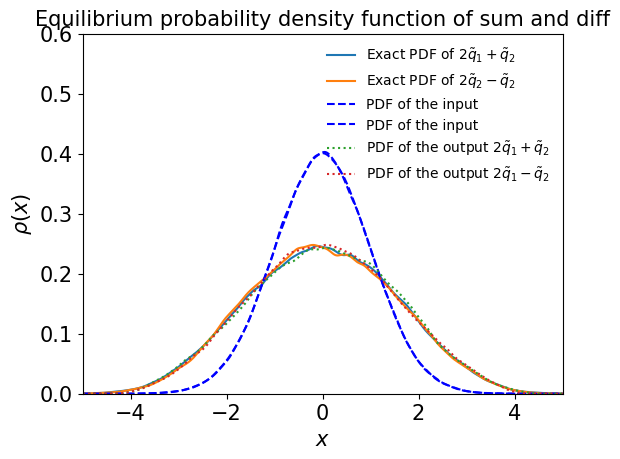

In [167]:
test3(model10)

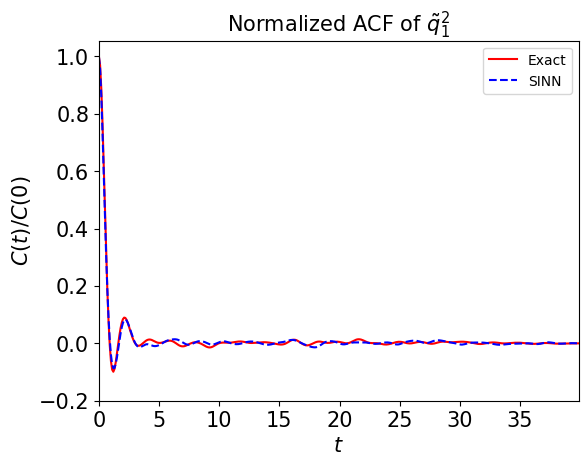

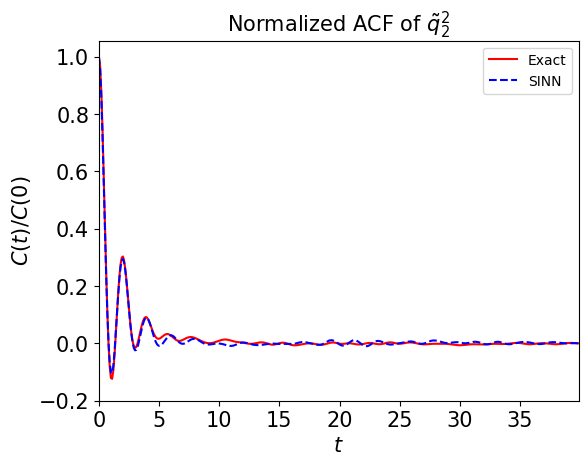

In [168]:
test4(model10)

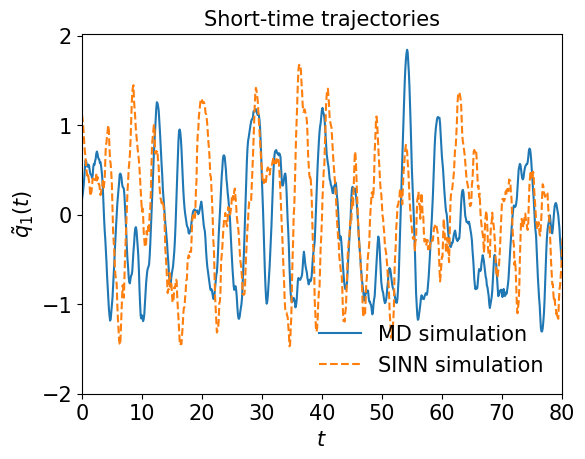

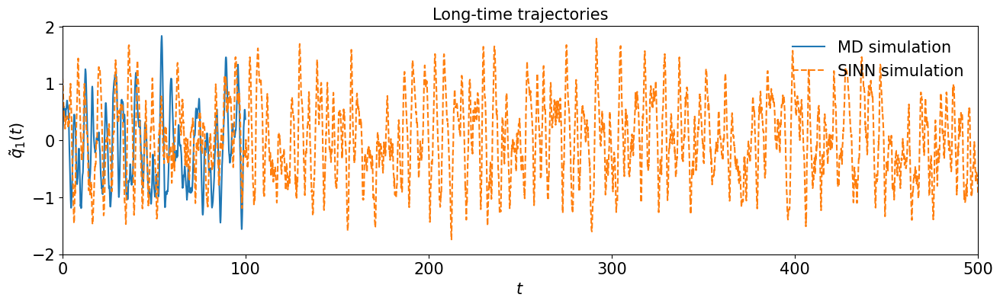

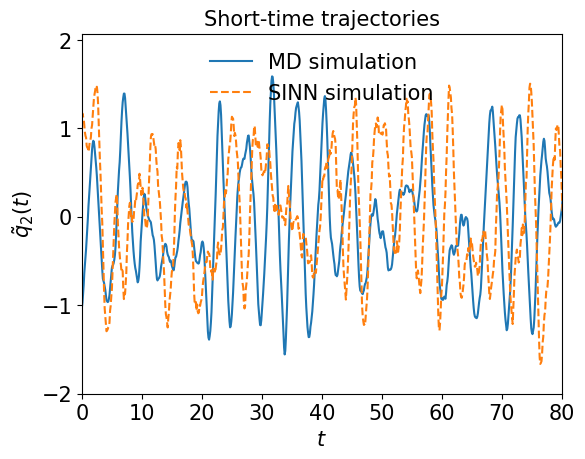

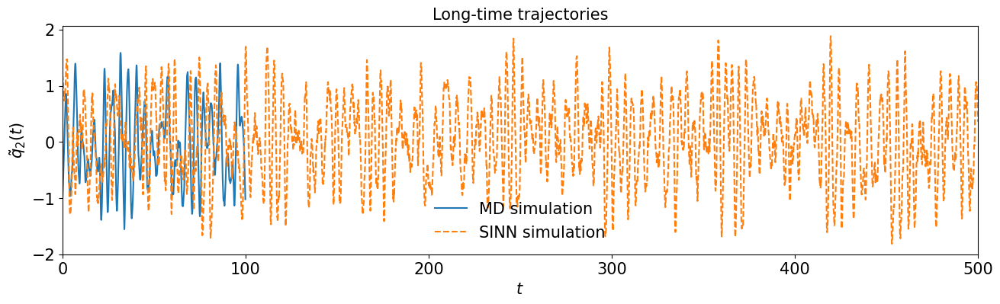

In [169]:
test5(model10)

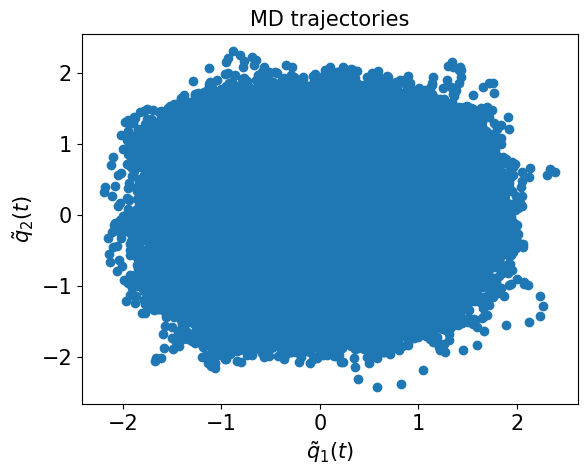

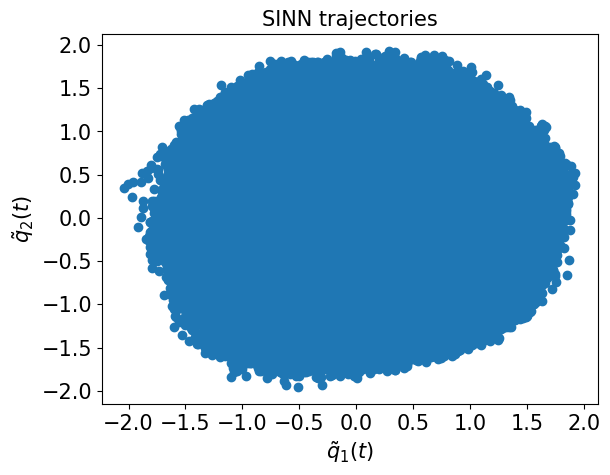

In [170]:
test6(model10)

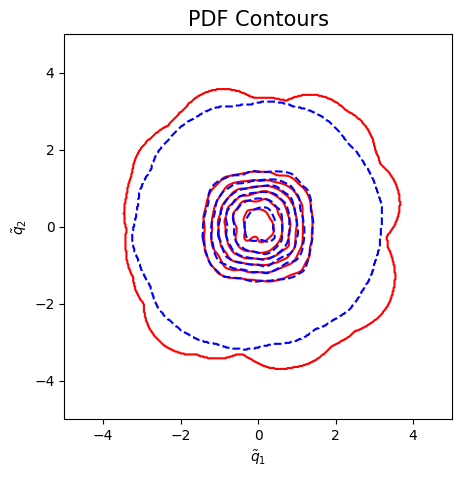

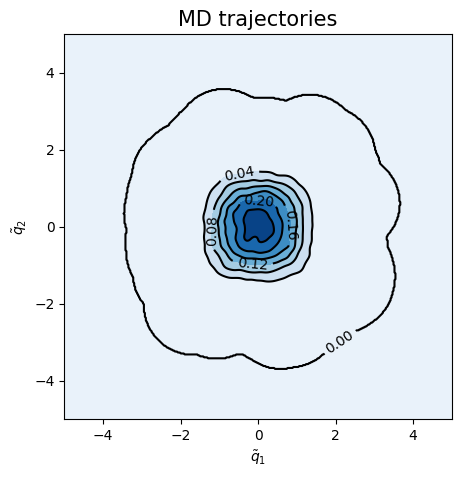

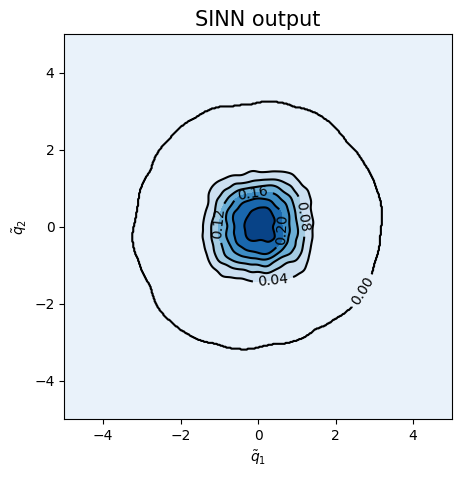

<Figure size 500x500 with 0 Axes>

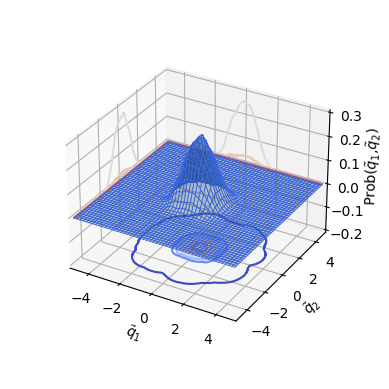

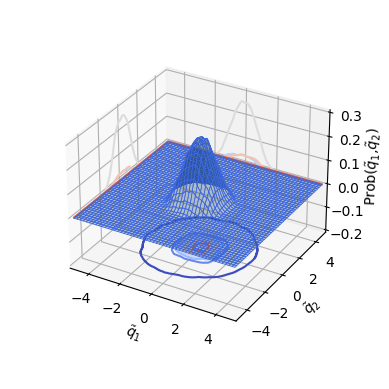

In [171]:
test7(model10)

In [172]:
### Defining SINN model
net11 = SINN(2, 10, 2, 2).to(device)
model11 = Model(net=net11)

In [173]:
model11.train()

[0]-th step loss: 0.5246, 0.5232, acf: 0.00877, ccf: 0.00259, pdf: 0.24510, pdf2: 0.26517, acf2: 0.00154
[50]-th step loss: 0.1924, 0.1841, acf: 0.00704, ccf: 0.00532, pdf: 0.10540, pdf2: 0.06478, acf2: 0.00157
[100]-th step loss: 0.0274, 0.0269, acf: 0.01008, ccf: 0.00130, pdf: 0.00856, pdf2: 0.00465, acf2: 0.00230
[150]-th step loss: 0.0145, 0.0147, acf: 0.00792, ccf: 0.00036, pdf: 0.00280, pdf2: 0.00226, acf2: 0.00136
[200]-th step loss: 0.0111, 0.0113, acf: 0.00661, ccf: 0.00036, pdf: 0.00140, pdf2: 0.00173, acf2: 0.00122
[250]-th step loss: 0.0095, 0.0098, acf: 0.00607, ccf: 0.00026, pdf: 0.00084, pdf2: 0.00144, acf2: 0.00121
[300]-th step loss: 0.0087, 0.0089, acf: 0.00563, ccf: 0.00024, pdf: 0.00059, pdf2: 0.00124, acf2: 0.00122
[350]-th step loss: 0.0077, 0.0081, acf: 0.00502, ccf: 0.00034, pdf: 0.00045, pdf2: 0.00106, acf2: 0.00120
[400]-th step loss: 0.0061, 0.0065, acf: 0.00379, ccf: 0.00050, pdf: 0.00037, pdf2: 0.00078, acf2: 0.00111
[450]-th step loss: 0.0030, 0.0030, acf:

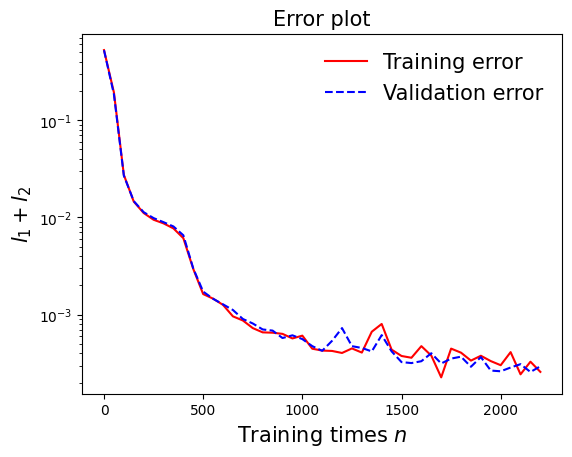

In [194]:
draw_loss(model11)

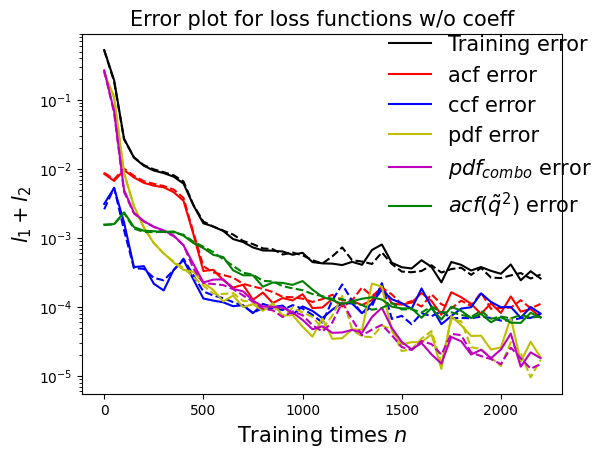

In [195]:
draw_errors(model11)

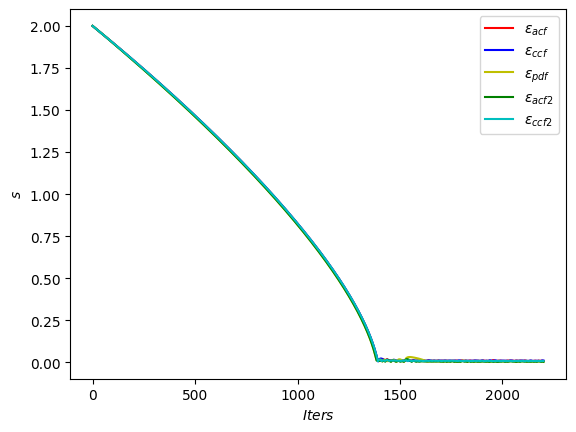

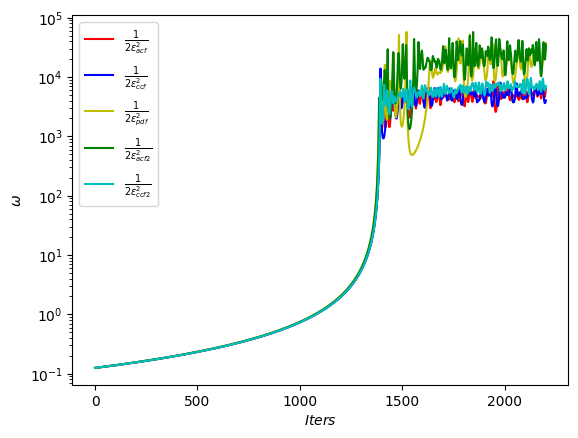

In [196]:
draw_adaptive_w(model11)
draw_epoch_w(model11)

In [175]:
### Defining SINN model
net12 = SINN(2, 10, 2, 2).to(device)
model12 = Model(net=net12)
model12.train()

[0]-th step loss: 0.5408, 0.5397, acf: 0.01329, ccf: 0.00188, pdf: 0.24827, pdf2: 0.27235, acf2: 0.00391
[50]-th step loss: 0.2930, 0.2817, acf: 0.00692, ccf: 0.00791, pdf: 0.15095, pdf2: 0.11424, acf2: 0.00164
[100]-th step loss: 0.0583, 0.0573, acf: 0.00840, ccf: 0.01478, pdf: 0.01095, pdf2: 0.02172, acf2: 0.00145
[150]-th step loss: 0.0151, 0.0150, acf: 0.00546, ccf: 0.00246, pdf: 0.00237, pdf2: 0.00330, acf2: 0.00141
[200]-th step loss: 0.0096, 0.0098, acf: 0.00364, ccf: 0.00216, pdf: 0.00091, pdf2: 0.00204, acf2: 0.00104
[250]-th step loss: 0.0062, 0.0065, acf: 0.00244, ccf: 0.00136, pdf: 0.00052, pdf2: 0.00132, acf2: 0.00087
[300]-th step loss: 0.0029, 0.0029, acf: 0.00078, ccf: 0.00049, pdf: 0.00034, pdf2: 0.00072, acf2: 0.00059
[350]-th step loss: 0.0017, 0.0017, acf: 0.00032, ccf: 0.00018, pdf: 0.00020, pdf2: 0.00057, acf2: 0.00040
[400]-th step loss: 0.0015, 0.0015, acf: 0.00034, ccf: 0.00015, pdf: 0.00017, pdf2: 0.00047, acf2: 0.00034
[450]-th step loss: 0.0013, 0.0013, acf:

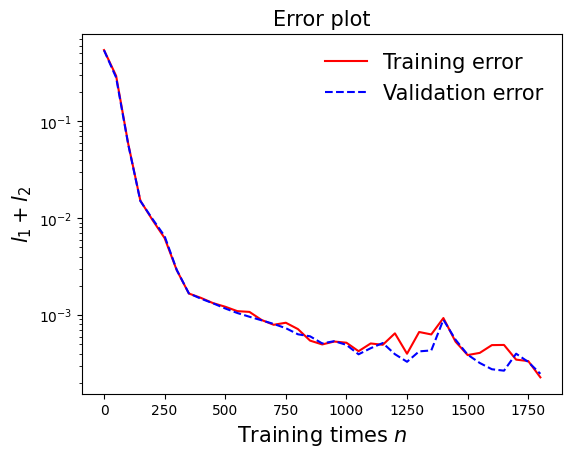

In [197]:
draw_loss(model12)

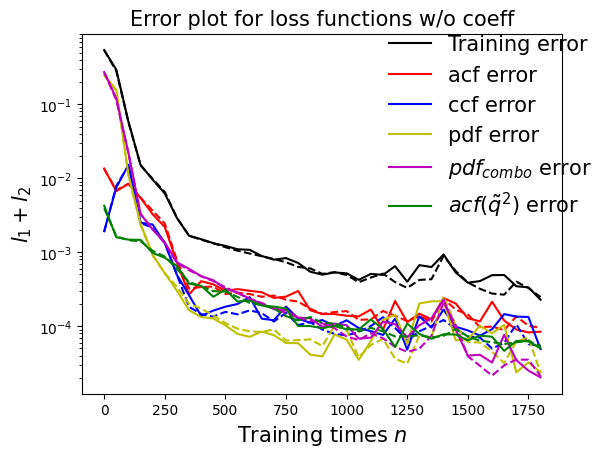

In [198]:
draw_errors(model12)

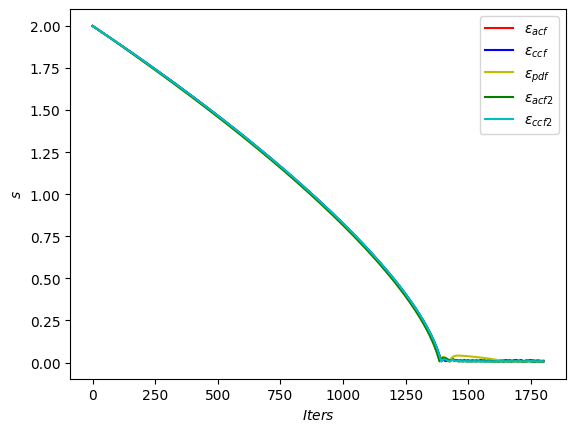

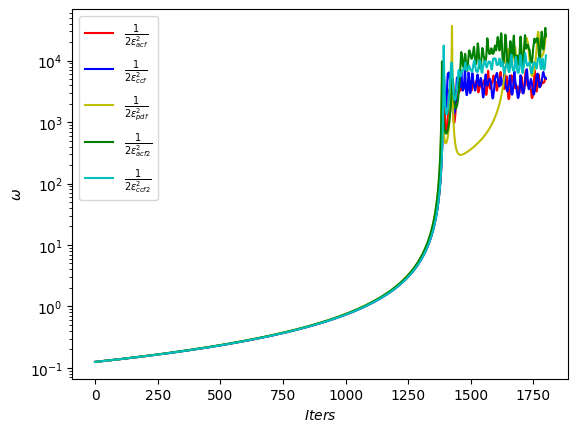

In [199]:
draw_adaptive_w(model12)
draw_epoch_w(model12)

In [177]:
### Defining SINN model
net13 = SINN(2, 10, 2, 2).to(device)
model13 = Model(net=net13)
model13.train()

[0]-th step loss: 0.5332, 0.5320, acf: 0.01342, ccf: 0.00417, pdf: 0.24642, pdf2: 0.26420, acf2: 0.00382
[50]-th step loss: 0.2335, 0.2231, acf: 0.00820, ccf: 0.00614, pdf: 0.13039, pdf2: 0.07573, acf2: 0.00261
[100]-th step loss: 0.0556, 0.0540, acf: 0.00634, ccf: 0.01011, pdf: 0.01861, pdf2: 0.01689, acf2: 0.00206
[150]-th step loss: 0.0241, 0.0239, acf: 0.00427, ccf: 0.00769, pdf: 0.00370, pdf2: 0.00687, acf2: 0.00141
[200]-th step loss: 0.0182, 0.0180, acf: 0.00304, ccf: 0.00973, pdf: 0.00148, pdf2: 0.00277, acf2: 0.00097
[250]-th step loss: 0.0163, 0.0161, acf: 0.00337, ccf: 0.00920, pdf: 0.00083, pdf2: 0.00179, acf2: 0.00094
[300]-th step loss: 0.0150, 0.0150, acf: 0.00340, ccf: 0.00879, pdf: 0.00054, pdf2: 0.00133, acf2: 0.00091
[350]-th step loss: 0.0136, 0.0136, acf: 0.00325, ccf: 0.00779, pdf: 0.00035, pdf2: 0.00128, acf2: 0.00093
[400]-th step loss: 0.0124, 0.0124, acf: 0.00322, ccf: 0.00683, pdf: 0.00032, pdf2: 0.00111, acf2: 0.00090
[450]-th step loss: 0.0118, 0.0118, acf:

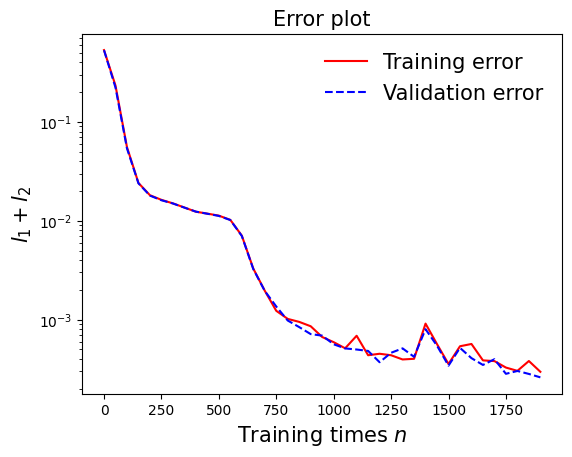

In [200]:
draw_loss(model13)

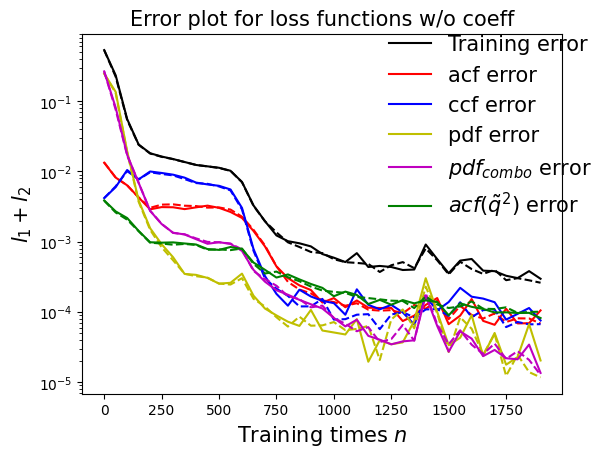

In [201]:
draw_errors(model13)

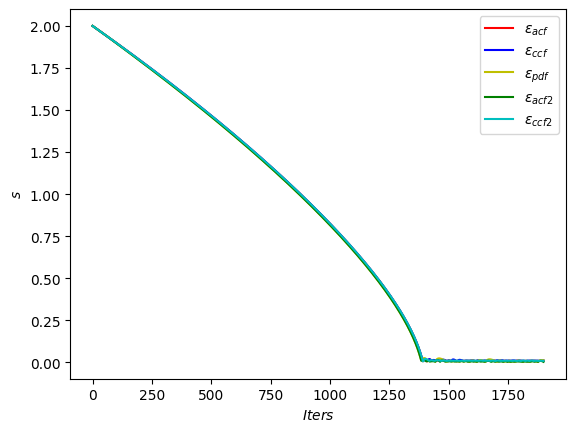

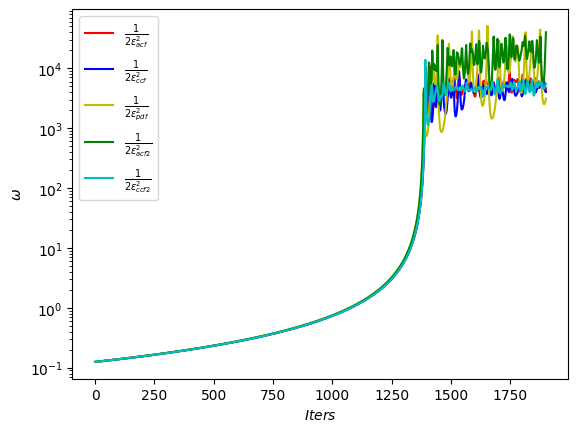

In [202]:
draw_adaptive_w(model13)
draw_epoch_w(model13)

In [179]:
### Defining SINN model
net14 = SINN(2, 10, 2, 2).to(device)
model14 = Model(net=net14)
model14.train()

[0]-th step loss: 0.5329, 0.5311, acf: 0.01171, ccf: 0.00474, pdf: 0.24546, pdf2: 0.26624, acf2: 0.00294
[50]-th step loss: 0.1763, 0.1701, acf: 0.00692, ccf: 0.01308, pdf: 0.06480, pdf2: 0.08375, acf2: 0.00150
[100]-th step loss: 0.0610, 0.0609, acf: 0.00676, ccf: 0.01492, pdf: 0.00867, pdf2: 0.02931, acf2: 0.00126
[150]-th step loss: 0.0362, 0.0358, acf: 0.00376, ccf: 0.01221, pdf: 0.00326, pdf2: 0.01520, acf2: 0.00141
[200]-th step loss: 0.0264, 0.0263, acf: 0.00234, ccf: 0.01209, pdf: 0.00225, pdf2: 0.00851, acf2: 0.00113
[250]-th step loss: 0.0221, 0.0222, acf: 0.00259, ccf: 0.01109, pdf: 0.00167, pdf2: 0.00574, acf2: 0.00107
[300]-th step loss: 0.0181, 0.0181, acf: 0.00282, ccf: 0.00995, pdf: 0.00124, pdf2: 0.00306, acf2: 0.00098
[350]-th step loss: 0.0126, 0.0124, acf: 0.00231, ccf: 0.00694, pdf: 0.00094, pdf2: 0.00133, acf2: 0.00090
[400]-th step loss: 0.0075, 0.0094, acf: 0.00268, ccf: 0.00293, pdf: 0.00112, pdf2: 0.00159, acf2: 0.00105
[450]-th step loss: 0.0050, 0.0052, acf:

[3850]-th step loss: 0.0017, 0.0017, acf: 0.00117, ccf: 0.00006, pdf: 0.00005, pdf2: 0.00003, acf2: 0.00042
[3900]-th step loss: 0.0016, 0.0017, acf: 0.00115, ccf: 0.00007, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00042
[3950]-th step loss: 0.0015, 0.0017, acf: 0.00114, ccf: 0.00007, pdf: 0.00004, pdf2: 0.00003, acf2: 0.00043
[4000]-th step loss: 0.0016, 0.0016, acf: 0.00113, ccf: 0.00005, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00042
[4050]-th step loss: 0.0016, 0.0016, acf: 0.00113, ccf: 0.00006, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00038
[4100]-th step loss: 0.0017, 0.0017, acf: 0.00122, ccf: 0.00005, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00037
[4150]-th step loss: 0.0016, 0.0016, acf: 0.00117, ccf: 0.00006, pdf: 0.00001, pdf2: 0.00002, acf2: 0.00037
[4200]-th step loss: 0.0017, 0.0016, acf: 0.00114, ccf: 0.00006, pdf: 0.00001, pdf2: 0.00002, acf2: 0.00037
[4250]-th step loss: 0.0018, 0.0018, acf: 0.00122, ccf: 0.00007, pdf: 0.00010, pdf2: 0.00005, acf2: 0.00038
[4300]-th step loss: 0.0016,

[7650]-th step loss: 0.0008, 0.0009, acf: 0.00064, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00016
[7700]-th step loss: 0.0007, 0.0008, acf: 0.00050, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00017
[7750]-th step loss: 0.0008, 0.0007, acf: 0.00048, ccf: 0.00007, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00016
[7800]-th step loss: 0.0006, 0.0007, acf: 0.00043, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00017
[7850]-th step loss: 0.0010, 0.0012, acf: 0.00079, ccf: 0.00014, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00024
[7900]-th step loss: 0.0008, 0.0008, acf: 0.00053, ccf: 0.00007, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00016
[7950]-th step loss: 0.0007, 0.0007, acf: 0.00047, ccf: 0.00009, pdf: 0.00001, pdf2: 0.00002, acf2: 0.00015
[8000]-th step loss: 0.0006, 0.0007, acf: 0.00042, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00016
[8050]-th step loss: 0.0006, 0.0007, acf: 0.00042, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00016
[8100]-th step loss: 0.0007,

[11450]-th step loss: 0.0005, 0.0004, acf: 0.00023, ccf: 0.00008, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00009
[11500]-th step loss: 0.0004, 0.0004, acf: 0.00017, ccf: 0.00009, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00009
[11550]-th step loss: 0.0004, 0.0004, acf: 0.00017, ccf: 0.00009, pdf: 0.00003, pdf2: 0.00001, acf2: 0.00008
[11600]-th step loss: 0.0003, 0.0004, acf: 0.00022, ccf: 0.00010, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00008
[11650]-th step loss: 0.0004, 0.0004, acf: 0.00017, ccf: 0.00011, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00008
[11700]-th step loss: 0.0003, 0.0004, acf: 0.00021, ccf: 0.00010, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00009
[11750]-th step loss: 0.0003, 0.0004, acf: 0.00018, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00008
[11800]-th step loss: 0.0003, 0.0004, acf: 0.00019, ccf: 0.00010, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00008
[11850]-th step loss: 0.0003, 0.0004, acf: 0.00019, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00007
[11900]-th step los

[15250]-th step loss: 0.0039, 0.0039, acf: 0.00254, ccf: 0.00107, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00029
[15300]-th step loss: 0.0033, 0.0032, acf: 0.00237, ccf: 0.00055, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00026
[15350]-th step loss: 0.0025, 0.0026, acf: 0.00224, ccf: 0.00015, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00020
[15400]-th step loss: 0.0020, 0.0021, acf: 0.00182, ccf: 0.00008, pdf: 0.00001, pdf2: 0.00002, acf2: 0.00018
[15450]-th step loss: 0.0017, 0.0017, acf: 0.00139, ccf: 0.00008, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00016
[15500]-th step loss: 0.0013, 0.0014, acf: 0.00119, ccf: 0.00009, pdf: 0.00001, pdf2: 0.00002, acf2: 0.00013
[15550]-th step loss: 0.0010, 0.0011, acf: 0.00082, ccf: 0.00008, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00013
[15600]-th step loss: 0.0011, 0.0010, acf: 0.00074, ccf: 0.00007, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00012
[15650]-th step loss: 0.0008, 0.0008, acf: 0.00055, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00013
[15700]-th step los

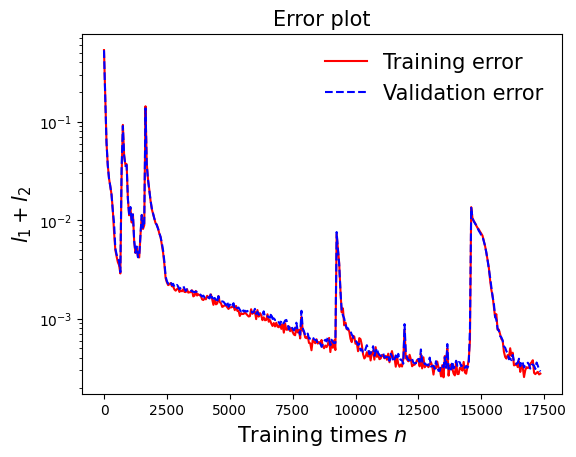

In [203]:
draw_loss(model14)

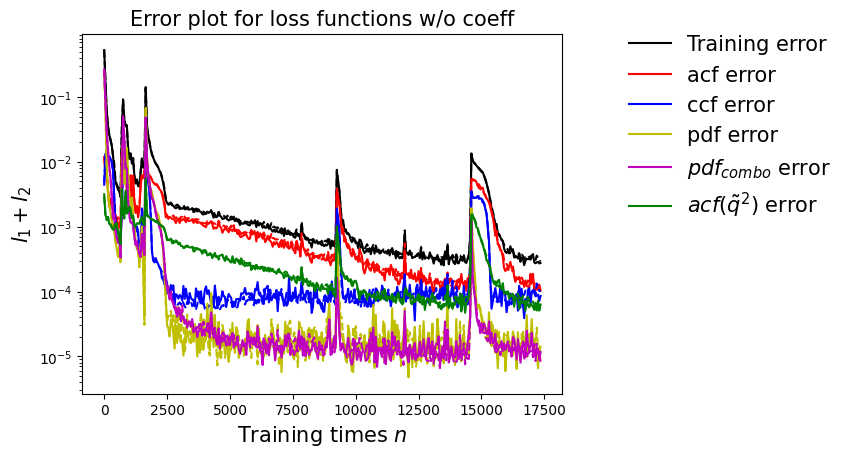

In [204]:
draw_errors(model14)

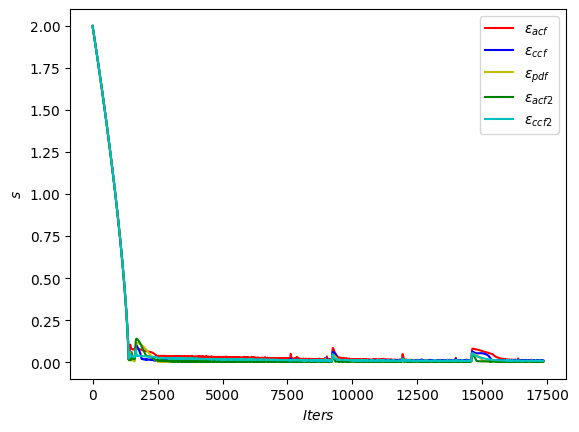

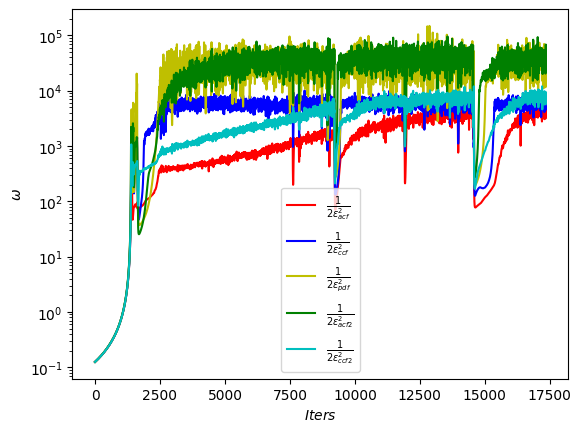

In [205]:
draw_adaptive_w(model14)
draw_epoch_w(model14)

In [181]:
### Defining SINN model
net15 = SINN(2, 10, 2, 2).to(device)
model15 = Model(net=net15)
model15.train()

[0]-th step loss: 0.5398, 0.5387, acf: 0.01121, ccf: 0.00100, pdf: 0.24969, pdf2: 0.27427, acf2: 0.00257
[50]-th step loss: 0.4195, 0.4078, acf: 0.00713, ccf: 0.00009, pdf: 0.21575, pdf2: 0.18340, acf2: 0.00141
[100]-th step loss: 0.0639, 0.0618, acf: 0.00912, ccf: 0.00549, pdf: 0.03216, pdf2: 0.01222, acf2: 0.00281
[150]-th step loss: 0.0220, 0.0216, acf: 0.00556, ccf: 0.00428, pdf: 0.00550, pdf2: 0.00485, acf2: 0.00141
[200]-th step loss: 0.0154, 0.0154, acf: 0.00431, ccf: 0.00404, pdf: 0.00268, pdf2: 0.00325, acf2: 0.00110
[250]-th step loss: 0.0122, 0.0118, acf: 0.00427, ccf: 0.00273, pdf: 0.00153, pdf2: 0.00216, acf2: 0.00107
[300]-th step loss: 0.0074, 0.0073, acf: 0.00295, ccf: 0.00126, pdf: 0.00086, pdf2: 0.00128, acf2: 0.00099
[350]-th step loss: 0.0037, 0.0038, acf: 0.00151, ccf: 0.00036, pdf: 0.00043, pdf2: 0.00077, acf2: 0.00074
[400]-th step loss: 0.0024, 0.0026, acf: 0.00127, ccf: 0.00015, pdf: 0.00022, pdf2: 0.00046, acf2: 0.00052
[450]-th step loss: 0.0019, 0.0020, acf:

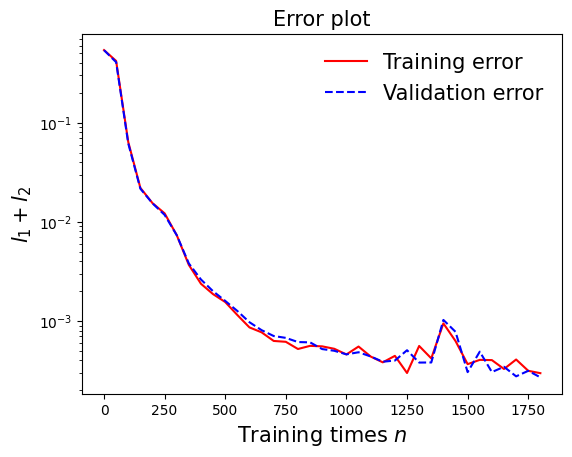

In [206]:
draw_loss(model15)

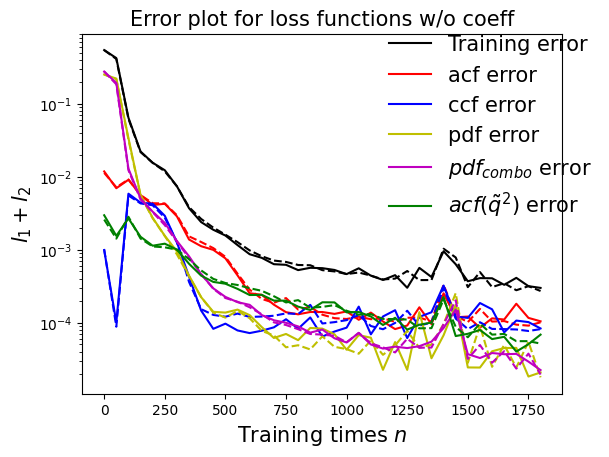

In [207]:
draw_errors(model15)


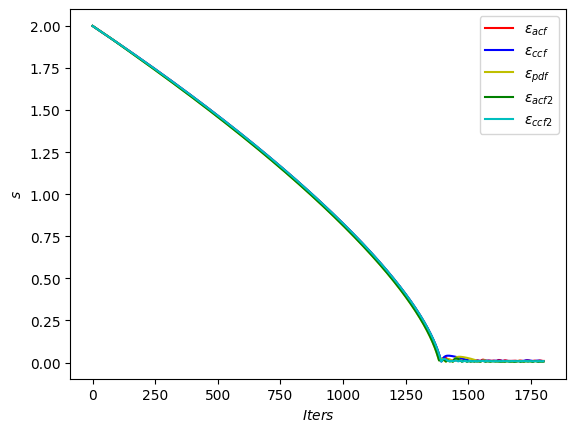

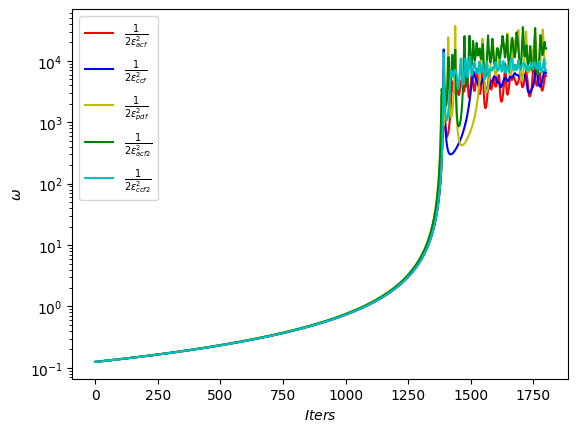

In [208]:
draw_adaptive_w(model15)
draw_epoch_w(model15)

In [183]:
### Defining SINN model
net16 = SINN(2, 10, 2, 2).to(device)
model16 = Model(net=net16)
model16.train()

[0]-th step loss: 0.5302, 0.5300, acf: 0.00952, ccf: 0.00042, pdf: 0.24661, pdf2: 0.27170, acf2: 0.00175
[50]-th step loss: 0.3418, 0.3304, acf: 0.00716, ccf: 0.00025, pdf: 0.18423, pdf2: 0.13735, acf2: 0.00140
[100]-th step loss: 0.0315, 0.0312, acf: 0.01402, ccf: 0.00011, pdf: 0.00909, pdf2: 0.00499, acf2: 0.00300
[150]-th step loss: 0.0147, 0.0144, acf: 0.00781, ccf: 0.00012, pdf: 0.00277, pdf2: 0.00232, acf2: 0.00140
[200]-th step loss: 0.0089, 0.0088, acf: 0.00503, ccf: 0.00019, pdf: 0.00102, pdf2: 0.00144, acf2: 0.00112
[250]-th step loss: 0.0063, 0.0062, acf: 0.00313, ccf: 0.00055, pdf: 0.00046, pdf2: 0.00107, acf2: 0.00098
[300]-th step loss: 0.0040, 0.0040, acf: 0.00111, ccf: 0.00111, pdf: 0.00030, pdf2: 0.00066, acf2: 0.00079
[350]-th step loss: 0.0024, 0.0025, acf: 0.00067, ccf: 0.00054, pdf: 0.00027, pdf2: 0.00042, acf2: 0.00058
[400]-th step loss: 0.0015, 0.0015, acf: 0.00035, ccf: 0.00024, pdf: 0.00024, pdf2: 0.00029, acf2: 0.00041
[450]-th step loss: 0.0011, 0.0011, acf:

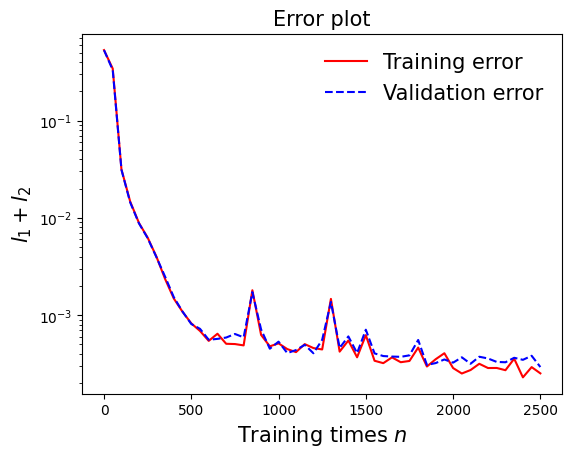

In [209]:
draw_loss(model16)


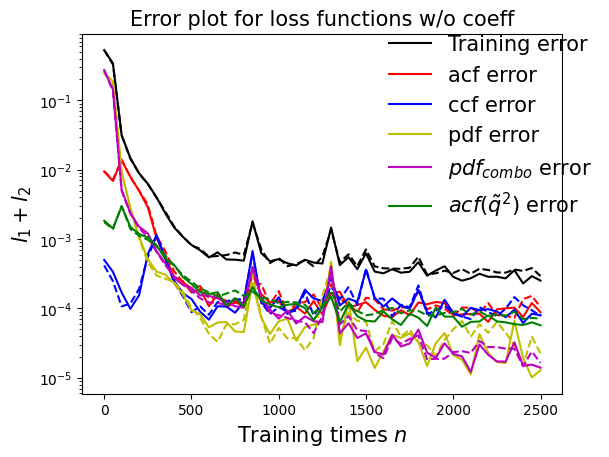

In [210]:
draw_errors(model16)

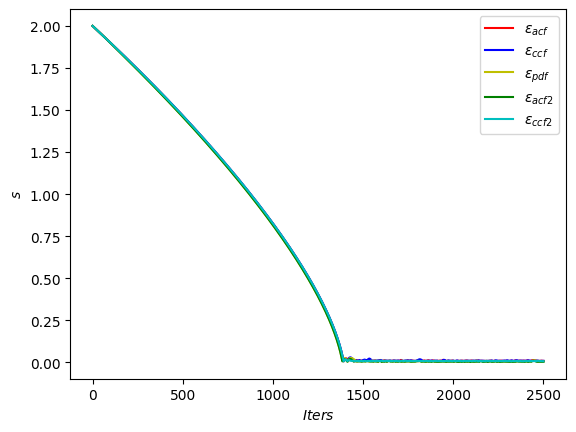

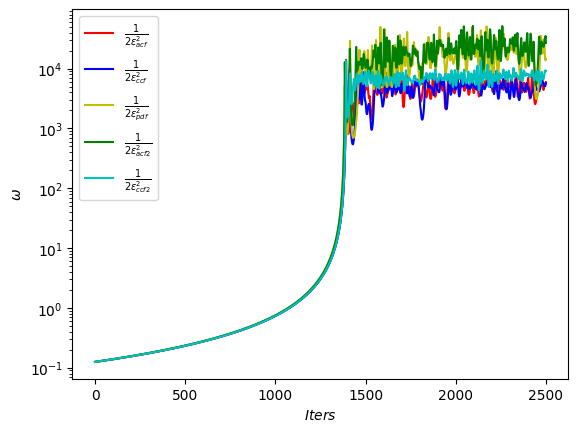

In [211]:
draw_adaptive_w(model16)
draw_epoch_w(model16)

In [185]:
### Defining SINN model
net17 = SINN(2, 10, 2, 2).to(device)
model17 = Model(net=net17)
model17.train()

[0]-th step loss: 0.5282, 0.5274, acf: 0.00942, ccf: 0.00479, pdf: 0.24594, pdf2: 0.26542, acf2: 0.00184
[50]-th step loss: 0.1819, 0.1734, acf: 0.01100, ccf: 0.01981, pdf: 0.06239, pdf2: 0.07750, acf2: 0.00270
[100]-th step loss: 0.0849, 0.0846, acf: 0.01048, ccf: 0.01976, pdf: 0.01511, pdf2: 0.03778, acf2: 0.00146
[150]-th step loss: 0.0616, 0.0614, acf: 0.00748, ccf: 0.01611, pdf: 0.00727, pdf2: 0.02929, acf2: 0.00125
[200]-th step loss: 0.0463, 0.0464, acf: 0.00568, ccf: 0.01334, pdf: 0.00341, pdf2: 0.02268, acf2: 0.00126
[250]-th step loss: 0.0359, 0.0357, acf: 0.00444, ccf: 0.01231, pdf: 0.00227, pdf2: 0.01539, acf2: 0.00133
[300]-th step loss: 0.0245, 0.0243, acf: 0.00311, ccf: 0.01240, pdf: 0.00157, pdf2: 0.00613, acf2: 0.00105
[350]-th step loss: 0.0186, 0.0186, acf: 0.00340, ccf: 0.01029, pdf: 0.00054, pdf2: 0.00323, acf2: 0.00120
[400]-th step loss: 0.0155, 0.0154, acf: 0.00359, ccf: 0.00837, pdf: 0.00045, pdf2: 0.00168, acf2: 0.00135
[450]-th step loss: 0.0116, 0.0116, acf:

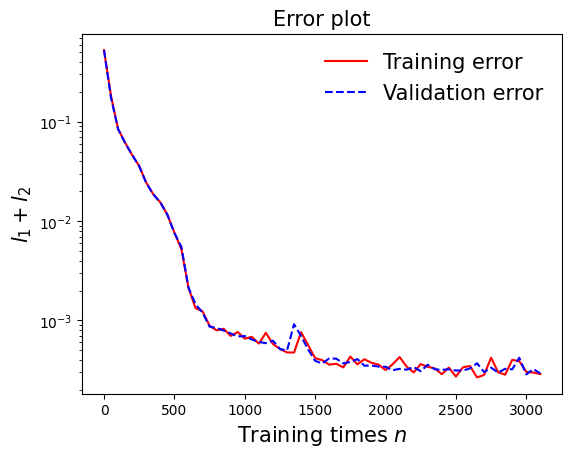

In [213]:
draw_loss(model17)

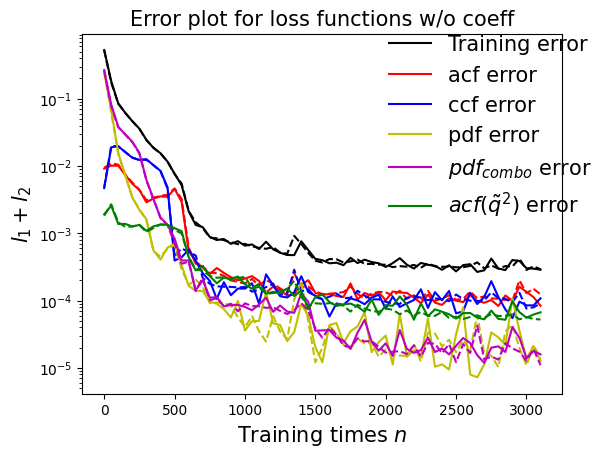

In [212]:
draw_errors(model17)

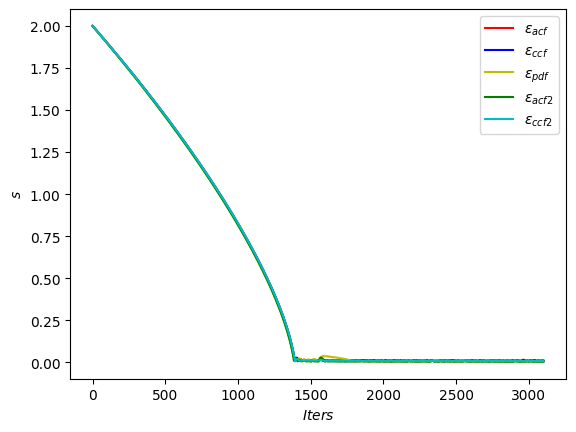

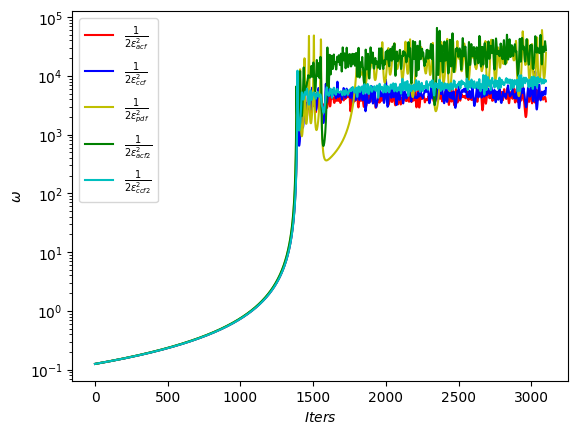

In [214]:
draw_adaptive_w(model17)
draw_epoch_w(model17)

In [187]:
### Defining SINN model
net18 = SINN(2, 10, 2, 2).to(device)
model18 = Model(net=net18)
model18.train()

[0]-th step loss: 0.5261, 0.5246, acf: 0.00913, ccf: 0.00341, pdf: 0.24571, pdf2: 0.26467, acf2: 0.00172
[50]-th step loss: 0.2240, 0.2141, acf: 0.00677, ccf: 0.00154, pdf: 0.12991, pdf2: 0.07433, acf2: 0.00150
[100]-th step loss: 0.0304, 0.0301, acf: 0.00394, ccf: 0.00703, pdf: 0.01165, pdf2: 0.00586, acf2: 0.00165
[150]-th step loss: 0.0173, 0.0175, acf: 0.00306, ccf: 0.00660, pdf: 0.00355, pdf2: 0.00305, acf2: 0.00124
[200]-th step loss: 0.0142, 0.0142, acf: 0.00368, ccf: 0.00495, pdf: 0.00205, pdf2: 0.00240, acf2: 0.00108
[250]-th step loss: 0.0115, 0.0116, acf: 0.00412, ccf: 0.00325, pdf: 0.00123, pdf2: 0.00185, acf2: 0.00110
[300]-th step loss: 0.0085, 0.0087, acf: 0.00393, ccf: 0.00160, pdf: 0.00067, pdf2: 0.00136, acf2: 0.00119
[350]-th step loss: 0.0054, 0.0056, acf: 0.00252, ccf: 0.00051, pdf: 0.00044, pdf2: 0.00095, acf2: 0.00115
[400]-th step loss: 0.0033, 0.0034, acf: 0.00113, ccf: 0.00033, pdf: 0.00033, pdf2: 0.00067, acf2: 0.00098
[450]-th step loss: 0.0019, 0.0020, acf:

[3850]-th step loss: 0.0109, 0.0109, acf: 0.00025, ccf: 0.01039, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00019
[3900]-th step loss: 0.0113, 0.0106, acf: 0.00025, ccf: 0.01009, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00022
[3950]-th step loss: 0.0112, 0.0108, acf: 0.00025, ccf: 0.01032, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00019
[4000]-th step loss: 0.0112, 0.0107, acf: 0.00023, ccf: 0.01030, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00019
[4050]-th step loss: 0.0117, 0.0111, acf: 0.00023, ccf: 0.01063, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00018
[4100]-th step loss: 0.0108, 0.0110, acf: 0.00023, ccf: 0.01052, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00018
[4150]-th step loss: 0.0119, 0.0111, acf: 0.00023, ccf: 0.01059, pdf: 0.00007, pdf2: 0.00004, acf2: 0.00018
[4200]-th step loss: 0.0111, 0.0104, acf: 0.00025, ccf: 0.00990, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00020
[4250]-th step loss: 0.0104, 0.0106, acf: 0.00023, ccf: 0.01012, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00020
[4300]-th step loss: 0.0116,

[7650]-th step loss: 0.0084, 0.0076, acf: 0.00020, ccf: 0.00726, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00011
[7700]-th step loss: 0.0068, 0.0076, acf: 0.00019, ccf: 0.00733, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00010
[7750]-th step loss: 0.0081, 0.0077, acf: 0.00019, ccf: 0.00744, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00009
[7800]-th step loss: 0.0076, 0.0077, acf: 0.00018, ccf: 0.00741, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00010
[7850]-th step loss: 0.0065, 0.0071, acf: 0.00018, ccf: 0.00677, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00010
[7900]-th step loss: 0.0064, 0.0064, acf: 0.00017, ccf: 0.00613, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00011
[7950]-th step loss: 0.0062, 0.0065, acf: 0.00018, ccf: 0.00623, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00010
[8000]-th step loss: 0.0058, 0.0066, acf: 0.00019, ccf: 0.00626, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00009
[8050]-th step loss: 0.0061, 0.0059, acf: 0.00018, ccf: 0.00554, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00011
[8100]-th step loss: 0.0059,

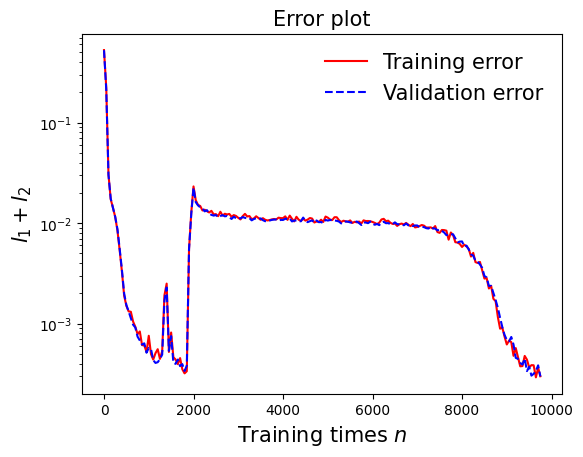

In [215]:
draw_loss(model18)

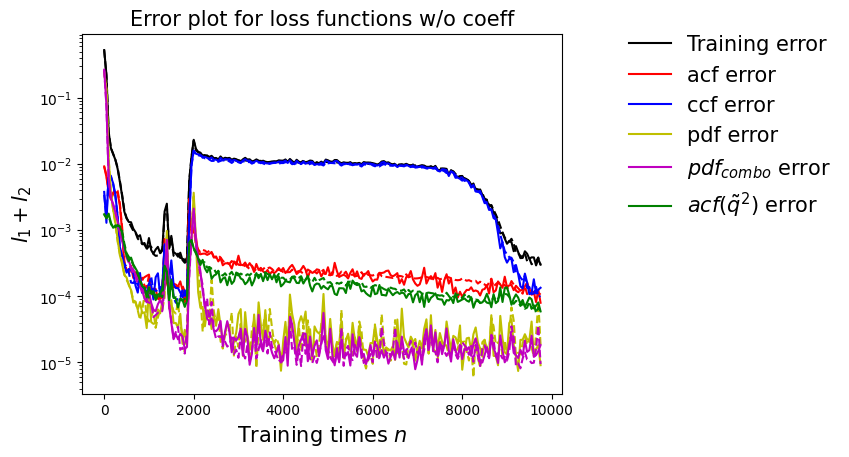

In [216]:
draw_errors(model18)

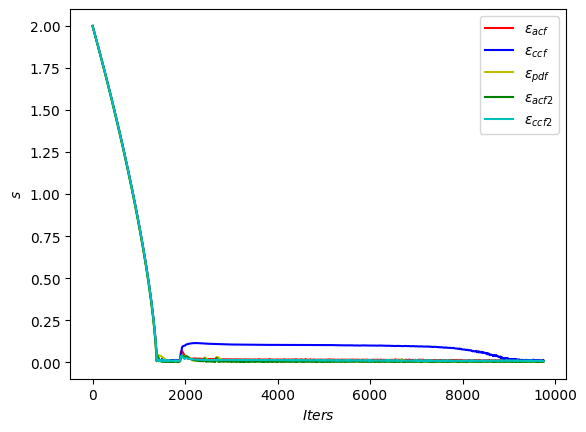

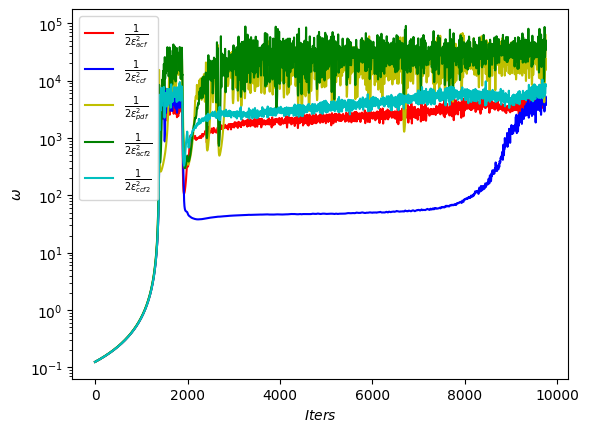

In [217]:
draw_adaptive_w(model18)
draw_epoch_w(model18)

In [189]:
### Defining SINN model
net19 = SINN(2, 10, 2, 2).to(device)
model19 = Model(net=net19)
model19.train()

[0]-th step loss: 0.5376, 0.5368, acf: 0.01096, ccf: 0.00373, pdf: 0.24801, pdf2: 0.27174, acf2: 0.00236
[50]-th step loss: 0.2400, 0.2307, acf: 0.00693, ccf: 0.01298, pdf: 0.13493, pdf2: 0.07354, acf2: 0.00232
[100]-th step loss: 0.0800, 0.0796, acf: 0.00917, ccf: 0.01786, pdf: 0.02859, pdf2: 0.02134, acf2: 0.00269
[150]-th step loss: 0.0576, 0.0577, acf: 0.00648, ccf: 0.01403, pdf: 0.01960, pdf2: 0.01629, acf2: 0.00132
[200]-th step loss: 0.0421, 0.0419, acf: 0.00399, ccf: 0.01280, pdf: 0.01213, pdf2: 0.01168, acf2: 0.00127
[250]-th step loss: 0.0243, 0.0242, acf: 0.00406, ccf: 0.01230, pdf: 0.00204, pdf2: 0.00439, acf2: 0.00143
[300]-th step loss: 0.0198, 0.0197, acf: 0.00496, ccf: 0.01060, pdf: 0.00058, pdf2: 0.00222, acf2: 0.00139
[350]-th step loss: 0.0170, 0.0171, acf: 0.00547, ccf: 0.00938, pdf: 0.00035, pdf2: 0.00091, acf2: 0.00103
[400]-th step loss: 0.0138, 0.0139, acf: 0.00425, ccf: 0.00798, pdf: 0.00032, pdf2: 0.00070, acf2: 0.00068
[450]-th step loss: 0.0089, 0.0171, acf:

[3850]-th step loss: 0.0021, 0.0023, acf: 0.00177, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00042
[3900]-th step loss: 0.0021, 0.0023, acf: 0.00174, ccf: 0.00009, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00043
[3950]-th step loss: 0.0023, 0.0023, acf: 0.00181, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00041
[4000]-th step loss: 0.0023, 0.0023, acf: 0.00179, ccf: 0.00009, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00040
[4050]-th step loss: 0.0022, 0.0024, acf: 0.00185, ccf: 0.00009, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00040
[4100]-th step loss: 0.0023, 0.0023, acf: 0.00179, ccf: 0.00009, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00040
[4150]-th step loss: 0.0021, 0.0023, acf: 0.00175, ccf: 0.00008, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00041
[4200]-th step loss: 0.0021, 0.0023, acf: 0.00183, ccf: 0.00008, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00039
[4250]-th step loss: 0.0022, 0.0023, acf: 0.00174, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00040
[4300]-th step loss: 0.0021,

[7650]-th step loss: 0.0020, 0.0020, acf: 0.00160, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00030
[7700]-th step loss: 0.0019, 0.0020, acf: 0.00156, ccf: 0.00008, pdf: 0.00004, pdf2: 0.00002, acf2: 0.00032
[7750]-th step loss: 0.0020, 0.0020, acf: 0.00161, ccf: 0.00008, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00030
[7800]-th step loss: 0.0020, 0.0020, acf: 0.00159, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00030
[7850]-th step loss: 0.0019, 0.0020, acf: 0.00159, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00031
[7900]-th step loss: 0.0018, 0.0020, acf: 0.00158, ccf: 0.00008, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00030
[7950]-th step loss: 0.0020, 0.0020, acf: 0.00158, ccf: 0.00007, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00030
[8000]-th step loss: 0.0018, 0.0020, acf: 0.00153, ccf: 0.00011, pdf: 0.00001, pdf2: 0.00002, acf2: 0.00031
[8050]-th step loss: 0.0019, 0.0020, acf: 0.00160, ccf: 0.00007, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00028
[8100]-th step loss: 0.0019,

[11450]-th step loss: 0.0015, 0.0017, acf: 0.00136, ccf: 0.00010, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00024
[11500]-th step loss: 0.0018, 0.0018, acf: 0.00142, ccf: 0.00008, pdf: 0.00004, pdf2: 0.00002, acf2: 0.00024
[11550]-th step loss: 0.0016, 0.0017, acf: 0.00137, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00024
[11600]-th step loss: 0.0018, 0.0017, acf: 0.00138, ccf: 0.00008, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00024
[11650]-th step loss: 0.0017, 0.0017, acf: 0.00140, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00023
[11700]-th step loss: 0.0016, 0.0017, acf: 0.00137, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00023
[11750]-th step loss: 0.0015, 0.0017, acf: 0.00132, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00024
[11800]-th step loss: 0.0016, 0.0017, acf: 0.00136, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00023
[11850]-th step loss: 0.0016, 0.0017, acf: 0.00138, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00023
[11900]-th step los

[15250]-th step loss: 0.0012, 0.0013, acf: 0.00106, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00018
[15300]-th step loss: 0.0012, 0.0013, acf: 0.00102, ccf: 0.00008, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00019
[15350]-th step loss: 0.0012, 0.0013, acf: 0.00104, ccf: 0.00006, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00018
[15400]-th step loss: 0.0014, 0.0013, acf: 0.00101, ccf: 0.00006, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00018
[15450]-th step loss: 0.0012, 0.0013, acf: 0.00105, ccf: 0.00006, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00018
[15500]-th step loss: 0.0012, 0.0013, acf: 0.00100, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00018
[15550]-th step loss: 0.0012, 0.0013, acf: 0.00103, ccf: 0.00006, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00017
[15600]-th step loss: 0.0012, 0.0013, acf: 0.00101, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00018
[15650]-th step loss: 0.0011, 0.0013, acf: 0.00101, ccf: 0.00006, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00017
[15700]-th step los

[19050]-th step loss: 0.0006, 0.0007, acf: 0.00050, ccf: 0.00006, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00010
[19100]-th step loss: 0.0007, 0.0007, acf: 0.00046, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00011
[19150]-th step loss: 0.0006, 0.0006, acf: 0.00046, ccf: 0.00006, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00010
[19200]-th step loss: 0.0006, 0.0007, acf: 0.00048, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00010
[19250]-th step loss: 0.0006, 0.0007, acf: 0.00047, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00010
[19300]-th step loss: 0.0006, 0.0006, acf: 0.00046, ccf: 0.00007, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00010
[19350]-th step loss: 0.0006, 0.0006, acf: 0.00041, ccf: 0.00006, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00011
[19400]-th step loss: 0.0006, 0.0006, acf: 0.00044, ccf: 0.00006, pdf: 0.00003, pdf2: 0.00001, acf2: 0.00009
[19450]-th step loss: 0.0005, 0.0006, acf: 0.00041, ccf: 0.00007, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00010
[19500]-th step los

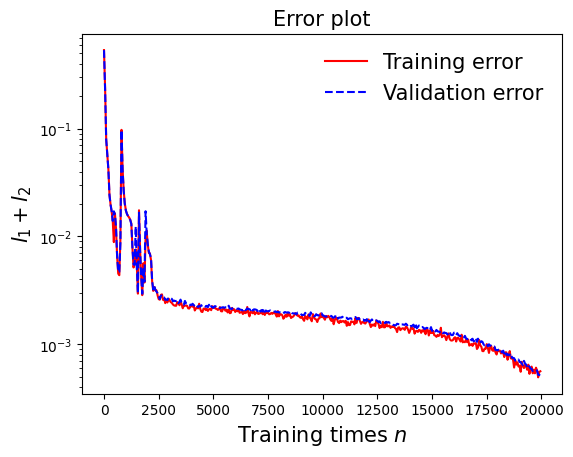

In [218]:
draw_loss(model19)

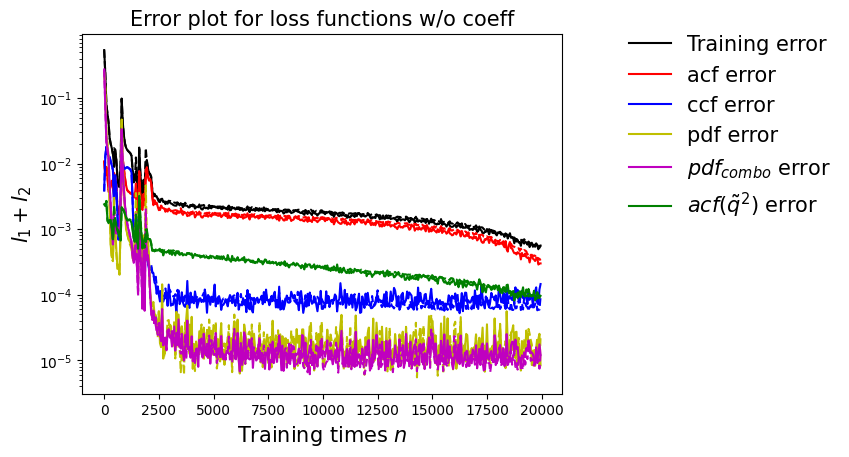

In [219]:
draw_errors(model19)

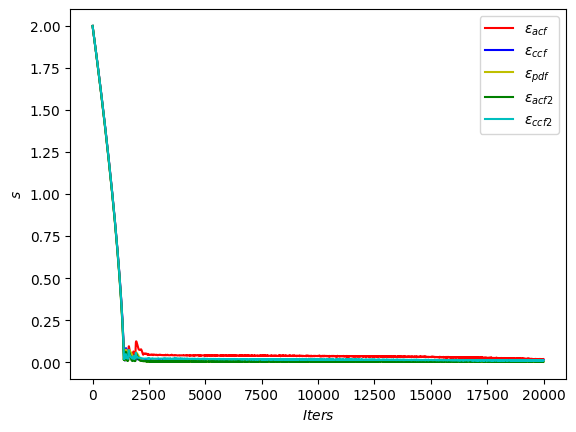

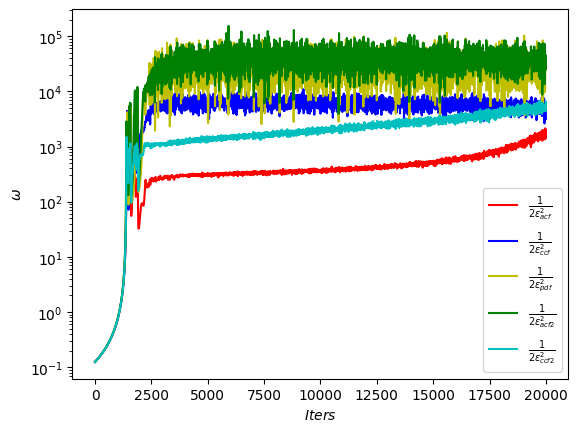

In [220]:
draw_adaptive_w(model19)
draw_epoch_w(model19)